#Dataset discription
Data has been collected from different hospitals, community clinics, maternal health cares from the rural areas of Bangladesh through the IoT based risk monitoring system.

Age: Any ages in years when a women during pregnant.

SystolicBP: Upper value of Blood Pressure in mmHg.

DiastolicBP: Lower value of Blood Pressure in mmHg,

BS: Blood glucose levels is in terms of a molar concentration, mmol/L.

BodyTemp: Women body temperature.

HeartRate: A normal resting heart rate in beats per minute.

Risk Level: Predicted Risk Intensity Level during pregnancy considering the previous attribute.

In [1]:
pip install dataprep

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.9/9.9 MB 16.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.5/18.5 MB 38.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.6/133.6 kB 4.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.1/12.1 MB 26.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 25.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 17.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 19.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 42.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 764.0/764.0 kB 9.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.4/6.4 MB 42.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.6/49.6 kB 5.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [184]:
pip install numpy pandas scikit-learn matplotlib

#Importing Packages

In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
from collections import Counter
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split as split, GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import AdaBoostClassifier
from  sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn import tree
from sklearn.model_selection import cross_val_score, KFold
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPClassifier
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import VotingClassifier
from dataprep.eda import plot
from sklearn.utils import resample


In [2]:
data = pd.read_csv('Maternal Health Risk Data Set.csv')
data.head()

,Age,SystolicBP,DiastolicBP,BS,BodyTemp,HeartRate,RiskLevel
0,25,130,80,15.0,98.0,86,high risk
1,35,140,90,13.0,98.0,70,high risk
2,29,90,70,8.0,100.0,80,high risk
3,30,140,85,7.0,98.0,70,high risk
4,35,120,60,6.1,98.0,76,low risk


In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1014 entries, 0 to 1013
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Age          1014 non-null   int64  
 1   SystolicBP   1014 non-null   int64  
 2   DiastolicBP  1014 non-null   int64  
 3   BS           1014 non-null   float64
 4   BodyTemp     1014 non-null   float64
 5   HeartRate    1014 non-null   int64  
 6   RiskLevel    1014 non-null   object 
dtypes: float64(2), int64(4), object(1)
memory usage: 55.6+ KB


In [5]:
data.shape

(1014, 7)

In [6]:
#Missing Values
data.isnull().sum()

Age            0
SystolicBP     0
DiastolicBP    0
BS             0
BodyTemp       0
HeartRate      0
RiskLevel      0
dtype: int64

In [7]:
# Summary statistics for numerical columns
summary_stats = data.describe()

# Convert summary statistics DataFrame to a formatted Markdown table
markdown_table = summary_stats.to_markdown()

print(markdown_table)

|       |       Age |   SystolicBP |   DiastolicBP |         BS |   BodyTemp |   HeartRate |
|:------|----------:|-------------:|--------------:|-----------:|-----------:|------------:|
| count | 1014      |    1014      |     1014      | 1014       | 1014       |   1014      |
| mean  |   29.8718 |     113.198  |       76.4606 |    8.72599 |   98.6651  |     74.3018 |
| std   |   13.4744 |      18.4039 |       13.8858 |    3.29353 |    1.37138 |      8.0887 |
| min   |   10      |      70      |       49      |    6       |   98       |      7      |
| 25%   |   19      |     100      |       65      |    6.9     |   98       |     70      |
| 50%   |   26      |     120      |       80      |    7.5     |   98       |     76      |
| 75%   |   39      |     120      |       90      |    8       |   98       |     80      |
| max   |   70      |     160      |      100      |   19       |  103       |     90      |


In [8]:
print(f"There are {data.duplicated().sum()} duplicates data")
data.loc[data.duplicated(keep=False)].sort_values(by=data.columns.to_list())

There are 562 duplicates data


,Age,SystolicBP,DiastolicBP,BS,BodyTemp,HeartRate,RiskLevel
670,10,100,50,6.0,99.0,70,mid risk
849,10,100,50,6.0,99.0,70,mid risk
552,12,90,60,7.5,102.0,60,low risk
940,12,90,60,7.5,102.0,60,low risk
543,12,90,60,7.5,102.0,66,low risk
...,...,...,...,...,...,...,...
553,60,120,85,15.0,98.0,60,mid risk
772,60,120,85,15.0,98.0,60,mid risk
818,60,120,85,15.0,98.0,60,mid risk
114,63,140,90,15.0,98.0,90,high risk


There are 562 duplicates in the dataset, which is a significant number. However, it's important to note that these duplicates may occur because patients share the same values for health factors. we will analyze the data to gain insights into its distribution and understand the patterns related to these duplicates.

In [9]:
data.shape

(1014, 7)

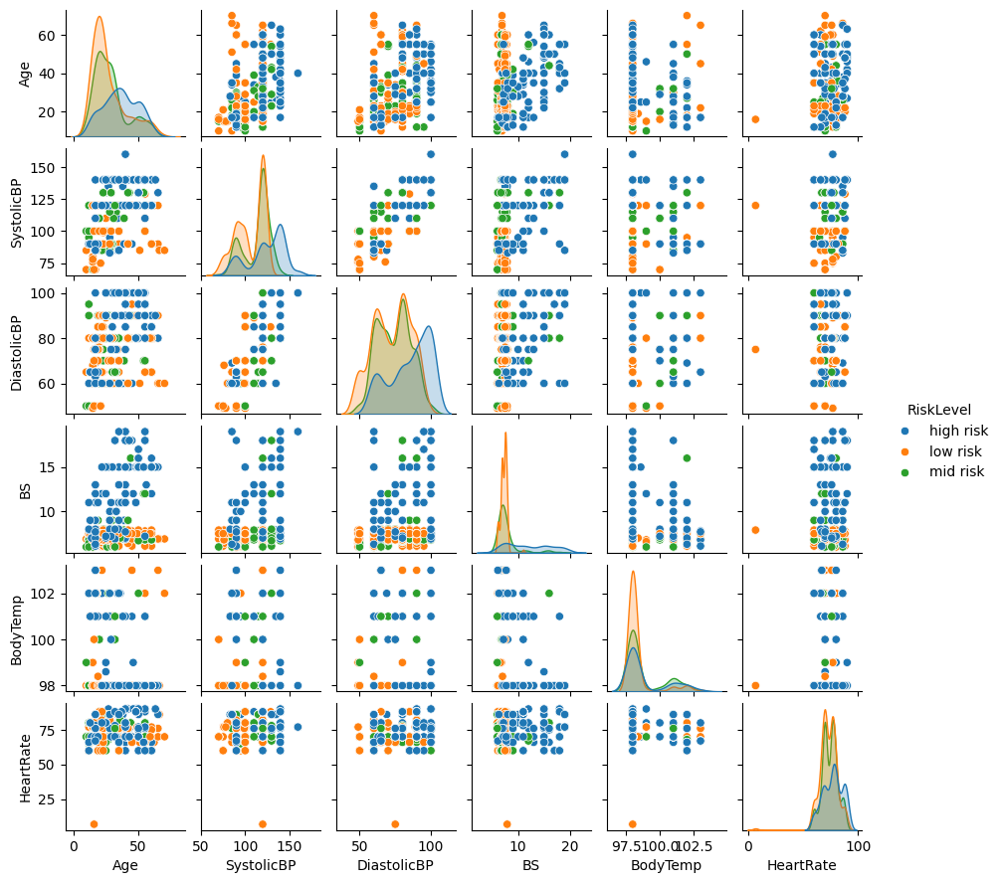

In [10]:
#Pairplot visualization with risklevel as hue
sns.pairplot(data,height=1.5 ,hue='RiskLevel')

#Univariate analysis
we examine the distribution of each variable in a dataset independently.

In [11]:
#checking categorical and numirical data
categorical_cols = data.select_dtypes(include=['object']).columns.tolist()
numerical_cols = data.select_dtypes(include=['number']).columns.tolist()

print("Categorical Attributes:")
print(categorical_cols)
print("\nNumerical Attributes:")
print(numerical_cols)

Categorical Attributes:
['RiskLevel']

Numerical Attributes:
['Age', 'SystolicBP', 'DiastolicBP', 'BS', 'BodyTemp', 'HeartRate']



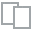
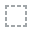
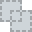
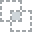
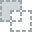
...
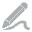
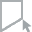
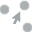
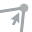
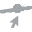

In [12]:
plot(data,'Age')


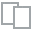
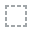
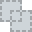
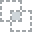
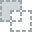
...
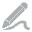
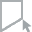
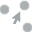
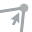
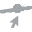

In [13]:
plot(data,'SystolicBP')


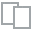
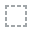
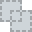
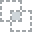
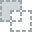
...
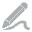
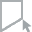
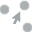
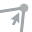
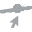

In [14]:
plot(data,'DiastolicBP')


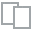
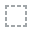
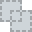
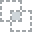
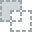
...
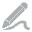
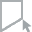
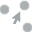
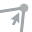
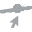

In [15]:
plot(data,'BS')


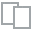
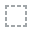
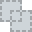
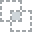
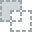
...
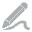
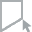
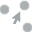
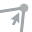
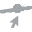

In [16]:
plot(data,'HeartRate')


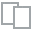
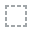
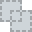
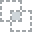
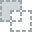
...
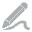
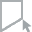
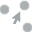
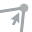
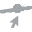

In [17]:
plot(data,'RiskLevel')

Looks like most pregnant women in this dataset mostly has low health risk. Out of 1014 observations, 406 of pregnant women has low risk, 336 has mid risk, and 272 has high risk

**Conclusion** :
It appears that most variables in the dataset have outliers, leading to skewed distributions. However, we ignore these outliers for now as they seem to be a natural occurrence, The only variable that has an outlier with an unreasonable value is HeartRate. In this variable, there are two observations that have a heart rate value of 7 bpm (beats per minute). A normal resting heart rate for adults ranges from 60 to 100 beats per minute, and the lowest recorded resting heart rate in human history was 25 bpm. Therefore, we will drop this 2 records that has a heart rate value of 7 because that value doesn't make any sense, and most likely is an input error.

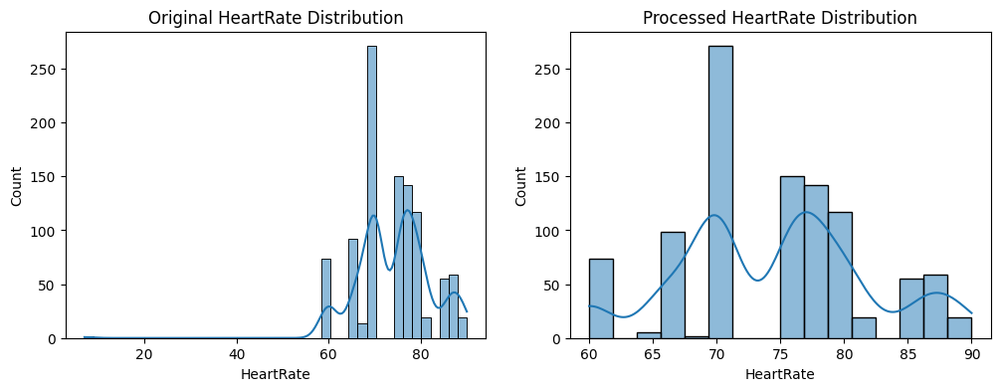

In [18]:
#Removing rows where HeartRate == 7
data_proc = data.drop(data.index[data.HeartRate == 7])
fig, ax = plt.subplots(1, 2, figsize=(12, 4))
sns.histplot(data=data, x="HeartRate", kde=True, ax=ax[0])
sns.histplot(data=data_proc, x="HeartRate", kde=True, ax=ax[1])
ax[0].set_title("Original HeartRate Distribution")
ax[1].set_title("Processed HeartRate Distribution")
plt.show()
data=data_proc

#Bivariate Analysis

<ipython-input-19-299d6555836e>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(data.corr(), annot=True, cmap="coolwarm")


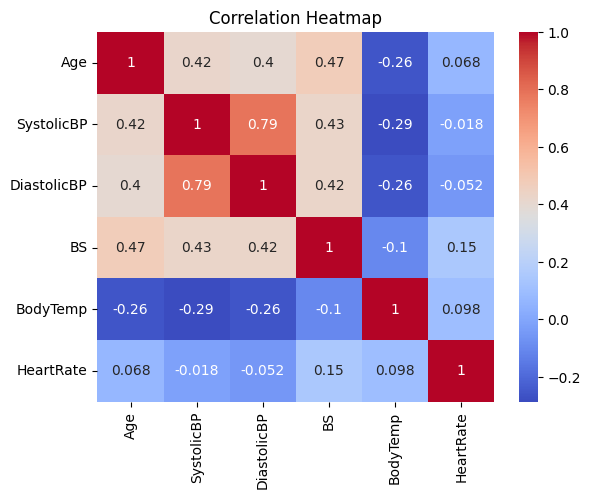

In [19]:
sns.heatmap(data.corr(), annot=True, cmap="coolwarm")
plt.title("Correlation Heatmap")
plt.show()

We observe a strong positive correlation (correlation coefficient = 0.79) between the SystolicBP and DiastolicBP variables. This suggests that these variables contain highly similar information, and there is minimal variance in the information they provide. Therefore, it is not problematic to remove one of these similar features due to their high correlation.

**Predictor and Target**






1.  Age → RiskLevel




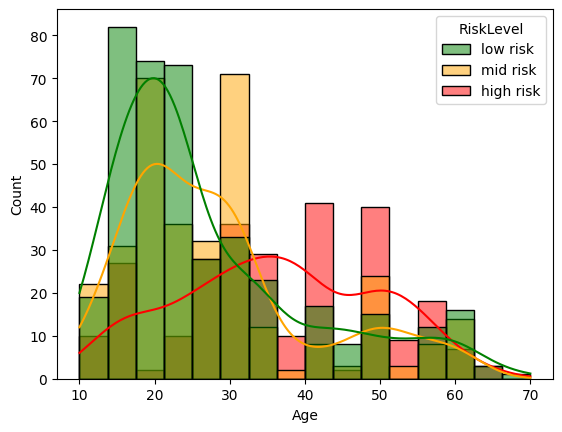

In [20]:
risk_order = ["low risk", "mid risk", "high risk"]
p_colors = ['green', 'orange', 'red']
sns.histplot(data=data, x="Age", hue="RiskLevel", kde=True, hue_order=risk_order, palette=p_colors)
plt.show()

Pregnant women aged below 25 years mostly has low health risk.
Health risks will start to increase after that age (starting from the age of 25 years).
 the health risk of pregnant women over 55 years old is decreased

2. SystolicBP → RiskLevel

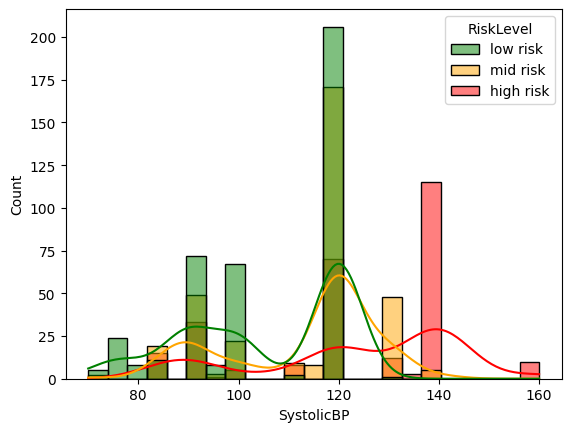

In [21]:
sns.histplot(data=data, x="SystolicBP", hue="RiskLevel", kde=True, hue_order=risk_order, palette=p_colors)
plt.show()

 Healthy adult typically has a systolic blood pressure within the range of 90 to 120 mm Hg

Observation:

1.Pregnant women with upper value of blood pressure >= 120 mmHg mostly has low health risk.

2.The higher pregnant women's blood pressure, the higher the health risk

3. DiastolicBP → RiskLevel

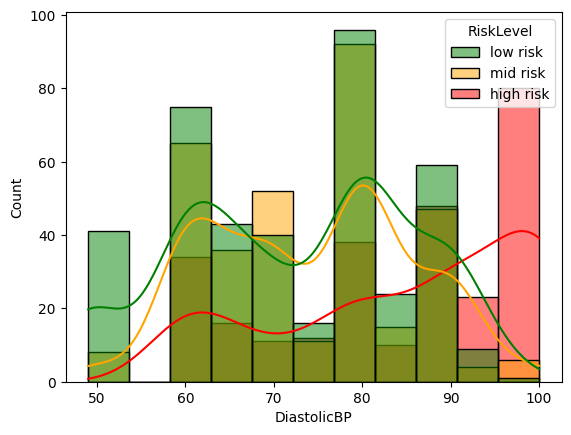

In [22]:
sns.histplot(data=data, x="DiastolicBP", hue="RiskLevel", kde=True, hue_order=risk_order, palette=p_colors)
plt.show()

The normal diastolic blood pressure (DBP) in a healthy adult is typically in the range of 60 to 80 mm Hg.

Observation:

1.pregnant women with distolic value of >=90 mm Hg has low risk while the blood pressure increases risk increases.

2.This variable has pretty similar pattern as SystolicBP. This is not surprising since they're highly correlated.

 4. BS → RiskLevel

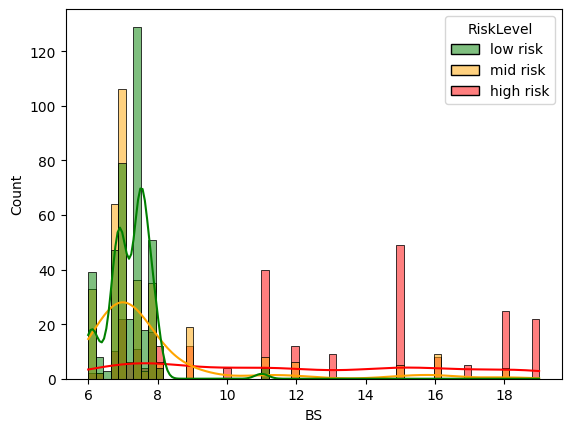

In [23]:
sns.histplot(data=data, x="BS", hue="RiskLevel", kde=True, hue_order=risk_order, palette=p_colors)
plt.show()

 A healthy human should have blood glucose level less than 6-7

Observation:

1.Almost every pregnant women with blood glucose level >= 8 has high health risk but otherwise, they seems to have lower health risk with blood glucose < 8

5. BodyTemp → RiskLevel

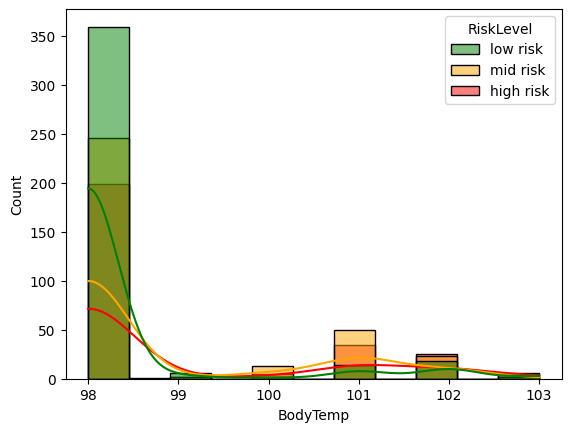

In [24]:
sns.histplot(data=data, x="BodyTemp", hue="RiskLevel", kde=True, hue_order=risk_order, palette=p_colors)
plt.show()

The normal body temperature in a healthy human typically falls within a range around 98.6 degrees Fahrenheit.

Observation:

 1.Most pregnant women seem to have a body temperature of 98 F, which is normal body temperature

 2.Pregnant women with body temperature >= 100 mostly has higher health risk

6. HeartRate → RiskLevel

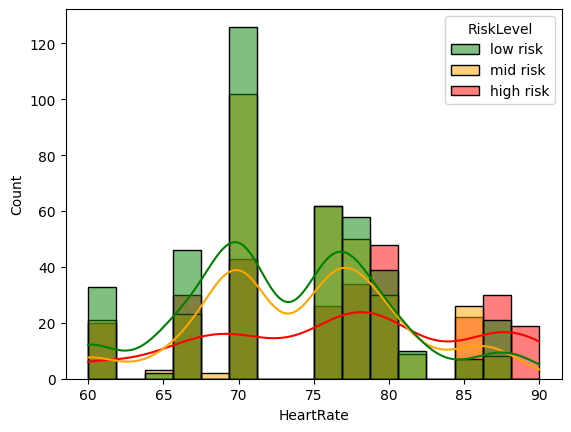

In [25]:
sns.histplot(data=data, x="HeartRate", hue="RiskLevel", kde=True, hue_order=risk_order, palette=p_colors)
plt.show()

 A normal resting heart rate for adults ranges from 60 to 100 beats per minute.

Observation:

Health risks increases with heart rate >90 bpm has high risk.

After conducting several analyzes of the predictor variables, we conclude that the HeartRate variable is less helpful in determining the health risks of pregnant women. So, it's safe to remove that variable.

In [26]:
data = data.drop(["HeartRate"], axis=1)

#Model Building

**Target encoding**

In [27]:
#mapping the target attribute
RiskLevel = {'low risk':1,
        'mid risk':2,
        'high risk':3}

# apply using map
data['RiskLevel'] = data['RiskLevel'].map(RiskLevel).astype(float)
data

,Age,SystolicBP,DiastolicBP,BS,BodyTemp,RiskLevel
0,25,130,80,15.0,98.0,3.0
1,35,140,90,13.0,98.0,3.0
2,29,90,70,8.0,100.0,3.0
3,30,140,85,7.0,98.0,3.0
4,35,120,60,6.1,98.0,1.0
...,...,...,...,...,...,...
1009,22,120,60,15.0,98.0,3.0
1010,55,120,90,18.0,98.0,3.0
1011,35,85,60,19.0,98.0,3.0
1012,43,120,90,18.0,98.0,3.0


# Expirment 01: keep duplicates and apply Sampling methods



1.   Undersampling without noisy data




In [28]:

# Count the number of samples in each class
class_counts = data['RiskLevel'].value_counts()

# Determine the smallest class size
min_class_size = class_counts.min()

# downsample the smaller classes to match the size of the smallest class
df_resampled_min_no_noise = pd.concat([
    resample(data[data['RiskLevel'] == level],  # Select samples from the class
             n_samples=min_class_size,       # Sample size to match the smallest class
             replace=True,                   # Sample with replacement
             random_state=42)                # Set random state for reproducibility
    for level in class_counts.index         # Loop over class levels
])

# Check the distribution of classes in the resampled dataset
print(df_resampled_min_no_noise ['RiskLevel'].value_counts())

1.0    272
2.0    272
3.0    272
Name: RiskLevel, dtype: int64


In [29]:
# Stratified Dataset Splitting
X_min = df_resampled_min_no_noise.drop('RiskLevel',axis=1)
y_min = df_resampled_min_no_noise['RiskLevel']

X_train_min,X_test_min,y_train_min,y_test_min=train_test_split(X_min,y_min,test_size=0.2,
                                               random_state=42, shuffle= True , stratify=y_min  )


2.   Oversampling without noisy data



In [30]:
# Count the number of samples in each class
class_counts = data['RiskLevel'].value_counts()

# Determine the largest class size
max_class_size = class_counts.max()

# downsample the larger classes to match the size of the largest class
df_resampled_max_no_noise = pd.concat([
    resample(data[data['RiskLevel'] == level],  # Select samples from the class
             n_samples=max_class_size,       # Sample size to match the largest class
             replace=True,                   # Sample with replacement
             random_state=42)                # Set random state for reproducibility
    for level in class_counts.index         # Loop over class levels
])

# Check the distribution of classes in the resampled dataset
print(df_resampled_max_no_noise['RiskLevel'].value_counts())


1.0    404
2.0    404
3.0    404
Name: RiskLevel, dtype: int64


In [31]:
# Stratified Dataset Splitting
X_max = df_resampled_max_no_noise .drop('RiskLevel',axis=1)
y_max = df_resampled_max_no_noise ['RiskLevel']

X_train_max,X_test_max,y_train_max,y_test_max=train_test_split(X_max,y_max,test_size=0.2,
                                               random_state=42, shuffle= True , stratify=y_max  )

In [32]:
import statsmodels.api as sm
# Function for forward selection
def forward_selection(X, y):
    selected_features = []  # Initialize an empty set for selected features

    while True:
        remaining_features = [feature for feature in X.columns if feature not in selected_features]
        pvalues = []

        for feature in remaining_features:
            model = sm.OLS(y, sm.add_constant(X[selected_features + [feature]])).fit()
            pvalues.append((feature, model.pvalues[feature]))

        # Find the feature with the lowest p-value
        best_feature, best_pvalue = min(pvalues, key=lambda x: x[1])

        if best_pvalue < 0.05:
            selected_features.append(best_feature)
        else:
            break

    return selected_features


In [33]:

# Apply forward selection
selected_features_forward_selection_max = forward_selection(X_max, y_max)

# Display the selected features after forward selection
print("Features selected after forward selection for oversampling:")
print(selected_features_forward_selection_max)

Features selected after forward selection for oversampling:
['BS', 'BodyTemp', 'SystolicBP']


In [34]:

# Apply forward selection
selected_features_forward_selection_min = forward_selection(X_min, y_min)

# Display the selected features after forward selection
print("Features selected after forward selection for undersampling:")
print(selected_features_forward_selection_min)

Features selected after forward selection for undersampling:
['BS', 'BodyTemp', 'SystolicBP']


In [35]:
#Stratified Dataset Splitting
X_selected_min= df_resampled_min_no_noise[selected_features_forward_selection_min]

X_train_selected_min,X_test_selected_min ,y_train_min,y_test_min=train_test_split(X_selected_min,y_min,test_size=0.2,
                                               random_state=42, shuffle= True , stratify=y_min  )

In [36]:
#Stratified Dataset Splitting
X_selected_max= df_resampled_max_no_noise[selected_features_forward_selection_max]

X_train_selected_max,X_test_selected_max ,y_train_max,y_test_max=train_test_split(X_selected_max,y_max,test_size=0.2,
                                               random_state=42, shuffle= True , stratify=y_max  )

In [37]:
y_train_array_min = np.array(y_train_min)

# Count the occurrences of each class in y_test
class_distribution_min = Counter(y_train_array_min)

print("Class Distribution in y_train for undersampling:")
for class_label, count in class_distribution_min.items():
    print(f"Class {class_label}: {count} samples")


Class Distribution in y_train for undersampling:
Class 2.0: 217 samples
Class 3.0: 217 samples
Class 1.0: 218 samples


In [38]:
y_test_array_min = np.array(y_test_min)

# Count the occurrences of each class in y_test
class_distribution_min1 = Counter(y_test_array_min)

print("Class Distribution in y_test for undersampling:")
for class_label, count in class_distribution_min1.items():
    print(f"Class {class_label}: {count} samples")

Class Distribution in y_test for undersampling:
Class 3.0: 55 samples
Class 2.0: 55 samples
Class 1.0: 54 samples


In [39]:
print(f'Training Shape x:',X_train_min.shape)
print(f'Testing Shape x:',X_test_min.shape)
print('*****___________*****___________*****')
print(f'Training Shape y',y_train_min.shape)
print(f'Testing Shape y:',y_test_min.shape)

Training Shape x: (652, 5)
Testing Shape x: (164, 5)
*****___________*****___________*****
Training Shape y (652,)
Testing Shape y: (164,)


In [40]:
y_train_array_max = np.array(y_train_max)

# Count the occurrences of each class in y_test
class_distribution_max = Counter(y_train_array_max)

print("Class Distribution in y_train for oversampling:")
for class_label, count in class_distribution_max.items():
    print(f"Class {class_label}: {count} samples")

Class Distribution in y_train for oversampling:
Class 2.0: 323 samples
Class 1.0: 323 samples
Class 3.0: 323 samples


In [41]:
y_test_array_max = np.array(y_test_max)

# Count the occurrences of each class in y_test
class_distribution_max1 = Counter(y_test_array_max)

print("Class Distribution in y_test for oversampling:")
for class_label, count in class_distribution_max1.items():
    print(f"Class {class_label}: {count} samples")

Class Distribution in y_test for oversampling:
Class 1.0: 81 samples
Class 3.0: 81 samples
Class 2.0: 81 samples


In [42]:
print(f'Training Shape x:',X_train_max.shape)
print(f'Testing Shape x:',X_test_max.shape)
print('*****___________*****___________*****')
print(f'Training Shape y',y_train_max.shape)
print(f'Testing Shape y:',y_test_max.shape)

Training Shape x: (969, 5)
Testing Shape x: (243, 5)
*****___________*****___________*****
Training Shape y (969,)
Testing Shape y: (243,)


**Building Clssification Model**

1. **NAIVE BAYES**

In [43]:
# Create a GaussianNB classifier
nb_no_noise = GaussianNB(var_smoothing=0.01)
print("method 1 data without noise and oversamling")
# Fit the naive bayes classifier to your training data
nb_no_noise.fit(X_train_max , y_train_max)

# Make predictions on the test data
y_pred_max = nb_no_noise.predict(X_test_max)

# Calculate and print the accuracy for the training data
train_accuracy = accuracy_score(y_train_max, nb_no_noise.predict(X_train_max))
print(f"Training Accuracy : {train_accuracy:.2f}")

# Calculate and print the accuracy for the test data
test_accuracy_nb_max = accuracy_score(y_test_max, y_pred_max)
print(f"Testing Accuracy: {test_accuracy_nb_max:.2f}")

# Generate and print a classification report
report = classification_report(y_test_max, y_pred_max)
print("Classification Report:")
lines = report.split('\n')
for line in lines:
    print(line)



print("method 2 data without noise and undersampling")
# Fit the naive bayes classifier to your training data
nb_no_noise.fit(X_train_min , y_train_min)

# Make predictions on the test data
y_pred_min = nb_no_noise.predict(X_test_min)

# Calculate and print the accuracy for the training data
train_accuracy = accuracy_score(y_train_min, nb_no_noise.predict(X_train_min))
print(f"Training Accuracy: {train_accuracy:.2f}")

# Calculate and print the accuracy for the test data
test_accuracy_nb_min = accuracy_score(y_test_min, y_pred_min)
print(f"Testing Accuracy: {test_accuracy_nb_min:.2f}")

# Generate and print a classification report
report = classification_report(y_test_min, y_pred_min)
print("Classification Report:")
lines = report.split('\n')
for line in lines:
    print(line)

method 1 data without noise and oversamling
Training Accuracy : 0.60
Testing Accuracy: 0.61
Classification Report:
              precision    recall  f1-score   support

         1.0       0.60      0.62      0.61        81
         2.0       0.46      0.46      0.46        81
         3.0       0.77      0.75      0.76        81

    accuracy                           0.61       243
   macro avg       0.61      0.61      0.61       243
weighted avg       0.61      0.61      0.61       243

method 2 data without noise and undersampling
Training Accuracy: 0.57
Testing Accuracy: 0.66
Classification Report:
              precision    recall  f1-score   support

         1.0       0.62      0.72      0.67        54
         2.0       0.57      0.51      0.54        55
         3.0       0.79      0.75      0.77        55

    accuracy                           0.66       164
   macro avg       0.66      0.66      0.66       164
weighted avg       0.66      0.66      0.66       164



**Adaboost Naive Bayes**

In [44]:
from sklearn import tree

# Initialize the base Decision Tree Classifier
base_classifier = GaussianNB(var_smoothing=0.01)
print("adaboost without noisy data and oversampling")
# Initialize the AdaBoost Classifier
adaboost_classifier_no_noise = AdaBoostClassifier()

# Train the AdaBoost classifier
adaboost_classifier_no_noise.fit(X_train_max, y_train_max)

# Make predictions on the test data
y_pred_adaboost_max = adaboost_classifier_no_noise.predict(X_test_max)

# Evaluate the AdaBoost model's accuracy
accuracy_adaboost_max = accuracy_score(y_test_max, y_pred_adaboost_max)
print("AdaBoost Test Accuracy :", accuracy_adaboost_max)
train_accuracy = accuracy_score(y_train_max, adaboost_classifier_no_noise.predict(X_train_max)) * 100
print(f"Training Accuracy: {train_accuracy:.2f}")

print("adaboost without noisy data and undersampling")

# Train the AdaBoost classifier
adaboost_classifier_no_noise.fit(X_train_min, y_train_min)

# Make predictions on the test data
y_pred_adaboost_min = adaboost_classifier_no_noise.predict(X_test_min)

# Evaluate the AdaBoost model's accuracy
accuracy_adaboost_min = accuracy_score(y_test_min, y_pred_adaboost_min)
print("AdaBoost Test Accuracy :", accuracy_adaboost_min)
train_accuracy = accuracy_score(y_train_min, adaboost_classifier_no_noise.predict(X_train_min)) * 100
print(f"Training Accuracy: {train_accuracy:.2f}")

adaboost without noisy data and oversampling
AdaBoost Test Accuracy : 0.6255144032921811
Training Accuracy: 72.34
adaboost without noisy data and undersampling
AdaBoost Test Accuracy : 0.6402439024390244
Training Accuracy: 65.64


**confusion matrix**

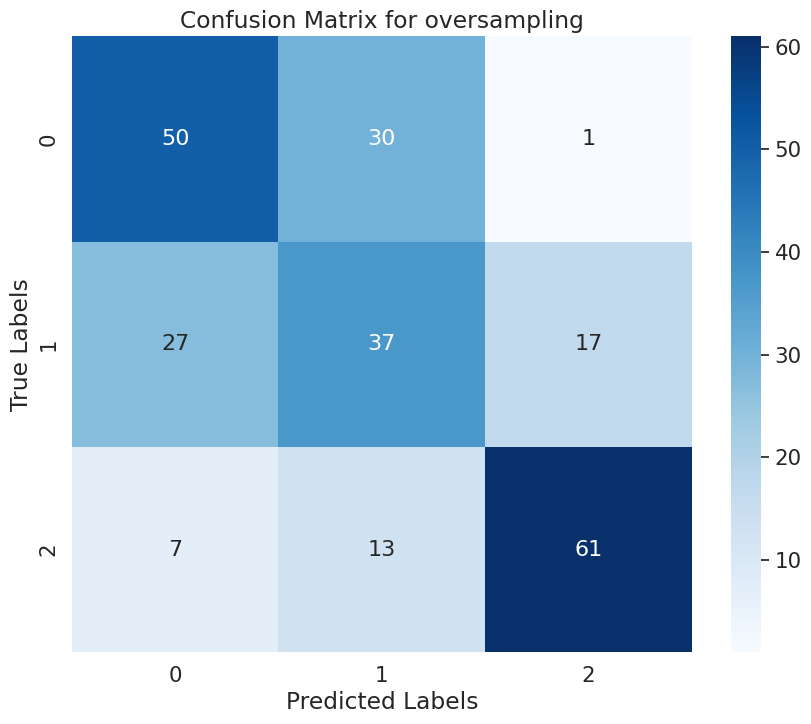

In [45]:
cm = confusion_matrix(y_test_max, y_pred_max)

# Plotting the confusion matrix
plt.figure(figsize=(10, 8))
sns.set(font_scale=1.4)  # Adjust the font scale if needed
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", annot_kws={"size": 16})

plt.title("Confusion Matrix for oversampling")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()

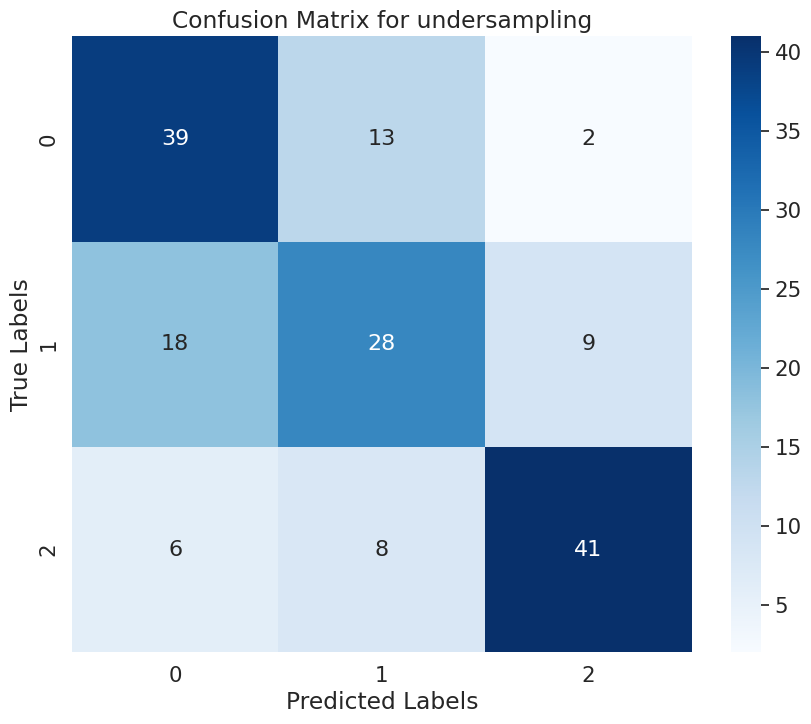

In [46]:
cm = confusion_matrix(y_test_min, y_pred_min)

# Plotting the confusion matrix
plt.figure(figsize=(10, 8))
sns.set(font_scale=1.4)  # Adjust the font scale if needed
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", annot_kws={"size": 16})

plt.title("Confusion Matrix for undersampling")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()

**Hyperparameter tuning Naive Bayes**

In [47]:
import numpy as np
from sklearn.model_selection import GridSearchCV
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score

# Define the parameter grid for hyperparameter tuning
param_grid = {
    'var_smoothing': np.logspace(0,-9, num=100)  # Varying values for var_smoothing
}

# Initialize Gaussian Naive Bayes classifier
nb_classifier = GaussianNB()

# Initialize GridSearchCV with the classifier and parameter grid
grid_search = GridSearchCV(estimator=nb_classifier, param_grid=param_grid, cv=5, verbose=1, n_jobs=-1)

# Fit the GridSearchCV to the training data (noisy data with oversampling)
grid_search.fit(X_train_max, y_train_max)

# Get the best hyperparameters from the grid search
best_params_max = grid_search.best_params_
print("Best Hyperparameters for data with oversampling:", best_params_max)

# Use the best hyperparameters to train the final Gaussian Naive Bayes model
best_nb_classifier = GaussianNB(**best_params_max)
best_nb_classifier.fit(X_train_max, y_train_max)

# Make predictions on the training set to evaluate training accuracy
y_train_pred_max = best_nb_classifier.predict(X_train_max)
train_accuracy_max = accuracy_score(y_train_max, y_train_pred_max)
print("Training Accuracy (data with oversampling):", train_accuracy_max)

# Make predictions on the test set using the best model
y_test_pred_max = best_nb_classifier.predict(X_test_max)
test_accuracy_max = accuracy_score(y_test_max, y_test_pred_max)
print("Test Accuracy (data with oversampling):", test_accuracy_max)

# Fit the GridSearchCV to the training data (noisy data with undersampling)
grid_search.fit(X_train_min, y_train_min)

# Get the best hyperparameters from the grid search
best_params_min = grid_search.best_params_
print("Best Hyperparameters for data with undersampling:", best_params_min)

# Use the best hyperparameters to train the final Gaussian Naive Bayes model
best_nb_classifier = GaussianNB(**best_params_min)
best_nb_classifier.fit(X_train_min, y_train_min)

# Make predictions on the training set to evaluate training accuracy
y_train_pred_min = best_nb_classifier.predict(X_train_min)
train_accuracy_min = accuracy_score(y_train_min, y_train_pred_min)
print("Training Accuracy ( data with undersampling):", train_accuracy_min)

# Make predictions on the test set using the best model
y_test_pred_min = best_nb_classifier.predict(X_test_min)
test_accuracy_min = accuracy_score(y_test_min, y_test_pred_min)
print("Test Accuracy (data with undersampling):", test_accuracy_min)


Fitting 5 folds for each of 100 candidates, totalling 500 fits
Best Hyperparameters for data with oversampling: {'var_smoothing': 0.008111308307896872}
Training Accuracy (data with oversampling): 0.6130030959752322
Test Accuracy (data with oversampling): 0.6172839506172839
Fitting 5 folds for each of 100 candidates, totalling 500 fits
Best Hyperparameters for data with undersampling: {'var_smoothing': 0.001873817422860383}
Training Accuracy ( data with undersampling): 0.5858895705521472
Test Accuracy (data with undersampling): 0.6585365853658537


In [48]:
# Loop through the dataframes in the dictionary
print("the accuracy for each attribute using the noisy data with undersampling ")
for name, df in data.items():


    # Create and train the model
    model = GaussianNB(var_smoothing=0.01)
    model.fit(X_train_min, y_train_min)

    # Make predictions on the test set
    y_pred = model.predict(X_test_min)

    # Calculate and print the accuracy
    accuracy = accuracy_score(y_test_min, y_pred)
    print(f"Accuracy for {name}: {accuracy}")

the accuracy for each attribute using the noisy data with undersampling 
Accuracy for Age: 0.6585365853658537
Accuracy for SystolicBP: 0.6585365853658537
Accuracy for DiastolicBP: 0.6585365853658537
Accuracy for BS: 0.6585365853658537
Accuracy for BodyTemp: 0.6585365853658537
Accuracy for RiskLevel: 0.6585365853658537


In [49]:
# Loop through the dataframes in the dictionary
print("the accuracy for each attribute using data with oversampling ")
for name, df in data.items():


    # Create and train the model
    model = GaussianNB(var_smoothing=0.01)
    model.fit(X_train_max, y_train_max)

    # Make predictions on the test set
    y_pred = model.predict(X_test_max)

    # Calculate and print the accuracy
    accuracy = accuracy_score(y_test_max, y_pred)
    print(f"Accuracy for {name}: {accuracy}")

the accuracy for each attribute using data with oversampling 
Accuracy for Age: 0.6090534979423868
Accuracy for SystolicBP: 0.6090534979423868
Accuracy for DiastolicBP: 0.6090534979423868
Accuracy for BS: 0.6090534979423868
Accuracy for BodyTemp: 0.6090534979423868
Accuracy for RiskLevel: 0.6090534979423868


2. **Decision Tree**

In [50]:
#Create tree object
decision_tree_no_noise = tree.DecisionTreeClassifier(criterion='gini', max_depth=8, random_state=42)


# Fit the decision tree  classifier to  training data
decision_tree_no_noise.fit(X_train_selected_max , y_train_max)

# Make predictions on the test data
y_pred_max = decision_tree_no_noise.predict(X_test_selected_max)
print("method 1 data without noise and oversamling")
# Calculate and print the accuracy for the training data
train_accuracy = accuracy_score(y_train_max, decision_tree_no_noise.predict(X_train_selected_max))
print(f"Training Accuracy: {train_accuracy:.2f}")

# Calculate and print the accuracy for the test data
test_accuracy_Dt_max = accuracy_score(y_test_max, y_pred_max)
print(f"Testing Accuracy: {test_accuracy_Dt_max:.2f}")

# Generate and print a classification report
report = classification_report(y_test_max, y_pred_max)
print("Classification Report:")
lines = report.split('\n')
for line in lines:
    print(line)
print("method 2 data without noise and undersampling")


# Fit the decision tree  classifier to  training data
decision_tree_no_noise.fit(X_train_selected_min , y_train_min)

# Make predictions on the test data
y_pred_min = decision_tree_no_noise.predict(X_test_selected_min)
print("method 1 data without noise and oversamling")
# Calculate and print the accuracy for the training data
train_accuracy = accuracy_score(y_train_min, decision_tree_no_noise.predict(X_train_selected_min))
print(f"Training Accuracy: {train_accuracy:.2f}")

# Calculate and print the accuracy for the test data
test_accuracy_Dt_min = accuracy_score(y_test_min, y_pred_min)
print(f"Testing Accuracy: {test_accuracy_Dt_min:.2f}")

# Generate and print a classification report
report = classification_report(y_test_min, y_pred_min)
print("Classification Report:")
lines = report.split('\n')
for line in lines:
    print(line)

method 1 data without noise and oversamling
Training Accuracy: 0.81
Testing Accuracy: 0.73
Classification Report:
              precision    recall  f1-score   support

         1.0       0.72      0.69      0.70        81
         2.0       0.64      0.59      0.62        81
         3.0       0.82      0.91      0.87        81

    accuracy                           0.73       243
   macro avg       0.73      0.73      0.73       243
weighted avg       0.73      0.73      0.73       243

method 2 data without noise and undersampling
method 1 data without noise and oversamling
Training Accuracy: 0.82
Testing Accuracy: 0.72
Classification Report:
              precision    recall  f1-score   support

         1.0       0.70      0.69      0.69        54
         2.0       0.67      0.58      0.62        55
         3.0       0.78      0.89      0.83        55

    accuracy                           0.72       164
   macro avg       0.71      0.72      0.71       164
weighted avg       

**Hyperparameter tuning decision tree**

In [51]:
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score

# Initialize the Decision Tree Classifier
dt_classifier = DecisionTreeClassifier(random_state=42)

# Define the hyperparameters grid for tuning
param_grid = {
    'criterion': ['gini', 'entropy'],
    'max_depth': [5, 10, 15],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Initialize Grid Search Cross-Validation
grid_search_dt = GridSearchCV(estimator=dt_classifier, param_grid=param_grid, cv=5, scoring='accuracy')

# Perform Grid Search CV to find the best hyperparameters for noisy data with oversampling
grid_search_dt.fit(X_train_selected_max, y_train_max)

# Get the best hyperparameters and model
best_dt_classifier_max = grid_search_dt.best_estimator_

# Make predictions on the training data to evaluate training accuracy
y_train_pred_dt_max = best_dt_classifier_max.predict(X_train_selected_max)
train_accuracy_dt_max = accuracy_score(y_train_max, y_train_pred_dt_max)
print("Training Accuracy (data with oversampling):", train_accuracy_dt_max)

# Make predictions on the test data using the best model
y_test_pred_dt_max = best_dt_classifier_max.predict(X_test_selected_max)
test_accuracy_dt_max = accuracy_score(y_test_max, y_test_pred_dt_max)
print("Test Accuracy (data with oversampling):", test_accuracy_dt_max)
print("Best Decision Tree Hyperparameters for data with oversampling:", grid_search_dt.best_params_)

# Initialize Grid Search Cross-Validation for data with undersampling
grid_search_dt.fit(X_train_selected_min, y_train_min)

# Get the best hyperparameters and model
best_dt_classifier_min = grid_search_dt.best_estimator_

# Make predictions on the training data to evaluate training accuracy
y_train_pred_dt_min = best_dt_classifier_min.predict(X_train_selected_min)
train_accuracy_dt_min = accuracy_score(y_train_min, y_train_pred_dt_min)
print("Training Accuracy (data with undersampling):", train_accuracy_dt_min)

# Make predictions on the test data using the best model
y_test_pred_dt_min = best_dt_classifier_min.predict(X_test_selected_min)
test_accuracy_dt_min = accuracy_score(y_test_min, y_test_pred_dt_min)
print("Test Accuracy (data with undersampling):", test_accuracy_dt_min)
print("Best Decision Tree Hyperparameters for data with undersampling:", grid_search_dt.best_params_)


Training Accuracy (data with oversampling): 0.846233230134159
Test Accuracy (data with oversampling): 0.7530864197530864
Best Decision Tree Hyperparameters for data with oversampling: {'criterion': 'gini', 'max_depth': 15, 'min_samples_leaf': 1, 'min_samples_split': 2}
Training Accuracy (data with undersampling): 0.8466257668711656
Test Accuracy (data with undersampling): 0.7378048780487805
Best Decision Tree Hyperparameters for data with undersampling: {'criterion': 'entropy', 'max_depth': 15, 'min_samples_leaf': 1, 'min_samples_split': 2}


**Adaboost decision tree**

In [52]:
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score

# Initialize the base Decision Tree Classifier
base_classifier = DecisionTreeClassifier(max_depth=15, criterion='gini')

# Initialize the AdaBoost Classifier with Decision Tree as base estimator
adaboost_classifier = AdaBoostClassifier(base_estimator=base_classifier, n_estimators=100, random_state=42)

# Train the AdaBoost classifier on  data with oversampling
adaboost_classifier.fit(X_train_selected_max, y_train_max)

# Make predictions on the training data to evaluate training accuracy
y_train_pred_adaboost_max = adaboost_classifier.predict(X_train_selected_max)
train_accuracy_adaboost_max = accuracy_score(y_train_max, y_train_pred_adaboost_max)
print("AdaBoost Training Accuracy with Decision Tree for  data with oversampling:", train_accuracy_adaboost_max)

# Make predictions on the test data
y_test_pred_adaboost_max = adaboost_classifier.predict(X_test_selected_max)
test_accuracy_adaboost_max = accuracy_score(y_test_max, y_test_pred_adaboost_max)
print("AdaBoost Test Accuracy with Decision Tree for  data with oversampling:", test_accuracy_adaboost_max)

# Train the AdaBoost classifier on  data with undersampling
adaboost_classifier.fit(X_train_selected_min, y_train_min)

# Make predictions on the training data to evaluate training accuracy
y_train_pred_adaboost_min = adaboost_classifier.predict(X_train_selected_min)
train_accuracy_adaboost_min = accuracy_score(y_train_min, y_train_pred_adaboost_min)
print("AdaBoost Training Accuracy with Decision Tree for  data with undersampling:", train_accuracy_adaboost_min)

# Make predictions on the test data
y_test_pred_adaboost_min = adaboost_classifier.predict(X_test_selected_min)
test_accuracy_adaboost_min = accuracy_score(y_test_min, y_test_pred_adaboost_min)
print("AdaBoost Test Accuracy with Decision Tree for  data with undersampling:", test_accuracy_adaboost_min)


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


AdaBoost Training Accuracy with Decision Tree for  data with oversampling: 0.846233230134159
AdaBoost Test Accuracy with Decision Tree for  data with oversampling: 0.7530864197530864


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


AdaBoost Training Accuracy with Decision Tree for  data with undersampling: 0.8466257668711656
AdaBoost Test Accuracy with Decision Tree for  data with undersampling: 0.7317073170731707


In [53]:
# Loop through the dataframes in the dictionary
print("the accuracy for each attribute using data with oversampling ")
for name, df in data.items():
    # Create and train the model
    model = tree.DecisionTreeClassifier(criterion='gini')
    model.fit(X_train_selected_max, y_train_max)

    # Make predictions on the test set
    y_pred = model.predict(X_test_selected_max)

    # Calculate and print the accuracy
    accuracy = accuracy_score(y_test_max, y_pred)
    print(f"Accuracy for {name}: {accuracy}")

the accuracy for each attribute using data with oversampling 
Accuracy for Age: 0.7530864197530864
Accuracy for SystolicBP: 0.7530864197530864
Accuracy for DiastolicBP: 0.7530864197530864
Accuracy for BS: 0.7530864197530864
Accuracy for BodyTemp: 0.7530864197530864
Accuracy for RiskLevel: 0.7530864197530864


In [54]:
# Loop through the dataframes in the dictionary
print("the accuracy for each attribute using data with undersampling ")
for name, df in data.items():


    # Create and train the model
    model = tree.DecisionTreeClassifier(criterion='gini')
    model.fit(X_train_selected_min, y_train_min)

    # Make predictions on the test set
    y_pred = model.predict(X_test_selected_min)

    # Calculate and print the accuracy
    accuracy = accuracy_score(y_test_min, y_pred)
    print(f"Accuracy for {name}: {accuracy}")

the accuracy for each attribute using data with undersampling 
Accuracy for Age: 0.7317073170731707
Accuracy for SystolicBP: 0.7317073170731707
Accuracy for DiastolicBP: 0.7317073170731707
Accuracy for BS: 0.7317073170731707
Accuracy for BodyTemp: 0.7317073170731707
Accuracy for RiskLevel: 0.7317073170731707


**confusion matrix**

confusion matrix for data with oversampling


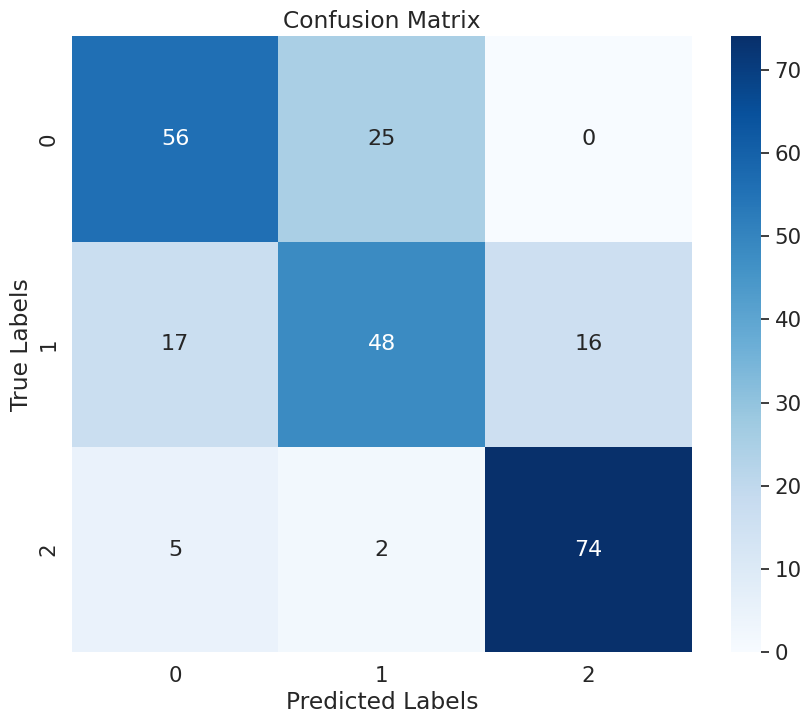

In [55]:
print("confusion matrix for data with oversampling")
cm = confusion_matrix(y_test_max, y_pred_max)

# Plotting the confusion matrix
plt.figure(figsize=(10, 8))
sns.set(font_scale=1.4)  # Adjust the font scale if needed
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", annot_kws={"size": 16})

plt.title("Confusion Matrix")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()

confusion matrix for data with undersampling


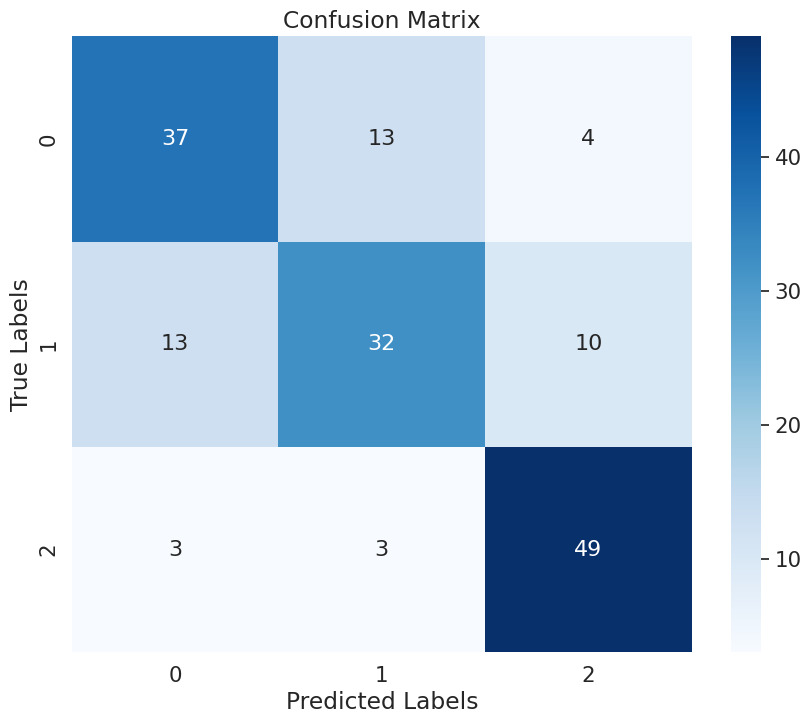

In [56]:
print("confusion matrix for data with undersampling")
cm = confusion_matrix(y_test_min, y_pred_min)

# Plotting the confusion matrix
plt.figure(figsize=(10, 8))
sns.set(font_scale=1.4)  # Adjust the font scale if needed
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", annot_kws={"size": 16})

plt.title("Confusion Matrix")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()

**cross valodation decision tree**

In [57]:
# Initialize k-fold cross-validation
kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Perform cross-validation
cv_scores = cross_val_score(adaboost_classifier, X_max, y_max, cv=kf)

# Print the cross-validation scores
print("Cross-Validation Scores:", cv_scores)
print("Mean CV Score:", cv_scores.mean())
print("std CV Score:", cv_scores.std())

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Cross-Validation Scores: [0.82716049 0.87242798 0.84710744 0.86363636 0.84710744]
Mean CV Score: 0.8514879434071354
std CV Score: 0.015596614073666588


In [58]:
# Initialize k-fold cross-validation
kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Perform cross-validation
cv_scores = cross_val_score(adaboost_classifier, X_min, y_min, cv=kf)

# Print the cross-validation scores
print("Cross-Validation Scores:", cv_scores)
print("Mean CV Score:", cv_scores.mean())
print("std CV Score:", cv_scores.std())

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


Cross-Validation Scores: [0.84756098 0.82208589 0.81595092 0.88957055 0.81595092]
Mean CV Score: 0.838223851563669
std CV Score: 0.02820023511454783


3. **Random forest**

In [59]:

# Initialize the Random Forest Classifier
rf_classifier_no_noise = RandomForestClassifier(n_estimators=100, max_depth=6, random_state=42)

# Fit the decision tree  classifier to  training data with noise and oversampling
rf_classifier_no_noise.fit(X_train_selected_max , y_train_max)

# Make predictions on the test data
y_pred_max = rf_classifier_no_noise.predict(X_test_selected_max)
print("method 1 data without noise and oversamling")
# Calculate and print the accuracy for the training data
train_accuracy = accuracy_score(y_train_max, rf_classifier_no_noise.predict(X_train_selected_max))
print(f"Training Accuracy: {train_accuracy:.2f}")

# Calculate and print the accuracy for the test data
test_accuracy_RF_max = accuracy_score(y_test_max, y_pred_max)
print(f"Testing Accuracy: {test_accuracy_RF_max:.2f}")

# Generate and print a classification report
report = classification_report(y_test_max, y_pred_max)
print("Classification Report:")
lines = report.split('\n')
for line in lines:
    print(line)
print("method 2 data without noise and undersampling")


# Fit the decision tree  classifier to  training data with noise and undersampling
rf_classifier_no_noise.fit(X_train_selected_min , y_train_min)

# Make predictions on the test data
y_pred_min = rf_classifier_no_noise.predict(X_test_selected_min)
# Calculate and print the accuracy for the training data
train_accuracy = accuracy_score(y_train_min, rf_classifier_no_noise.predict(X_train_selected_min))
print(f"Training Accuracy: {train_accuracy:.2f}")

# Calculate and print the accuracy for the test data
test_accuracy_RF_min = accuracy_score(y_test_min, y_pred_min)
print(f"Testing Accuracy: {test_accuracy_RF_min:.2f}")

# Generate and print a classification report
report = classification_report(y_test_min, y_pred_min)
print("Classification Report:")
lines = report.split('\n')
for line in lines:
    print(line)

method 1 data without noise and oversamling
Training Accuracy: 0.79
Testing Accuracy: 0.73
Classification Report:
              precision    recall  f1-score   support

         1.0       0.79      0.65      0.72        81
         2.0       0.61      0.64      0.63        81
         3.0       0.79      0.89      0.84        81

    accuracy                           0.73       243
   macro avg       0.73      0.73      0.73       243
weighted avg       0.73      0.73      0.73       243

method 2 data without noise and undersampling
Training Accuracy: 0.80
Testing Accuracy: 0.77
Classification Report:
              precision    recall  f1-score   support

         1.0       0.76      0.76      0.76        54
         2.0       0.70      0.69      0.70        55
         3.0       0.86      0.87      0.86        55

    accuracy                           0.77       164
   macro avg       0.77      0.77      0.77       164
weighted avg       0.77      0.77      0.77       164



In [60]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

# Define the hyperparameters grid for tuning
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}

# Initialize Grid Search Cross-Validation for noisy data with oversampling
rf_classifier = RandomForestClassifier(random_state=42)
grid_search_rf = GridSearchCV(estimator=rf_classifier, param_grid=param_grid, cv=5, scoring='accuracy', n_jobs=-1)

# Perform Grid Search CV to find the best hyperparameters
grid_search_rf.fit(X_train_selected_max, y_train_max)

# Get the best hyperparameters and model
best_rf_classifier_max = grid_search_rf.best_estimator_

# Make predictions on the training data to evaluate training accuracy
y_train_pred_rf_max = best_rf_classifier_max.predict(X_train_selected_max)
train_accuracy_rf_max = accuracy_score(y_train_max, y_train_pred_rf_max)
print("Random Forest Training Accuracy for  data with oversampling:", train_accuracy_rf_max)

# Make predictions on the test data using the best model
y_test_pred_rf_max = best_rf_classifier_max.predict(X_test_selected_max)
test_accuracy_rf_max = accuracy_score(y_test_max, y_test_pred_rf_max)
print("Random Forest Test Accuracy for  data with oversampling:", test_accuracy_rf_max)
print("Best Random Forest Hyperparameters for  data with oversampling:", grid_search_rf.best_params_)


Random Forest Training Accuracy for  data with oversampling: 0.8452012383900929
Random Forest Test Accuracy for  data with oversampling: 0.7448559670781894
Best Random Forest Hyperparameters for  data with oversampling: {'bootstrap': True, 'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 100}


In [61]:
# Initialize Grid Search Cross-Validation for noisy data with undersampling
grid_search_rf.fit(X_train_selected_min, y_train_min)

# Get the best hyperparameters and model
best_rf_classifier_min = grid_search_rf.best_estimator_

# Make predictions on the training data to evaluate training accuracy
y_train_pred_rf_min = best_rf_classifier_min.predict(X_train_selected_min)
train_accuracy_rf_min = accuracy_score(y_train_min, y_train_pred_rf_min)
print("Random Forest Training Accuracy for  data with undersampling:", train_accuracy_rf_min)

# Make predictions on the test data using the best model
y_test_pred_rf_min = best_rf_classifier_min.predict(X_test_selected_min)
test_accuracy_rf_min = accuracy_score(y_test_min, y_test_pred_rf_min)
print("Random Forest Test Accuracy for  data with undersampling:", test_accuracy_rf_min)
print("Best Random Forest Hyperparameters for  data with undersampling:", grid_search_rf.best_params_)


Random Forest Training Accuracy for  data with undersampling: 0.843558282208589
Random Forest Test Accuracy for  data with undersampling: 0.7378048780487805
Best Random Forest Hyperparameters for  data with undersampling: {'bootstrap': False, 'max_depth': 10, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 100}


**Adaboost Random forest**

In [62]:
from sklearn.ensemble import AdaBoostClassifier, RandomForestClassifier
from sklearn.metrics import accuracy_score

# Initialize the base Random Forest Classifier
base_classifier = RandomForestClassifier(n_estimators=100, random_state=42)

# Initialize the AdaBoost Classifier with Random Forest as base estimator
adaboost_classifier = AdaBoostClassifier(base_estimator=base_classifier, n_estimators=100, random_state=42)

# Train the AdaBoost classifier on  data with oversampling
adaboost_classifier.fit(X_train_selected_max, y_train_max)

# Make predictions on the training data to evaluate training accuracy
y_train_pred_adaboost_max = adaboost_classifier.predict(X_train_selected_max)
train_accuracy_adaboost_max = accuracy_score(y_train_max, y_train_pred_adaboost_max)
print("AdaBoost Training Accuracy with Random Forest for noisy data with oversampling:", train_accuracy_adaboost_max)

# Make predictions on the test data
y_test_pred_adaboost_max = adaboost_classifier.predict(X_test_selected_max)
test_accuracy_adaboost_max = accuracy_score(y_test_max, y_test_pred_adaboost_max)
print("AdaBoost Test Accuracy with Random Forest for  data with oversampling:", test_accuracy_adaboost_max)

# Train the AdaBoost classifier on  data with undersampling
adaboost_classifier.fit(X_train_selected_min, y_train_min)

# Make predictions on the training data to evaluate training accuracy
y_train_pred_adaboost_min = adaboost_classifier.predict(X_train_selected_min)
train_accuracy_adaboost_min = accuracy_score(y_train_min, y_train_pred_adaboost_min)
print("AdaBoost Training Accuracy with Random Forest for  data with undersampling:", train_accuracy_adaboost_min)

# Make predictions on the test data
y_test_pred_adaboost_min = adaboost_classifier.predict(X_test_selected_min)
test_accuracy_adaboost_min = accuracy_score(y_test_min, y_test_pred_adaboost_min)
print("AdaBoost Test Accuracy with Random Forest for  data with undersampling:", test_accuracy_adaboost_min)


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


AdaBoost Training Accuracy with Random Forest for noisy data with oversampling: 0.846233230134159
AdaBoost Test Accuracy with Random Forest for  data with oversampling: 0.7654320987654321


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


AdaBoost Training Accuracy with Random Forest for  data with undersampling: 0.8466257668711656
AdaBoost Test Accuracy with Random Forest for  data with undersampling: 0.75


In [63]:
# Loop through the dataframes in the dictionary
print("the accuracy for each attribute using the noisy data with oversampling ")
for name, df in data.items():


    # Create and train the model
    model = RandomForestClassifier(n_estimators=100, random_state=42)
    model.fit(X_train_selected_max, y_train_max)

    # Make predictions on the test set
    y_pred = model.predict(X_test_selected_max)

    # Calculate and print the accuracy
    accuracy = accuracy_score(y_test_max, y_pred)
    print(f"Accuracy for {name}: {accuracy}")

the accuracy for each attribute using the noisy data with oversampling 
Accuracy for Age: 0.7448559670781894
Accuracy for SystolicBP: 0.7448559670781894
Accuracy for DiastolicBP: 0.7448559670781894
Accuracy for BS: 0.7448559670781894
Accuracy for BodyTemp: 0.7448559670781894
Accuracy for RiskLevel: 0.7448559670781894


In [64]:
# Loop through the dataframes in the dictionary
print("the accuracy for each attribute using  data with undersampling ")
for name, df in data.items():


    # Create and train the model
    model = RandomForestClassifier(n_estimators=100, random_state=42)
    model.fit(X_train_selected_min, y_train_min)

    # Make predictions on the test set
    y_pred = model.predict(X_test_selected_min)

    # Calculate and print the accuracy
    accuracy = accuracy_score(y_test_min, y_pred)
    print(f"Accuracy for {name}: {accuracy}")

the accuracy for each attribute using  data with undersampling 
Accuracy for Age: 0.7560975609756098
Accuracy for SystolicBP: 0.7560975609756098
Accuracy for DiastolicBP: 0.7560975609756098
Accuracy for BS: 0.7560975609756098
Accuracy for BodyTemp: 0.7560975609756098
Accuracy for RiskLevel: 0.7560975609756098


**confusion matrix**

confusion matrix for data with oversampling


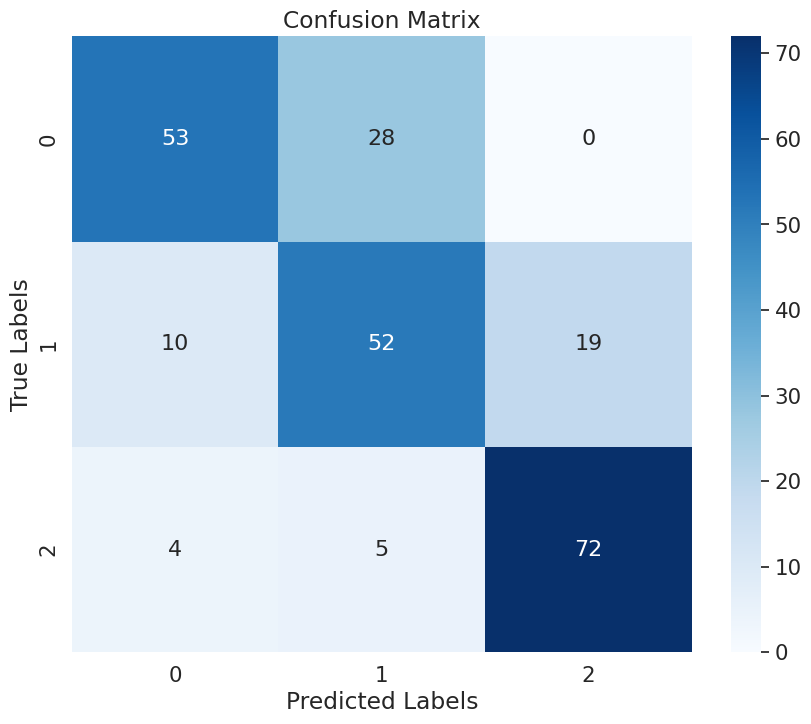

In [65]:
print("confusion matrix for data with oversampling")
cm = confusion_matrix(y_test_max, y_pred_max)

# Plotting the confusion matrix
plt.figure(figsize=(10, 8))
sns.set(font_scale=1.4)  # Adjust the font scale if needed
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", annot_kws={"size": 16})

plt.title("Confusion Matrix")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()

confusion matrix for noisy data with undersampling


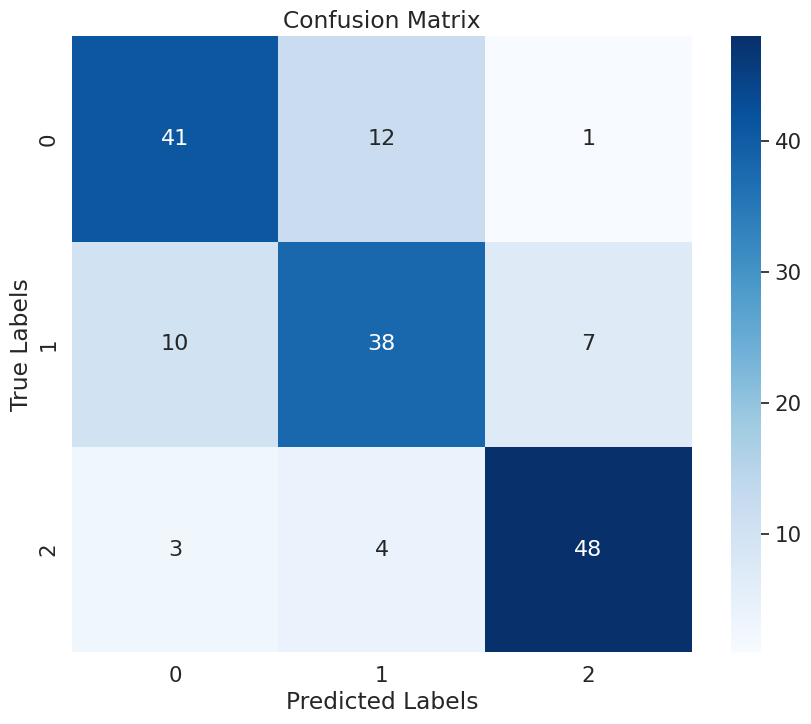

In [66]:
print("confusion matrix for noisy data with undersampling")
cm = confusion_matrix(y_test_min, y_pred_min)

# Plotting the confusion matrix
plt.figure(figsize=(10, 8))
sns.set(font_scale=1.4)  # Adjust the font scale if needed
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", annot_kws={"size": 16})

plt.title("Confusion Matrix")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()

**K-Nearest Neighbors (KNN)**

In [78]:
# Create the scaler object
scaler = MinMaxScaler()

# Normalize the training and testing data
X_train_normalized_max = scaler.fit_transform(X_train_selected_max)
X_test_normalized_max = scaler.transform(X_test_selected_max)
X_train_normalized_min = scaler.fit_transform(X_train_selected_min)
X_test_normalized_min = scaler.transform(X_test_selected_min)
# Initialize the KNN Classifier
knn_classifier = KNeighborsClassifier(n_neighbors=5)  # You can adjust the number of neighbors (k)

print("data with oversampling ")
# Fit the classifier to your training data (normalized)
knn_classifier.fit(X_train_normalized_max, y_train_max)
# Make predictions on the test data
y_pred_knn = knn_classifier.predict(X_test_normalized_max)

# Calculate and print the accuracy for the training data
train_accuracy_knn = accuracy_score(y_train_max, knn_classifier.predict(X_train_normalized_max ))
print(f"Training Accuracy: {train_accuracy_knn:.2f}")

# Calculate and print the accuracy for the test data
test_accuracy_knn_max = accuracy_score(y_test_max, y_pred_knn)
print(f"Testing Accuracy: {test_accuracy_knn_max:.2f}")

# Generate and print a classification report
report = classification_report(y_test_max, y_pred_knn)
print("Classification Report:")
lines = report.split('\n')
for line in lines:
    print(line)

print("data with undersampling ")

# Fit the classifier to your training data (normalized)
knn_classifier.fit(X_train_normalized_min, y_train_min)
# Make predictions on the test data
y_pred_knn = knn_classifier.predict(X_test_normalized_min)

# Calculate and print the accuracy for the training data
train_accuracy_knn = accuracy_score(y_train_min, knn_classifier.predict(X_train_normalized_min ))
print(f"Training Accuracy: {train_accuracy_knn:.2f}")

# Calculate and print the accuracy for the test data
test_accuracy_knn_min = accuracy_score(y_test_min, y_pred_knn)
print(f"Testing Accuracy: {test_accuracy_knn_min:.2f}")

# Generate and print a classification report
report = classification_report(y_test_min, y_pred_knn)
print("Classification Report:")
lines = report.split('\n')
for line in lines:
    print(line)

data with oversampling 
Training Accuracy: 0.80
Testing Accuracy: 0.74
Classification Report:
              precision    recall  f1-score   support

         1.0       0.73      0.79      0.76        81
         2.0       0.65      0.63      0.64        81
         3.0       0.86      0.81      0.84        81

    accuracy                           0.74       243
   macro avg       0.75      0.74      0.74       243
weighted avg       0.75      0.74      0.74       243

data with undersampling 
Training Accuracy: 0.78
Testing Accuracy: 0.74
Classification Report:
              precision    recall  f1-score   support

         1.0       0.72      0.70      0.71        54
         2.0       0.72      0.60      0.65        55
         3.0       0.77      0.91      0.83        55

    accuracy                           0.74       164
   macro avg       0.73      0.74      0.73       164
weighted avg       0.73      0.74      0.73       164



**Hyperparameter Tuning with GridSearchCV for the KNN:**

In [77]:
from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import StandardScaler

# Normalize the data
scaler = StandardScaler()
X_train_normalized_max = scaler.fit_transform(X_train_max)
X_test_normalized_max = scaler.transform(X_test_max)
X_train_normalized_min = scaler.fit_transform(X_train_min)
X_test_normalized_min = scaler.transform(X_test_min)

# Define the hyperparameters grid for tuning
param_grid = {
    'n_neighbors': [3, 5, 7, 9, 11]
}

# Initialize KNN classifier
knn_classifier = KNeighborsClassifier()

# Initialize Grid Search Cross-Validation for  data with oversampling
grid_search_knn = GridSearchCV(estimator=knn_classifier, param_grid=param_grid, cv=5, scoring='accuracy')

# Perform Grid Search CV using the normalized training data with oversampling
grid_search_knn.fit(X_train_normalized_max, y_train_max)

# Get the best hyperparameters and model for oversampling
best_knn_classifier_max = grid_search_knn.best_estimator_

# Make predictions on the training data to evaluate training accuracy
y_train_pred_knn_max = best_knn_classifier_max.predict(X_train_normalized_max)
train_accuracy_knn_max = accuracy_score(y_train_max, y_train_pred_knn_max)
print("KNN Training Accuracy for  data with oversampling:", train_accuracy_knn_max)

# Make predictions on the test data using the best model
y_test_pred_knn_max = best_knn_classifier_max.predict(X_test_normalized_max)
test_accuracy_knn_max = accuracy_score(y_test_max, y_test_pred_knn_max)
print("KNN Test Accuracy for  data with oversampling:", test_accuracy_knn_max)
print("Best KNN Hyperparameters for  data with oversampling:", grid_search_knn.best_params_)

# Perform Grid Search CV using the normalized training data with undersampling
grid_search_knn.fit(X_train_normalized_min, y_train_min)

# Get the best hyperparameters and model for undersampling
best_knn_classifier_min = grid_search_knn.best_estimator_

# Make predictions on the training data to evaluate training accuracy
y_train_pred_knn_min = best_knn_classifier_min.predict(X_train_normalized_min)
train_accuracy_knn_min = accuracy_score(y_train_min, y_train_pred_knn_min)
print("KNN Training Accuracy for  data with undersampling:", train_accuracy_knn_min)

# Make predictions on the test data using the best model
y_test_pred_knn_min = best_knn_classifier_min.predict(X_test_normalized_min)
test_accuracy_knn_min = accuracy_score(y_test_min, y_test_pred_knn_min)
print("KNN Test Accuracy for  data with undersampling:", test_accuracy_knn_min)
print("Best KNN Hyperparameters for  data with undersampling:", grid_search_knn.best_params_)


KNN Training Accuracy for  data with oversampling: 0.9112487100103199
KNN Test Accuracy for  data with oversampling: 0.7901234567901234
Best KNN Hyperparameters for  data with oversampling: {'n_neighbors': 3}
KNN Training Accuracy for  data with undersampling: 0.8665644171779141
KNN Test Accuracy for  data with undersampling: 0.774390243902439
Best KNN Hyperparameters for  data with undersampling: {'n_neighbors': 3}


In [72]:
# Create a VotingClassifier object
ensemble_model = VotingClassifier(estimators=[
    ('knn', knn_classifier),
    ('rf', rf_classifier)

], voting='hard')  # You can choose 'hard' or 'soft' voting
# Train the ensemble model on the normalized training data
ensemble_model.fit(X_train_normalized_max, y_train_max)

# Make predictions on the normalized testing data
y_pred_ensemble_max = ensemble_model.predict(X_test_normalized_max)

# Evaluate the model's accuracy
accuracy_ensemble = accuracy_score(y_test_max, y_pred_ensemble_max)
print("Ensemble Model Accuracy for  data with oversampling :", accuracy_ensemble)


# Train the ensemble model on the normalized training data
ensemble_model.fit(X_train_normalized_min, y_train_min)

# Make predictions on the normalized testing data
y_pred_ensemble_min = ensemble_model.predict(X_test_normalized_min)

# Evaluate the model's accuracy
accuracy_ensemble = accuracy_score(y_test_min, y_pred_ensemble_min)
print("Ensemble Model Accuracy for data with undersampling", accuracy_ensemble)



Ensemble Model Accuracy for  data with oversampling : 0.7901234567901234
Ensemble Model Accuracy for data with undersampling 0.8170731707317073


**confusion matrix**

confusion matrix for data with oversampling
KNN Test Accuracy: 0.7325102880658436


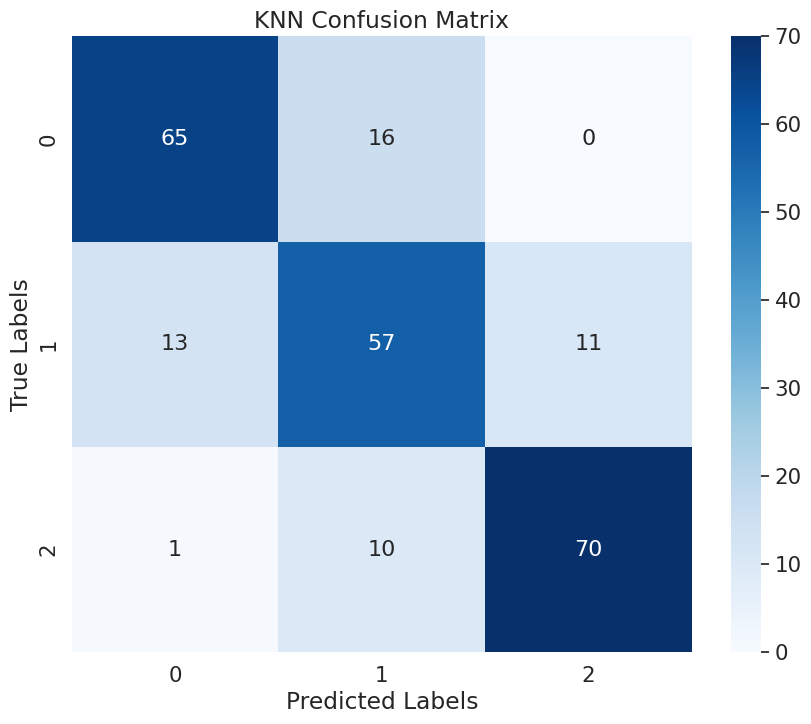

In [79]:
print("confusion matrix for data with oversampling")
# Make predictions on the test data using the KNN model
y_pred_knn = knn_classifier.predict(X_test_normalized_max)

# Evaluate the KNN model's accuracy
accuracy_knn = accuracy_score(y_test_max, y_pred_knn)
print("KNN Test Accuracy:", accuracy_knn)

# Generate and print the confusion matrix for the KNN model
cm_knn = confusion_matrix(y_test_max, y_pred_ensemble_max)

# Plotting the confusion matrix for KNN
plt.figure(figsize=(10, 8))
sns.set(font_scale=1.4)  # Adjust the font scale if needed
sns.heatmap(cm_knn, annot=True, fmt="d", cmap="Blues", annot_kws={"size": 16})

plt.title("KNN Confusion Matrix")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()


confusion matrix for data with undersampling
KNN Test Accuracy: 0.7378048780487805


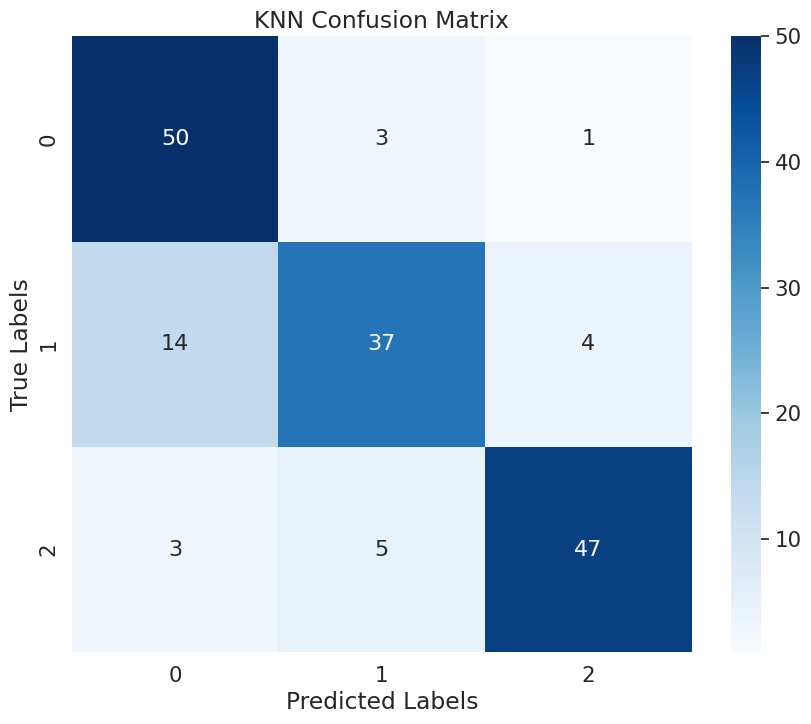

In [80]:
print("confusion matrix for data with undersampling")
# Make predictions on the test data using the KNN model
y_pred_knn = knn_classifier.predict(X_test_normalized_min)

# Evaluate the KNN model's accuracy
accuracy_knn = accuracy_score(y_test_min, y_pred_knn)
print("KNN Test Accuracy:", accuracy_knn)

# Generate and print the confusion matrix for the KNN model
cm_knn = confusion_matrix(y_test_min, y_pred_ensemble_min)

# Plotting the confusion matrix for KNN
plt.figure(figsize=(10, 8))
sns.set(font_scale=1.4)  # Adjust the font scale if needed
sns.heatmap(cm_knn, annot=True, fmt="d", cmap="Blues", annot_kws={"size": 16})

plt.title("KNN Confusion Matrix")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()


In [81]:
# Initialize k-fold cross-validation
kf = KFold(n_splits=5, shuffle=True, random_state=42)
print("cross validation for  data with oversampling")
# Perform cross-validation
cv_scores = cross_val_score(knn_classifier, X_train_normalized_max, y_train_max, cv=kf)
# Print the cross-validation scores
print("Cross-Validation Scores:", cv_scores)
print("Mean CV Score:", cv_scores.mean())
print("std CV Score:", cv_scores.std())

print("cross validation for  data with undersampling")
# Perform cross-validation
cv_scores = cross_val_score(knn_classifier, X_train_normalized_min, y_train_min, cv=kf)
# Print the cross-validation scores
print("Cross-Validation Scores:", cv_scores)
print("Mean CV Score:", cv_scores.mean())
print("std CV Score:", cv_scores.std())


cross validation for  data with oversampling
Cross-Validation Scores: [0.77835052 0.75257732 0.71649485 0.77319588 0.75129534]
Mean CV Score: 0.7543827786977191
std CV Score: 0.02180216741219907
cross validation for  data with undersampling
Cross-Validation Scores: [0.64122137 0.64885496 0.70769231 0.73846154 0.68461538]
Mean CV Score: 0.6841691133294188
std CV Score: 0.036311994887016745


**SVM**

**PCA only 2 principle componenets to plot the data and see the distribution**

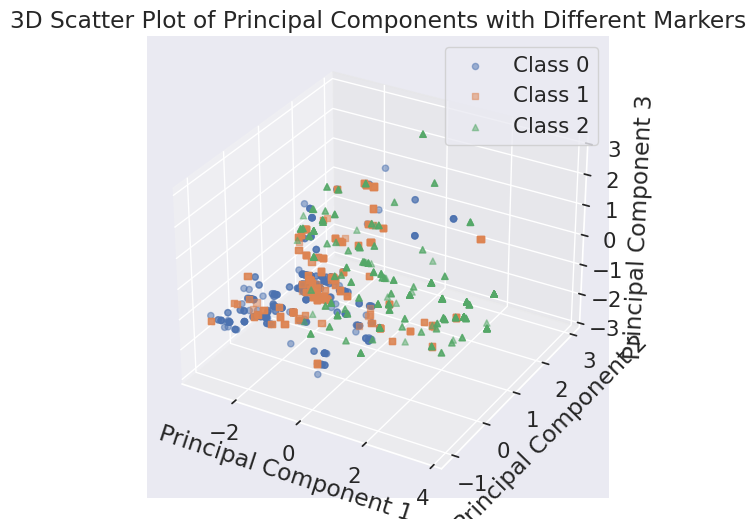

In [82]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler


# Step 1: Data Preprocessing
scaler = StandardScaler()
X_scaled_max = scaler.fit_transform(X_max)

# Step 2: Perform PCA
pca = PCA(n_components=3)
X_pca = pca.fit_transform(X_scaled_max)

# Separate data by class
class_0 = X_pca[y_max == 1]
class_1 = X_pca[y_max == 2]
class_2 = X_pca[y_max == 3]

# Plot the 3D scatter plot with different markers for each class
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(class_0[:, 0], class_0[:, 1], class_0[:, 2], marker='o', label='Class 0', alpha=0.5)
ax.scatter(class_1[:, 0], class_1[:, 1], class_1[:, 2], marker='s', label='Class 1', alpha=0.5)
ax.scatter(class_2[:, 0], class_2[:, 1], class_2[:, 2], marker='^', label='Class 2', alpha=0.5)

ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')
ax.set_zlabel('Principal Component 3')
ax.set_title('3D Scatter Plot of Principal Components with Different Markers')
ax.legend()
plt.show()

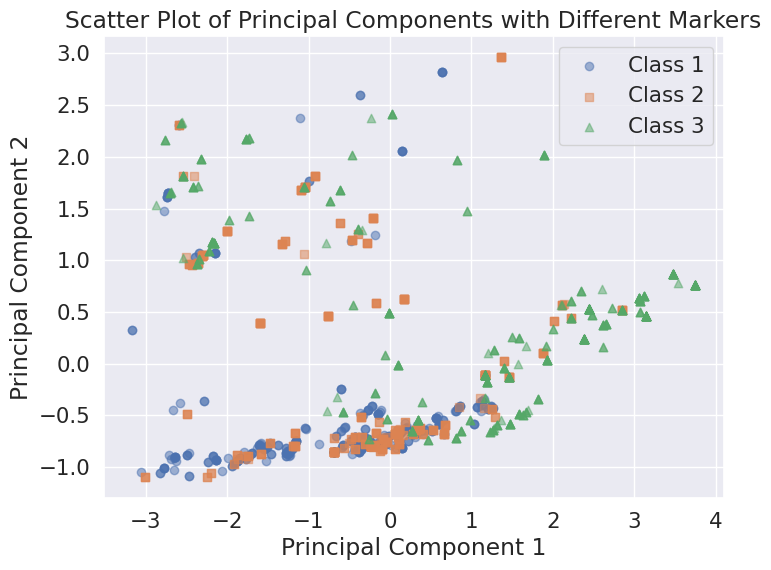

In [83]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler


# Step 1: Data Preprocessing
scaler = StandardScaler()
X_scaled_max = scaler.fit_transform(X_max)

# Step 2: Perform PCA
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled_max)

# Separate data by class
class_0 = X_pca[y_max == 1]
class_1 = X_pca[y_max == 2]
class_2 = X_pca[y_max == 3]

# Plot the scatter plot with different markers for each class
plt.figure(figsize=(8, 6))
plt.scatter(class_0[:, 0], class_0[:, 1], marker='o', label='Class 1', alpha=0.5)
plt.scatter(class_1[:, 0], class_1[:, 1], marker='s', label='Class 2', alpha=0.5)
plt.scatter(class_2[:, 0], class_2[:, 1], marker='^', label='Class 3', alpha=0.5)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('Scatter Plot of Principal Components with Different Markers')
plt.legend()
plt.grid(True)
plt.show()

In [84]:
# Create a pipeline with normalization and SVM classifier
svm_pipeline = Pipeline([
    ('scaler', StandardScaler()),  # Normalization
    ('svm', SVC())  # Support Vector Machine classifier
])

print("svm for data and oversampling")
# Fit the pipeline to the training data
svm_pipeline.fit(X_train_max, y_train_max)

# Evaluate the model
accuracy = svm_pipeline.score(X_train_max, y_train_max)
print("training Accuracy:", accuracy)

accuracy_max = svm_pipeline.score(X_test_max, y_test_max)
print("Accuracy:", accuracy_max)

# Generate and print a classification report

print("Classification Report:")
lines = report.split('\n')
for line in lines:
    print(line)



print("svm for data and undersampling")

# Fit the pipeline to the training data
svm_pipeline.fit(X_train_min, y_train_min)

# Evaluate the model
accuracy = svm_pipeline.score(X_train_min, y_train_min)
print("training Accuracy:", accuracy)

accuracy_min = svm_pipeline.score(X_test_min, y_test_min)
print("Accuracy:", accuracy_min)

# Generate and print a classification report
report = classification_report(y_test_min, y_pred)
print("Classification Report:")
lines = report.split('\n')
for line in lines:
    print(line)

svm for data and oversampling
training Accuracy: 0.7162022703818369
Accuracy: 0.691358024691358
Classification Report:
              precision    recall  f1-score   support

         1.0       0.72      0.70      0.71        54
         2.0       0.72      0.60      0.65        55
         3.0       0.77      0.91      0.83        55

    accuracy                           0.74       164
   macro avg       0.73      0.74      0.73       164
weighted avg       0.73      0.74      0.73       164

svm for data and undersampling
training Accuracy: 0.6947852760736196
Accuracy: 0.7621951219512195
Classification Report:
              precision    recall  f1-score   support

         1.0       0.78      0.65      0.71        54
         2.0       0.69      0.73      0.71        55
         3.0       0.80      0.89      0.84        55

    accuracy                           0.76       164
   macro avg       0.76      0.76      0.75       164
weighted avg       0.76      0.76      0.75       164

**cross-validation**

In [85]:
# Initialize k-fold cross-validation
kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Perform cross-validation
cv_scores = cross_val_score(svm_pipeline, X_max, y_max, cv=kf)

# Print the cross-validation scores
print("Cross-Validation Scores:", cv_scores)
print("Mean CV Score:", cv_scores.mean())
print("std CV Score:", cv_scores.std())

Cross-Validation Scores: [0.69135802 0.72016461 0.66942149 0.70661157 0.7107438 ]
Mean CV Score: 0.6996598986497975
std CV Score: 0.017747700732029414


In [86]:
# Initialize k-fold cross-validation
kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Perform cross-validation
cv_scores = cross_val_score(svm_pipeline, X_min, y_min, cv=kf)

# Print the cross-validation scores
print("Cross-Validation Scores:", cv_scores)
print("Mean CV Score:", cv_scores.mean())
print("std CV Score:", cv_scores.std())

Cross-Validation Scores: [0.6402439  0.6993865  0.63190184 0.71779141 0.6993865 ]
Mean CV Score: 0.6777420320215471
std CV Score: 0.03478031597176738


**hyper parameter tuning for SVM using grid search**

In [87]:
from sklearn.model_selection import GridSearchCV

# Define parameter grid
param_grid = {
    'svm__C': [0.1, 1, 10, 100],
    'svm__gamma': [1, 0.1, 0.01, 0.001],
    'svm__kernel': ['rbf', 'linear', 'poly', 'sigmoid']
}

# Grid search
grid_search = GridSearchCV(svm_pipeline, param_grid, cv=5)
grid_search.fit(X_train_max, y_train_max)

# Best parameters and best score
print("Best parameters for  data with oversampling:", grid_search.best_params_)
print("Best score for  data with oversampling:", grid_search.best_score_)






Best parameters for  data with oversampling: {'svm__C': 100, 'svm__gamma': 1, 'svm__kernel': 'rbf'}
Best score for  data with oversampling: 0.8431280380321564


In [88]:
best_model1 = grid_search.best_estimator_
print(best_model1)

Pipeline(steps=[('scaler', StandardScaler()), ('svm', SVC(C=100, gamma=1))])


In [89]:
from sklearn.model_selection import GridSearchCV

# Define parameter grid
param_grid = {
    'svm__C': [0.1, 1, 10, 100],
    'svm__gamma': [1, 0.1, 0.01, 0.001],
    'svm__kernel': ['rbf', 'linear', 'poly', 'sigmoid']
}

# Grid search
grid_search = GridSearchCV(svm_pipeline, param_grid, cv=5)
grid_search.fit(X_train_min, y_train_min)

# Best parameters and best score
print("Best parameters for noisy data with oversampling:", grid_search.best_params_)
print("Best score for noisy data with oversampling:", grid_search.best_score_)






Best parameters for noisy data with oversampling: {'svm__C': 100, 'svm__gamma': 1, 'svm__kernel': 'rbf'}
Best score for noisy data with oversampling: 0.8160540223135643


In [90]:
best_model2 = grid_search.best_estimator_
print(best_model2)

Pipeline(steps=[('scaler', StandardScaler()), ('svm', SVC(C=100, gamma=1))])


**Confusion Matrix**

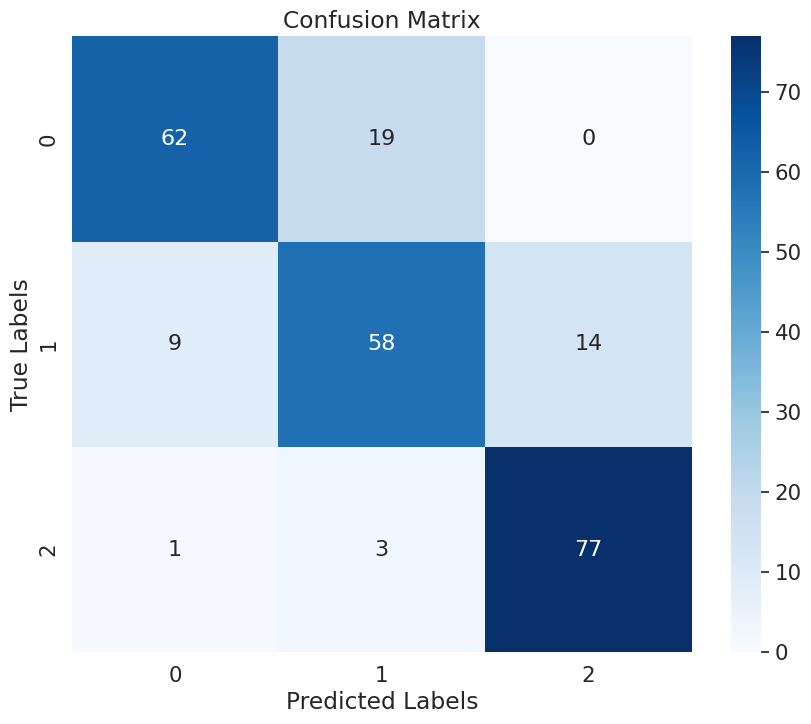

In [91]:
y_pred=best_model1.predict(X_test_max)
cm = confusion_matrix(y_test_max, y_pred)

# Plotting the confusion matrix
plt.figure(figsize=(10, 8))
sns.set(font_scale=1.4)  # Adjust the font scale if needed
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", annot_kws={"size": 16})

plt.title("Confusion Matrix")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()

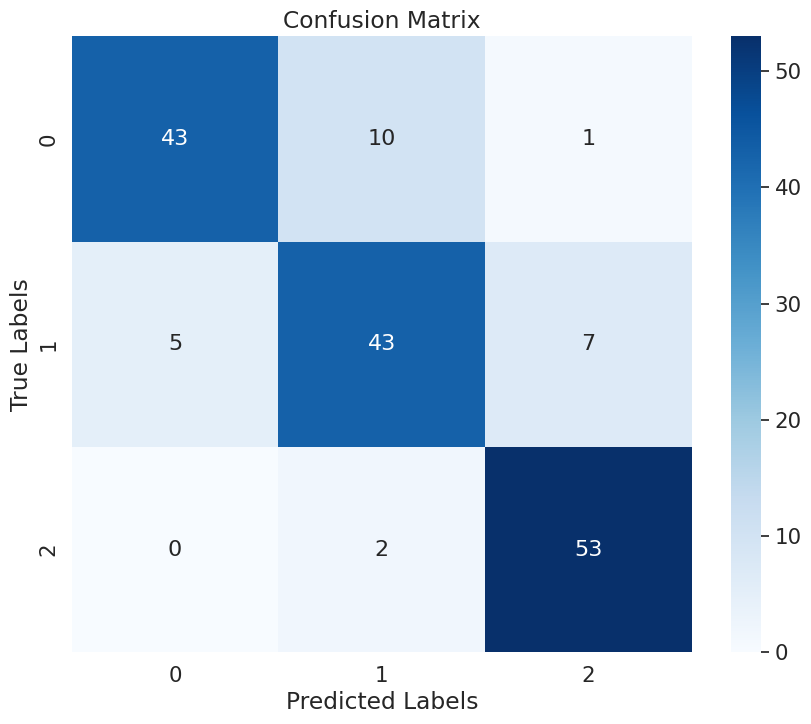

In [92]:
y_pred=best_model1.predict(X_test_min)
cm = confusion_matrix(y_test_min, y_pred)

# Plotting the confusion matrix
plt.figure(figsize=(10, 8))
sns.set(font_scale=1.4)  # Adjust the font scale if needed
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", annot_kws={"size": 16})

plt.title("Confusion Matrix")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()

**ensemble models using svm models**

In [94]:
from sklearn.feature_selection import SelectKBest, mutual_info_classif
import numpy as np

class ensemble:

    def __init__(self, n_estimators=10):
        self.n_estimators = n_estimators

    def fit(self, X, y):

        n_samples = X.shape[0]
        sample_weights = np.ones(n_samples) / n_samples

        self.learners = []
        self.learner_weights = []
        self.meta_learner = SVC()
        self.selected_indices = None

        for i in range(self.n_estimators):
            learner = SVC(C=100, gamma=1, kernel='rbf')

            learner.fit(X, y, sample_weight=sample_weights)

            y_pred = learner.predict(X)
            misclassified_indices = np.where(y_pred != y)[0]

            error_rate = np.sum(sample_weights * (y_pred != y)) / np.sum(sample_weights)
            learner_weight = 0.5 * np.log((1 - error_rate) / (error_rate + 1e-10))

            # Replace NaN values in sample_weights with zeros
            sample_weights[np.isnan(sample_weights)] = 0

            # Update weights
            sample_weights = sample_weights * np.exp(
                np.where(y == y_pred, 1 / (2 * (1 - error_rate)), (error_rate / (2 * (1 - error_rate) ** 2)))
            )

            # Normalize weights
            sample_weights /= np.sum(sample_weights)

            self.learners.append(learner)
            self.learner_weights.append(learner_weight)

        predictions = []
        for learner in self.learners:
            pred = learner.predict(X)
            predictions.append(pred.reshape(-1, 1))
        stacked_predictions = np.hstack(predictions)
        self.meta_learner.fit(stacked_predictions, y)

        return self

    def predict(self, X):
        predictions = []

        for learner, learner_weight in zip(self.learners, self.learner_weights):
            pred = learner.predict(X)
            predictions.append(pred.reshape(-1, 1))

        stacked_predictions = np.hstack(predictions)
        y_meta_pred = self.meta_learner.predict(stacked_predictions)
        return y_meta_pred

In [95]:
ensemble =  ensemble(n_estimators=10)
ensemble .fit(X_train_max,y_train_max)

In [96]:
#Compute the accuracy of the model
from sklearn.metrics import accuracy_score

# Test Acc
# Calculating Test Accuracy
y_test_hat = ensemble.predict(X_test_max)
accuracy=accuracy_score(y_test_max,y_test_hat)

# Train Acc

## Train Accuracy with the Bagger modeel
y_train_hat = ensemble.predict(X_train_max)
accuracy_train = accuracy_score(y_train_hat, y_train_max)

## TO DO .... !!  #
print(y_test_hat)


print('Accuracy Test:', accuracy)
print('Accuracy Train:', accuracy_train)

[1. 1. 1. 2. 2. 3. 3. 3. 1. 1. 1. 2. 1. 1. 1. 3. 1. 2. 2. 3. 2. 1. 1. 1.
 3. 1. 2. 2. 1. 1. 1. 1. 2. 3. 3. 1. 1. 3. 3. 1. 1. 1. 3. 3. 3. 2. 1. 3.
 2. 3. 1. 2. 3. 2. 1. 1. 2. 1. 2. 3. 3. 3. 1. 1. 3. 3. 2. 3. 3. 3. 2. 3.
 3. 1. 2. 3. 3. 2. 2. 2. 3. 1. 3. 3. 2. 3. 1. 3. 2. 1. 1. 1. 1. 2. 3. 3.
 1. 1. 3. 2. 3. 2. 1. 2. 3. 2. 1. 2. 3. 3. 2. 3. 2. 1. 3. 3. 1. 1. 1. 1.
 2. 1. 1. 2. 1. 1. 3. 3. 1. 3. 3. 3. 3. 2. 1. 2. 3. 3. 3. 3. 3. 2. 2. 1.
 3. 2. 3. 3. 1. 3. 2. 1. 1. 3. 3. 1. 1. 3. 3. 2. 1. 2. 3. 2. 2. 2. 3. 2.
 3. 3. 1. 1. 3. 2. 3. 2. 2. 2. 3. 2. 2. 2. 1. 2. 2. 2. 1. 2. 2. 2. 2. 3.
 2. 3. 3. 3. 2. 3. 2. 3. 2. 3. 1. 3. 2. 3. 2. 3. 2. 2. 3. 1. 2. 1. 3. 1.
 1. 1. 2. 2. 2. 3. 1. 1. 3. 2. 2. 3. 3. 1. 1. 1. 1. 2. 3. 3. 1. 2. 2. 3.
 2. 1. 1.]
Accuracy Test: 0.7777777777777778
Accuracy Train: 0.8730650154798761


In [97]:

y_test_hat = ensemble.predict(X_test_min)
accuracy=accuracy_score(y_test_min,y_test_hat)

y_train_hat = ensemble.predict(X_train_min)
accuracy_train = accuracy_score(y_train_hat, y_train_min)

print(y_test_hat)

print('Accuracy Test:', accuracy)
print('Accuracy Train:', accuracy_train)

[3. 1. 3. 2. 3. 3. 1. 3. 3. 3. 2. 1. 3. 3. 1. 1. 3. 3. 3. 3. 1. 2. 1. 1.
 2. 1. 3. 1. 2. 1. 1. 1. 2. 1. 1. 1. 2. 1. 3. 2. 1. 2. 1. 1. 3. 2. 3. 3.
 1. 1. 1. 3. 2. 2. 3. 1. 2. 1. 1. 1. 2. 1. 1. 3. 2. 1. 1. 1. 3. 3. 3. 2.
 2. 1. 2. 3. 1. 3. 3. 3. 3. 3. 2. 2. 1. 2. 1. 2. 3. 2. 1. 3. 3. 1. 3. 3.
 1. 1. 3. 1. 3. 3. 1. 3. 3. 1. 1. 2. 3. 2. 1. 1. 3. 2. 1. 3. 3. 1. 3. 3.
 3. 3. 1. 2. 2. 2. 2. 2. 3. 3. 1. 3. 2. 2. 2. 1. 1. 2. 2. 1. 3. 1. 2. 1.
 3. 2. 3. 3. 2. 3. 1. 2. 2. 3. 1. 3. 2. 3. 3. 1. 2. 3. 2. 2.]
Accuracy Test: 0.8414634146341463
Accuracy Train: 0.8650306748466258


**Artificial Neural Network**

In [98]:
# Normalize features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train_selected_max)
X_test_scaled = scaler.transform(X_test_selected_max)

# Create and train the ANN model
ann = MLPClassifier(hidden_layer_sizes=(100, ), max_iter=1000, random_state=42)
ann.fit(X_train_scaled, y_train_max)

# Predict on the testing set
y_pred = ann.predict(X_test_scaled)

# Calculate accuracy
accuracy =  ann.score(X_train_scaled, y_train_max)
print("Training Accuracy:", accuracy)

accuracy_ANN_max = accuracy_score(y_test_max, y_pred)
print("Testing Accuracy:", accuracy_ANN_max)

# Generate and print a classification report
report = classification_report(y_test_max, y_pred)
print("Classification Report:")
lines = report.split('\n')
for line in lines:
    print(line)

Training Accuracy: 0.7327141382868937
Testing Accuracy: 0.7037037037037037
Classification Report:
              precision    recall  f1-score   support

         1.0       0.71      0.75      0.73        81
         2.0       0.62      0.48      0.54        81
         3.0       0.76      0.88      0.81        81

    accuracy                           0.70       243
   macro avg       0.69      0.70      0.69       243
weighted avg       0.69      0.70      0.69       243



In [99]:
# Normalize features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train_selected_min)
X_test_scaled = scaler.transform(X_test_selected_min)

# Create and train the ANN model
ann = MLPClassifier(hidden_layer_sizes=(100, ), max_iter=1000, random_state=42)
ann.fit(X_train_scaled, y_train_min)

# Predict on the testing set
y_pred = ann.predict(X_test_scaled)

# Calculate accuracy
accuracy =  ann.score(X_train_scaled, y_train_min)
print("Training Accuracy:", accuracy)

accuracy_ANN_min = accuracy_score(y_test_min, y_pred)
print("Testing Accuracy:", accuracy_ANN_min)

# Generate and print a classification report
report = classification_report(y_test_min, y_pred)
print("Classification Report:")
lines = report.split('\n')
for line in lines:
    print(line)

Training Accuracy: 0.74079754601227
Testing Accuracy: 0.7865853658536586
Classification Report:
              precision    recall  f1-score   support

         1.0       0.78      0.74      0.76        54
         2.0       0.72      0.69      0.70        55
         3.0       0.85      0.93      0.89        55

    accuracy                           0.79       164
   macro avg       0.78      0.79      0.78       164
weighted avg       0.78      0.79      0.78       164



# **Expirment 02: adding noise to duplicates and applying Sampling methods**

1-up sampling with noise

In [100]:
data_noisy =data
# Identify duplicates based on all columns except 'RiskLevel'
duplicates = data_noisy[data_noisy.duplicated(subset=data_noisy.columns.difference(['RiskLevel']), keep=False)]

# Generate noise for numerical columns
noise_mean = 0  # Mean of the noise
noise_std = 1  # Standard deviation of the noise

for col in ['Age', 'SystolicBP', 'DiastolicBP', 'BS', 'BodyTemp']:
    noise = np.random.normal(noise_mean, noise_std, size=len(duplicates))
    data_noisy.loc[duplicates.index, col] += noise

print(data_noisy)

            Age  SystolicBP  DiastolicBP         BS    BodyTemp  RiskLevel
0     25.000000  130.000000    80.000000  15.000000   98.000000        3.0
1     35.165735  139.563333    89.055419  12.265678   98.974674        3.0
2     28.324750   90.379285    72.645734   8.085260  100.568615        3.0
3     29.706966  138.955282    86.051666   6.235095   97.298985        3.0
4     35.476099  121.121392    62.022227   5.343923   98.091351        1.0
...         ...         ...          ...        ...         ...        ...
1009  21.574515  121.443312    58.728947  14.392203   98.404380        3.0
1010  54.061854  121.606018    89.133690  17.728083   97.990259        3.0
1011  34.738914   86.013162    59.087723  19.822571   98.839645        3.0
1012  42.789102  118.947678    89.106052  18.621117   99.150799        3.0
1013  32.923151  120.608016    66.621909   5.517985   99.959133        2.0

[1012 rows x 6 columns]


In [101]:
from sklearn.utils import resample
import pandas as pd

# Count the number of samples in each class
class_counts = data_noisy['RiskLevel'].value_counts()

# Determine the largest class size
min_class_size = class_counts.max()

# downsample the larger classes to match the size of the largest class
df_resampled_max = pd.concat([
    resample(data_noisy[data_noisy['RiskLevel'] == level],  # Select samples from the class
             n_samples=min_class_size,       # Sample size to match the largest class
             replace=True,                   # Sample with replacement
             random_state=42)                # Set random state for reproducibility
    for level in class_counts.index         # Loop over class levels
])

# Check the distribution of classes in the resampled dataset
print(df_resampled_max['RiskLevel'].value_counts())


1.0    404
2.0    404
3.0    404
Name: RiskLevel, dtype: int64


In [102]:
# Stratified Dataset Splitting
X_noisy_max = df_resampled_max.drop('RiskLevel',axis=1)
y_noisy_max = df_resampled_max['RiskLevel']

X_train_noisy_max,X_test_noisy_max,y_train_noisy_max,y_test_noisy_max=train_test_split(X_noisy_max,y_noisy_max,test_size=0.2,
                                               random_state=42, shuffle= True , stratify=y_noisy_max  )


**downsampling with noise**

In [103]:
from sklearn.utils import resample
import pandas as pd

# Count the number of samples in each class
class_counts = data_noisy['RiskLevel'].value_counts()

# Determine the smallest class size
min_class_size = class_counts.min()

# downsample the smaller classes to match the size of the smallest class
df_resampled_min = pd.concat([
    resample(data_noisy[data_noisy['RiskLevel'] == level],  # Select samples from the class
             n_samples=min_class_size,       # Sample size to match the smallest class
             replace=True,                   # Sample with replacement
             random_state=42)                # Set random state for reproducibility
    for level in class_counts.index         # Loop over class levels
])

# Check the distribution of classes in the resampled dataset
print(df_resampled_min['RiskLevel'].value_counts())


1.0    272
2.0    272
3.0    272
Name: RiskLevel, dtype: int64


In [104]:
# Stratified Dataset Splitting
X_noisy_min = df_resampled_min.drop('RiskLevel',axis=1)
y_noisy_min = df_resampled_min['RiskLevel']

X_train_noisy_min,X_test_noisy_min,y_train_noisy_min,y_test_noisy_min=train_test_split(X_noisy_min,y_noisy_min,test_size=0.2,
                                               random_state=42, shuffle= True , stratify=y_noisy_min  )


**feature selection**

In [105]:
import statsmodels.api as sm
# Function for forward selection
def forward_selection(X, y):
    selected_features = []  # Initialize an empty set for selected features

    while True:
        remaining_features = [feature for feature in X.columns if feature not in selected_features]
        pvalues = []

        for feature in remaining_features:
            model = sm.OLS(y, sm.add_constant(X[selected_features + [feature]])).fit()
            pvalues.append((feature, model.pvalues[feature]))

        # Find the feature with the lowest p-value
        best_feature, best_pvalue = min(pvalues, key=lambda x: x[1])

        if best_pvalue < 0.05:
            selected_features.append(best_feature)
        else:
            break

    return selected_features



In [106]:

# Apply forward selection
selected_features_noisy_max = forward_selection(X_noisy_max, y_noisy_max)

# Display the selected features after forward selection
print("Features selected after forward selection on noisy data with oversampling:")
print(selected_features_noisy_max)

Features selected after forward selection on noisy data with oversampling:
['BS', 'BodyTemp', 'SystolicBP']


In [107]:

# Apply forward selection
selected_features_noisy_min = forward_selection(X_noisy_min, y_noisy_min)

# Display the selected features after forward selection
print("Features selected after forward selection on noisy data with undersampling:")
print(selected_features_noisy_min)

Features selected after forward selection on noisy data with undersampling:
['BS', 'BodyTemp', 'SystolicBP']


In [108]:
# Stratified Dataset Splitting
X_selected_noisy_max= df_resampled_max[selected_features_noisy_max]

X_train_selected_noisy_max,X_test_selected_noisy_max ,y_train_noisy_max,y_test_noisy_max=train_test_split(X_selected_noisy_max,y_noisy_max,test_size=0.2,
                                               random_state=42, shuffle= True , stratify=y_noisy_max  )


In [109]:
# Stratified Dataset Splitting
X_selected_noisy_min= df_resampled_min[selected_features_noisy_min]

X_train_selected_noisy_min,X_test_selected_noisy_min ,y_train_noisy_min,y_test_noisy_min=train_test_split(X_selected_noisy_min,y_noisy_min,test_size=0.2,
                                               random_state=42, shuffle= True , stratify=y_noisy_min  )


In [110]:
y_train_array_noisy_max = np.array(y_train_noisy_max)

# Count the occurrences of each class in y_test
class_distribution = Counter(y_train_array_noisy_max)

print("Class Distribution in y_train with noise and oversampling")
for class_label, count in class_distribution.items():
    print(f"Class {class_label}: {count} samples")


Class Distribution in y_train with noise and oversampling
Class 2.0: 323 samples
Class 1.0: 323 samples
Class 3.0: 323 samples


In [111]:
y_train_array_noisy_min = np.array(y_train_noisy_min)

# Count the occurrences of each class in y_test
class_distribution = Counter(y_train_array_noisy_min)

print("Class Distribution in y_train with noise and under sampling:")
for class_label, count in class_distribution.items():
    print(f"Class {class_label}: {count} samples")


Class Distribution in y_train with noise and under sampling:
Class 2.0: 217 samples
Class 3.0: 217 samples
Class 1.0: 218 samples


In [112]:
y_test_array_noisy_max = np.array(y_test_noisy_max)

# Count the occurrences of each class in y_test
class_distribution = Counter(y_test_array_noisy_max)

print("Class Distribution in y_test with noise and oversampling ")
for class_label, count in class_distribution.items():
    print(f"Class {class_label}: {count} samples")

Class Distribution in y_test with noise and oversampling 
Class 1.0: 81 samples
Class 3.0: 81 samples
Class 2.0: 81 samples


In [113]:
y_test_array_noisy_min = np.array(y_test_noisy_min)

# Count the occurrences of each class in y_test
class_distribution = Counter(y_test_array_noisy_min)

print("Class Distribution in y_test with noise and undersampling")
for class_label, count in class_distribution.items():
    print(f"Class {class_label}: {count} samples")

Class Distribution in y_test with noise and undersampling
Class 3.0: 55 samples
Class 2.0: 55 samples
Class 1.0: 54 samples


In [114]:
print(f'Training Shape x:',X_train_noisy_max.shape)
print(f'Testing Shape x:',X_test_noisy_max.shape)
print('*****___________*****___________*****')
print(f'Training Shape y',y_train_array_noisy_max.shape)
print(f'Testing Shape y:',y_test_noisy_max.shape)

Training Shape x: (969, 5)
Testing Shape x: (243, 5)
*****___________*****___________*****
Training Shape y (969,)
Testing Shape y: (243,)


In [115]:
print(f'Training Shape x:',X_train_noisy_min.shape)
print(f'Testing Shape x:',X_test_noisy_min.shape)
print('*****___________*****___________*****')
print(f'Training Shape y',y_train_array_noisy_min.shape)
print(f'Testing Shape y:',y_test_noisy_min.shape)

Training Shape x: (652, 5)
Testing Shape x: (164, 5)
*****___________*****___________*****
Training Shape y (652,)
Testing Shape y: (164,)


**Building Clssification Model**

1. **NAIVE BAYES**

In [116]:
# Create a GaussianNB classifier
nb = GaussianNB(var_smoothing=0.01)
print("method 1 data with noise and oversamling")
# Fit the naive bayes classifier to your training data
nb.fit(X_train_noisy_max , y_train_noisy_max)

# Make predictions on the test data
y_pred_noisy_max = nb.predict(X_test_noisy_max)

# Calculate and print the accuracy for the training data
train_accuracy = accuracy_score(y_train_noisy_max, nb.predict(X_train_noisy_max))
print(f"Training Accuracy : {train_accuracy:.2f}")

# Calculate and print the accuracy for the test data
test_accuracy_nb_noisy_max = accuracy_score(y_test_noisy_max, y_pred_noisy_max)
print(f"Testing Accuracy: {test_accuracy_nb_noisy_max:.2f}")

# Generate and print a classification report
report = classification_report(y_test_noisy_max, y_pred_noisy_max)
print("Classification Report:")
lines = report.split('\n')
for line in lines:
    print(line)



print("method 2 data with noise and undersampling")
# Fit the naive bayes classifier to your training data
nb.fit(X_train_noisy_min , y_train_noisy_min)

# Make predictions on the test data
y_pred_noisy_min = nb.predict(X_test_noisy_min)

# Calculate and print the accuracy for the training data
train_accuracy = accuracy_score(y_train_noisy_min, nb.predict(X_train_noisy_min))
print(f"Training Accuracy: {train_accuracy:.2f}")

# Calculate and print the accuracy for the test data
test_accuracy_nb_noisy_min = accuracy_score(y_test_noisy_min, y_pred_noisy_min)
print(f"Testing Accuracy: {test_accuracy_nb_noisy_min:.2f}")

# Generate and print a classification report
report = classification_report(y_test_noisy_min, y_pred_noisy_min)
print("Classification Report:")
lines = report.split('\n')
for line in lines:
    print(line)

method 1 data with noise and oversamling
Training Accuracy : 0.59
Testing Accuracy: 0.61
Classification Report:
              precision    recall  f1-score   support

         1.0       0.61      0.58      0.59        81
         2.0       0.49      0.52      0.50        81
         3.0       0.75      0.74      0.75        81

    accuracy                           0.61       243
   macro avg       0.62      0.61      0.61       243
weighted avg       0.62      0.61      0.61       243

method 2 data with noise and undersampling
Training Accuracy: 0.58
Testing Accuracy: 0.67
Classification Report:
              precision    recall  f1-score   support

         1.0       0.62      0.59      0.60        54
         2.0       0.58      0.64      0.61        55
         3.0       0.83      0.78      0.80        55

    accuracy                           0.67       164
   macro avg       0.68      0.67      0.67       164
weighted avg       0.68      0.67      0.67       164



The training and testing accuracies are quite close, indicating that the model generalizes reasonably well to unseen data.





**Adaboost Naive Bayes**

In [117]:
from sklearn import tree

# Initialize the base Decision Tree Classifier
base_classifier = GaussianNB(var_smoothing=0.01)
print("adaboost with noisy data and oversampling")
# Initialize the AdaBoost Classifier
adaboost_classifier = AdaBoostClassifier()

# Train the AdaBoost classifier
adaboost_classifier.fit(X_train_noisy_max, y_train_noisy_max)

# Make predictions on the test data
y_pred_adaboost_noisy_max = adaboost_classifier.predict(X_test_noisy_max)

# Evaluate the AdaBoost model's accuracy
accuracy_adaboost_noisy_max = accuracy_score(y_test_noisy_max, y_pred_adaboost_noisy_max)
print("AdaBoost Test Accuracy :", accuracy_adaboost_noisy_max)
train_accuracy = accuracy_score(y_train_noisy_max, adaboost_classifier.predict(X_train_noisy_max)) * 100
print(f"Training Accuracy: {train_accuracy:.2f}")

print("adaboost with noisy data and undersampling")

# Train the AdaBoost classifier
adaboost_classifier.fit(X_train_noisy_min, y_train_noisy_min)

# Make predictions on the test data
y_pred_adaboost_noisy_min = adaboost_classifier.predict(X_test_noisy_min)

# Evaluate the AdaBoost model's accuracy
accuracy_adaboost_noisy_min = accuracy_score(y_test_noisy_min, y_pred_adaboost_noisy_min)
print("AdaBoost Test Accuracy :", accuracy_adaboost_noisy_min)
train_accuracy = accuracy_score(y_train_noisy_min, adaboost_classifier.predict(X_train_noisy_min)) * 100
print(f"Training Accuracy: {train_accuracy:.2f}")

adaboost with noisy data and oversampling
AdaBoost Test Accuracy : 0.654320987654321
Training Accuracy: 71.93
adaboost with noisy data and undersampling
AdaBoost Test Accuracy : 0.7134146341463414
Training Accuracy: 74.54


**confusion matrix**

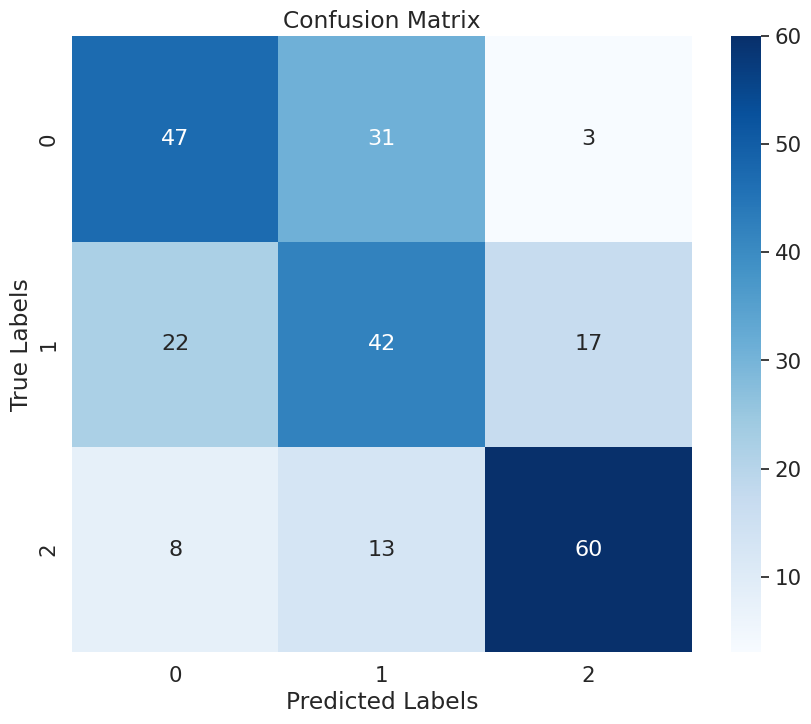

In [118]:
cm = confusion_matrix(y_test_noisy_max, y_pred_noisy_max)

# Plotting the confusion matrix
plt.figure(figsize=(10, 8))
sns.set(font_scale=1.4)  # Adjust the font scale if needed
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", annot_kws={"size": 16})

plt.title("Confusion Matrix")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()

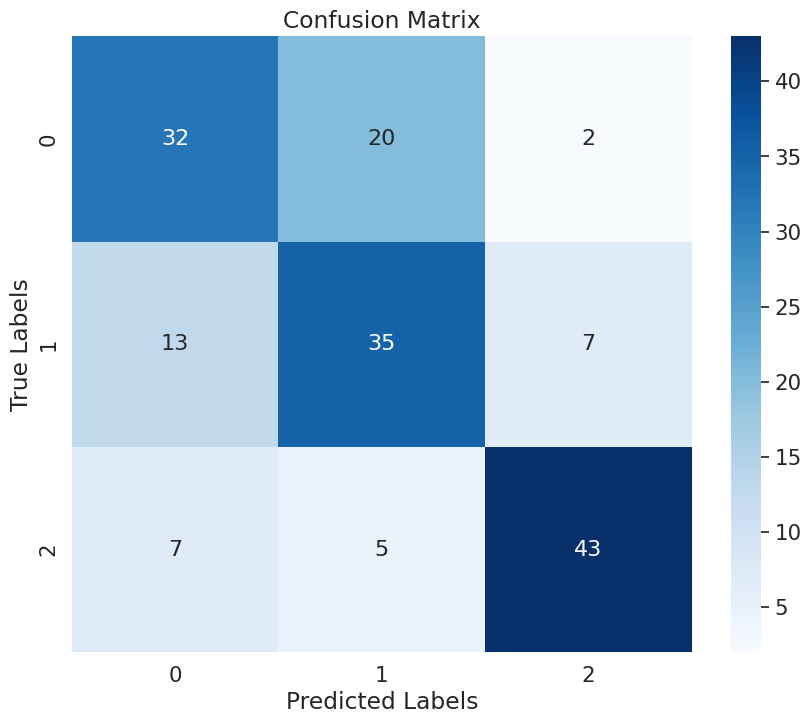

In [119]:
cm = confusion_matrix(y_test_noisy_min, y_pred_noisy_min)

# Plotting the confusion matrix
plt.figure(figsize=(10, 8))
sns.set(font_scale=1.4)  # Adjust the font scale if needed
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", annot_kws={"size": 16})

plt.title("Confusion Matrix")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()

**Hyperparameter tuning Naive Bayes**

In [120]:
import numpy as np
from sklearn.model_selection import GridSearchCV
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score

# Define the parameter grid for hyperparameter tuning
param_grid = {
    'var_smoothing': np.logspace(0,-9, num=100)  # Varying values for var_smoothing
}

# Initialize Gaussian Naive Bayes classifier
nb_classifier = GaussianNB()

# Initialize GridSearchCV with the classifier and parameter grid
grid_search = GridSearchCV(estimator=nb_classifier, param_grid=param_grid, cv=5, verbose=1, n_jobs=-1)

# Fit the GridSearchCV to the training data (noisy data with oversampling)
grid_search.fit(X_train_noisy_max, y_train_noisy_max)

# Get the best hyperparameters from the grid search
best_params_noisy_max = grid_search.best_params_
print("Best Hyperparameters for noisy data with oversampling:", best_params_noisy_max)

# Use the best hyperparameters to train the final Gaussian Naive Bayes model
best_nb_classifier = GaussianNB(**best_params_noisy_max)
best_nb_classifier.fit(X_train_noisy_max, y_train_noisy_max)

# Make predictions on the training set to evaluate training accuracy
y_train_pred_noisy_max = best_nb_classifier.predict(X_train_noisy_max)
train_accuracy_noisy_max = accuracy_score(y_train_noisy_max, y_train_pred_noisy_max)
print("Training Accuracy (noisy data with oversampling):", train_accuracy_noisy_max)

# Make predictions on the test set using the best model
y_test_pred_noisy_max = best_nb_classifier.predict(X_test_noisy_max)
test_accuracy_noisy_max = accuracy_score(y_test_noisy_max, y_test_pred_noisy_max)
print("Test Accuracy (noisy data with oversampling):", test_accuracy_noisy_max)

# Fit the GridSearchCV to the training data (noisy data with undersampling)
grid_search.fit(X_train_noisy_min, y_train_noisy_min)

# Get the best hyperparameters from the grid search
best_params_noisy_min = grid_search.best_params_
print("Best Hyperparameters for noisy data with undersampling:", best_params_noisy_min)

# Use the best hyperparameters to train the final Gaussian Naive Bayes model
best_nb_classifier = GaussianNB(**best_params_noisy_min)
best_nb_classifier.fit(X_train_noisy_min, y_train_noisy_min)

# Make predictions on the training set to evaluate training accuracy
y_train_pred_noisy_min = best_nb_classifier.predict(X_train_noisy_min)
train_accuracy_noisy_min = accuracy_score(y_train_noisy_min, y_train_pred_noisy_min)
print("Training Accuracy (noisy data with undersampling):", train_accuracy_noisy_min)

# Make predictions on the test set using the best model
y_test_pred_noisy_min = best_nb_classifier.predict(X_test_noisy_min)
test_accuracy_noisy_min = accuracy_score(y_test_noisy_min, y_test_pred_noisy_min)
print("Test Accuracy (noisy data with undersampling):", test_accuracy_noisy_min)


Fitting 5 folds for each of 100 candidates, totalling 500 fits
Best Hyperparameters for noisy data with oversampling: {'var_smoothing': 0.001873817422860383}
Training Accuracy (noisy data with oversampling): 0.6057791537667698
Test Accuracy (noisy data with oversampling): 0.6172839506172839
Fitting 5 folds for each of 100 candidates, totalling 500 fits
Best Hyperparameters for noisy data with undersampling: {'var_smoothing': 0.005336699231206307}
Training Accuracy (noisy data with undersampling): 0.5797546012269938
Test Accuracy (noisy data with undersampling): 0.6524390243902439


In [121]:
# Loop through the dataframes in the dictionary
print("the accuracy for each attribute using the noisy data with oversampling ")
for name, df in data.items():


    # Create and train the model
    model = GaussianNB(var_smoothing=0.01)
    model.fit(X_train_noisy_max, y_train_noisy_max)

    # Make predictions on the test set
    y_pred = model.predict(X_test_noisy_max)

    # Calculate and print the accuracy
    accuracy = accuracy_score(y_test_noisy_max, y_pred)
    print(f"Accuracy for {name}: {accuracy}")

the accuracy for each attribute using the noisy data with oversampling 
Accuracy for Age: 0.6131687242798354
Accuracy for SystolicBP: 0.6131687242798354
Accuracy for DiastolicBP: 0.6131687242798354
Accuracy for BS: 0.6131687242798354
Accuracy for BodyTemp: 0.6131687242798354
Accuracy for RiskLevel: 0.6131687242798354


In [122]:
# Loop through the dataframes in the dictionary
print("the accuracy for each attribute using the noisy data with undersampling ")
for name, df in data.items():


    # Create and train the model
    model = GaussianNB(var_smoothing=0.01)
    model.fit(X_train_noisy_min, y_train_noisy_min)

    # Make predictions on the test set
    y_pred = model.predict(X_test_noisy_min)

    # Calculate and print the accuracy
    accuracy = accuracy_score(y_test_noisy_min, y_pred)
    print(f"Accuracy for {name}: {accuracy}")

the accuracy for each attribute using the noisy data with undersampling 
Accuracy for Age: 0.6707317073170732
Accuracy for SystolicBP: 0.6707317073170732
Accuracy for DiastolicBP: 0.6707317073170732
Accuracy for BS: 0.6707317073170732
Accuracy for BodyTemp: 0.6707317073170732
Accuracy for RiskLevel: 0.6707317073170732


2. **Decision Tree**

In [123]:
#Create tree object
decision_tree = tree.DecisionTreeClassifier(criterion='gini', max_depth=8, random_state=42)


# Fit the decision tree  classifier to  training data
decision_tree.fit(X_train_selected_noisy_max , y_train_noisy_max)

# Make predictions on the test data
y_pred_noisy_max = decision_tree.predict(X_test_selected_noisy_max)
print("method 1 data with noise and oversamling")
# Calculate and print the accuracy for the training data
train_accuracy = accuracy_score(y_train_noisy_max, decision_tree.predict(X_train_selected_noisy_max))
print(f"Training Accuracy: {train_accuracy:.2f}")

# Calculate and print the accuracy for the test data
test_accuracy_Dt_noisy_max = accuracy_score(y_test_noisy_max, y_pred_noisy_max)
print(f"Testing Accuracy: {test_accuracy_Dt_noisy_max:.2f}")

# Generate and print a classification report
report = classification_report(y_test_noisy_max, y_pred_noisy_max)
print("Classification Report:")
lines = report.split('\n')
for line in lines:
    print(line)
print("method 2 data with noise and undersampling")


# Fit the decision tree  classifier to  training data
decision_tree.fit(X_train_selected_noisy_min , y_train_noisy_min)

# Make predictions on the test data
y_pred_noisy_min = decision_tree.predict(X_test_selected_noisy_min)
print("method 1 data with noise and oversamling")
# Calculate and print the accuracy for the training data
train_accuracy = accuracy_score(y_train_noisy_min, decision_tree.predict(X_train_selected_noisy_min))
print(f"Training Accuracy: {train_accuracy:.2f}")

# Calculate and print the accuracy for the test data
test_accuracy_Dt_noisy_min = accuracy_score(y_test_noisy_min, y_pred_noisy_min)
print(f"Testing Accuracy: {test_accuracy_Dt_noisy_min:.2f}")

# Generate and print a classification report
report = classification_report(y_test_noisy_min, y_pred_noisy_min)
print("Classification Report:")
lines = report.split('\n')
for line in lines:
    print(line)

method 1 data with noise and oversamling
Training Accuracy: 0.86
Testing Accuracy: 0.71
Classification Report:
              precision    recall  f1-score   support

         1.0       0.70      0.65      0.68        81
         2.0       0.62      0.65      0.64        81
         3.0       0.82      0.83      0.82        81

    accuracy                           0.71       243
   macro avg       0.71      0.71      0.71       243
weighted avg       0.71      0.71      0.71       243

method 2 data with noise and undersampling
method 1 data with noise and oversamling
Training Accuracy: 0.83
Testing Accuracy: 0.79
Classification Report:
              precision    recall  f1-score   support

         1.0       0.71      0.76      0.73        54
         2.0       0.74      0.67      0.70        55
         3.0       0.91      0.93      0.92        55

    accuracy                           0.79       164
   macro avg       0.79      0.79      0.79       164
weighted avg       0.79     

**Hyperparameter tuning decision tree**

In [124]:
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score

# Initialize the Decision Tree Classifier
dt_classifier = DecisionTreeClassifier(random_state=42)

# Define the hyperparameters grid for tuning
param_grid = {
    'criterion': ['gini', 'entropy'],
    'max_depth': [5, 10, 15],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Initialize Grid Search Cross-Validation
grid_search_dt = GridSearchCV(estimator=dt_classifier, param_grid=param_grid, cv=5, scoring='accuracy')

# Perform Grid Search CV to find the best hyperparameters for noisy data with oversampling
grid_search_dt.fit(X_train_selected_noisy_max, y_train_noisy_max)

# Get the best hyperparameters and model
best_dt_classifier_noisy_max = grid_search_dt.best_estimator_

# Make predictions on the training data to evaluate training accuracy
y_train_pred_dt_noisy_max = best_dt_classifier_noisy_max.predict(X_train_selected_noisy_max)
train_accuracy_dt_noisy_max = accuracy_score(y_train_noisy_max, y_train_pred_dt_noisy_max)
print("Training Accuracy (noisy data with oversampling):", train_accuracy_dt_noisy_max)

# Make predictions on the test data using the best model
y_test_pred_dt_noisy_max = best_dt_classifier_noisy_max.predict(X_test_selected_noisy_max)
test_accuracy_dt_noisy_max = accuracy_score(y_test_noisy_max, y_test_pred_dt_noisy_max)
print("Test Accuracy (noisy data with oversampling):", test_accuracy_dt_noisy_max)
print("Best Decision Tree Hyperparameters for noisy data with oversampling:", grid_search_dt.best_params_)

# Initialize Grid Search Cross-Validation for noisy data with undersampling
grid_search_dt.fit(X_train_selected_noisy_min, y_train_noisy_min)

# Get the best hyperparameters and model
best_dt_classifier_noisy_min = grid_search_dt.best_estimator_

# Make predictions on the training data to evaluate training accuracy
y_train_pred_dt_noisy_min = best_dt_classifier_noisy_min.predict(X_train_selected_noisy_min)
train_accuracy_dt_noisy_min = accuracy_score(y_train_noisy_min, y_train_pred_dt_noisy_min)
print("Training Accuracy (noisy data with undersampling):", train_accuracy_dt_noisy_min)

# Make predictions on the test data using the best model
y_test_pred_dt_noisy_min = best_dt_classifier_noisy_min.predict(X_test_selected_noisy_min)
test_accuracy_dt_noisy_min = accuracy_score(y_test_noisy_min, y_test_pred_dt_noisy_min)
print("Test Accuracy (noisy data with undersampling):", test_accuracy_dt_noisy_min)
print("Best Decision Tree Hyperparameters for noisy data with undersampling:", grid_search_dt.best_params_)


Training Accuracy (noisy data with oversampling): 0.9958720330237358
Test Accuracy (noisy data with oversampling): 0.8106995884773662
Best Decision Tree Hyperparameters for noisy data with oversampling: {'criterion': 'gini', 'max_depth': 15, 'min_samples_leaf': 1, 'min_samples_split': 2}
Training Accuracy (noisy data with undersampling): 0.9984662576687117
Test Accuracy (noisy data with undersampling): 0.8414634146341463
Best Decision Tree Hyperparameters for noisy data with undersampling: {'criterion': 'gini', 'max_depth': 15, 'min_samples_leaf': 1, 'min_samples_split': 2}


**Adaboost decision tree**

In [125]:
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score

# Initialize the base Decision Tree Classifier
base_classifier = DecisionTreeClassifier(max_depth=15, criterion='gini')

# Initialize the AdaBoost Classifier with Decision Tree as base estimator
adaboost_classifier = AdaBoostClassifier(base_estimator=base_classifier, n_estimators=100, random_state=42)

# Train the AdaBoost classifier on noisy data with oversampling
adaboost_classifier.fit(X_train_selected_noisy_max, y_train_noisy_max)

# Make predictions on the training data to evaluate training accuracy
y_train_pred_adaboost_noisy_max = adaboost_classifier.predict(X_train_selected_noisy_max)
train_accuracy_adaboost_noisy_max = accuracy_score(y_train_noisy_max, y_train_pred_adaboost_noisy_max)
print("AdaBoost Training Accuracy with Decision Tree for noisy data with oversampling:", train_accuracy_adaboost_noisy_max)

# Make predictions on the test data
y_test_pred_adaboost_noisy_max = adaboost_classifier.predict(X_test_selected_noisy_max)
test_accuracy_adaboost_noisy_max = accuracy_score(y_test_noisy_max, y_test_pred_adaboost_noisy_max)
print("AdaBoost Test Accuracy with Decision Tree for noisy data with oversampling:", test_accuracy_adaboost_noisy_max)

# Train the AdaBoost classifier on noisy data with undersampling
adaboost_classifier.fit(X_train_selected_noisy_min, y_train_noisy_min)

# Make predictions on the training data to evaluate training accuracy
y_train_pred_adaboost_noisy_min = adaboost_classifier.predict(X_train_selected_noisy_min)
train_accuracy_adaboost_noisy_min = accuracy_score(y_train_noisy_min, y_train_pred_adaboost_noisy_min)
print("AdaBoost Training Accuracy with Decision Tree for noisy data with undersampling:", train_accuracy_adaboost_noisy_min)

# Make predictions on the test data
y_test_pred_adaboost_noisy_min = adaboost_classifier.predict(X_test_selected_noisy_min)
test_accuracy_adaboost_noisy_min = accuracy_score(y_test_noisy_min, y_test_pred_adaboost_noisy_min)
print("AdaBoost Test Accuracy with Decision Tree for noisy data with undersampling:", test_accuracy_adaboost_noisy_min)


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


AdaBoost Training Accuracy with Decision Tree for noisy data with oversampling: 0.9989680082559339
AdaBoost Test Accuracy with Decision Tree for noisy data with oversampling: 0.8189300411522634


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


AdaBoost Training Accuracy with Decision Tree for noisy data with undersampling: 0.9984662576687117
AdaBoost Test Accuracy with Decision Tree for noisy data with undersampling: 0.8292682926829268


In [126]:
# Loop through the dataframes in the dictionary
print("the accuracy for each attribute using the noisy data with oversampling ")
for name, df in data.items():


    # Create and train the model
    model = tree.DecisionTreeClassifier(criterion='gini')
    model.fit(X_train_selected_noisy_max, y_train_noisy_max)

    # Make predictions on the test set
    y_pred = model.predict(X_test_selected_noisy_max)

    # Calculate and print the accuracy
    accuracy = accuracy_score(y_test_noisy_max, y_pred)
    print(f"Accuracy for {name}: {accuracy}")

the accuracy for each attribute using the noisy data with oversampling 
Accuracy for Age: 0.8148148148148148
Accuracy for SystolicBP: 0.8106995884773662
Accuracy for DiastolicBP: 0.8106995884773662
Accuracy for BS: 0.8189300411522634
Accuracy for BodyTemp: 0.823045267489712
Accuracy for RiskLevel: 0.823045267489712


In [127]:
# Loop through the dataframes in the dictionary
print("the accuracy for each attribute using the noisy data with undersampling ")
for name, df in data.items():


    # Create and train the model
    model = tree.DecisionTreeClassifier(criterion='gini')
    model.fit(X_train_selected_noisy_min, y_train_noisy_min)

    # Make predictions on the test set
    y_pred = model.predict(X_test_selected_noisy_min)

    # Calculate and print the accuracy
    accuracy = accuracy_score(y_test_noisy_min, y_pred)
    print(f"Accuracy for {name}: {accuracy}")

the accuracy for each attribute using the noisy data with undersampling 
Accuracy for Age: 0.8353658536585366
Accuracy for SystolicBP: 0.8414634146341463
Accuracy for DiastolicBP: 0.8536585365853658
Accuracy for BS: 0.823170731707317
Accuracy for BodyTemp: 0.8414634146341463
Accuracy for RiskLevel: 0.8475609756097561


**confusion matrix**

confusion matrix for noisy data with oversampling


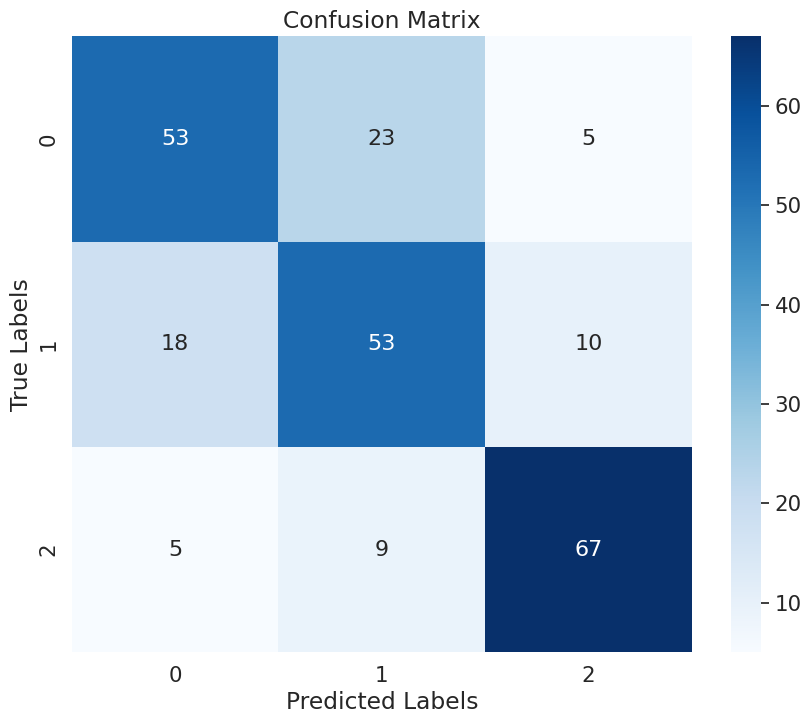

In [128]:
print("confusion matrix for noisy data with oversampling")
cm = confusion_matrix(y_test_noisy_max, y_pred_noisy_max)

# Plotting the confusion matrix
plt.figure(figsize=(10, 8))
sns.set(font_scale=1.4)  # Adjust the font scale if needed
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", annot_kws={"size": 16})

plt.title("Confusion Matrix")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()

confusion matrix for noisy data with undersampling


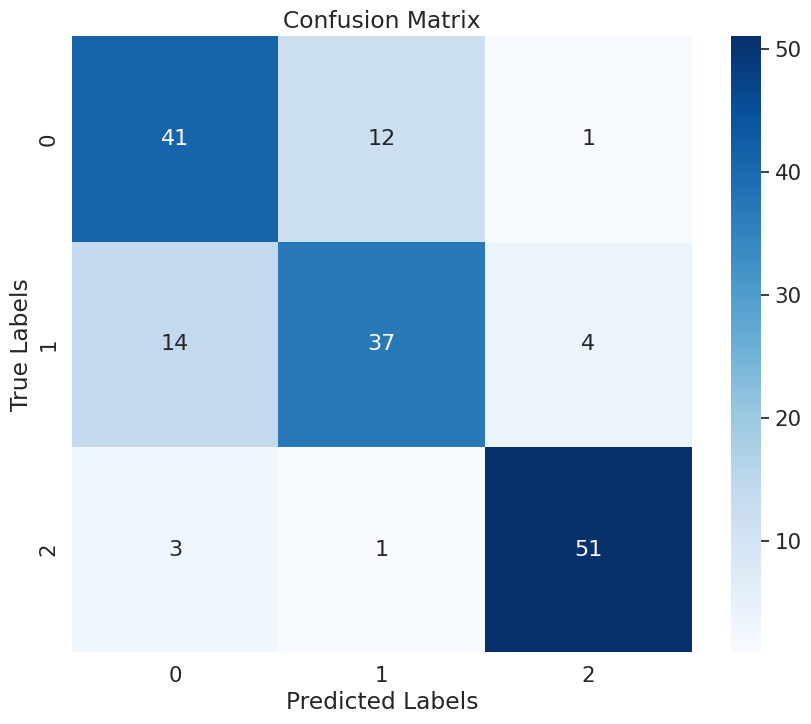

In [129]:
print("confusion matrix for noisy data with undersampling")
cm = confusion_matrix(y_test_noisy_min, y_pred_noisy_min)

# Plotting the confusion matrix
plt.figure(figsize=(10, 8))
sns.set(font_scale=1.4)  # Adjust the font scale if needed
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", annot_kws={"size": 16})

plt.title("Confusion Matrix")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()

**cross valodation decision tree**

In [130]:
# Initialize k-fold cross-validation
kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Perform cross-validation
cv_scores = cross_val_score(adaboost_classifier, X_noisy_max, y_noisy_max, cv=kf)

# Print the cross-validation scores
print("Cross-Validation Scores:", cv_scores)
print("Mean CV Score:", cv_scores.mean())
print("std CV Score:", cv_scores.std())

Cross-Validation Scores: [0.85185185 0.83950617 0.87190083 0.8553719  0.84297521]
Mean CV Score: 0.8523211917151311
std CV Score: 0.011353073139313262


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


In [131]:
# Initialize k-fold cross-validation
kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Perform cross-validation
cv_scores = cross_val_score(adaboost_classifier, X_noisy_min, y_noisy_min, cv=kf)

# Print the cross-validation scores
print("Cross-Validation Scores:", cv_scores)
print("Mean CV Score:", cv_scores.mean())
print("std CV Score:", cv_scores.std())

Cross-Validation Scores: [0.82926829 0.7791411  0.82208589 0.88343558 0.83435583]
Mean CV Score: 0.8296573395181804
std CV Score: 0.03323715836791433


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


The cross-validation results suggest that the model's performance is consistent and robust across different data splits, with an average accuracy of around 83.35% and 85% for oversampled data. The low standard deviation further supports the reliability of the model's performance. Overall, this indicates that the model is likely to generalize well to unseen data.

3.**Random forest**

In [132]:

# Initialize the Random Forest Classifier
rf_classifier = RandomForestClassifier(n_estimators=100, max_depth=6, random_state=42)

# Fit the decision tree  classifier to  training data with noise and oversampling
rf_classifier.fit(X_train_selected_noisy_max , y_train_noisy_max)

# Make predictions on the test data
y_pred_noisy_max = rf_classifier.predict(X_test_selected_noisy_max)
print("method 1 data with noise and oversamling")
# Calculate and print the accuracy for the training data
train_accuracy = accuracy_score(y_train_noisy_max, rf_classifier.predict(X_train_selected_noisy_max))
print(f"Training Accuracy: {train_accuracy:.2f}")

# Calculate and print the accuracy for the test data
test_accuracy_RF_noisy_max = accuracy_score(y_test_noisy_max, y_pred_noisy_max)
print(f"Testing Accuracy: {test_accuracy_RF_noisy_max:.2f}")

# Generate and print a classification report
report = classification_report(y_test_noisy_max, y_pred_noisy_max)
print("Classification Report:")
lines = report.split('\n')
for line in lines:
    print(line)
print("method 2 data with noise and undersampling")


# Fit the decision tree  classifier to  training data with noise and undersampling
rf_classifier.fit(X_train_selected_noisy_min , y_train_noisy_min)

# Make predictions on the test data
y_pred_noisy_min = rf_classifier.predict(X_test_selected_noisy_min)
# Calculate and print the accuracy for the training data
train_accuracy = accuracy_score(y_train_noisy_min, rf_classifier.predict(X_train_selected_noisy_min))
print(f"Training Accuracy: {train_accuracy:.2f}")

# Calculate and print the accuracy for the test data
test_accuracy_RF_noisy_min = accuracy_score(y_test_noisy_min, y_pred_noisy_min)
print(f"Testing Accuracy: {test_accuracy_RF_noisy_min:.2f}")

# Generate and print a classification report
report = classification_report(y_test_noisy_min, y_pred_noisy_min)
print("Classification Report:")
lines = report.split('\n')
for line in lines:
    print(line)

method 1 data with noise and oversamling
Training Accuracy: 0.85
Testing Accuracy: 0.74
Classification Report:
              precision    recall  f1-score   support

         1.0       0.72      0.68      0.70        81
         2.0       0.66      0.67      0.66        81
         3.0       0.82      0.86      0.84        81

    accuracy                           0.74       243
   macro avg       0.74      0.74      0.74       243
weighted avg       0.74      0.74      0.74       243

method 2 data with noise and undersampling
Training Accuracy: 0.83
Testing Accuracy: 0.77
Classification Report:
              precision    recall  f1-score   support

         1.0       0.72      0.80      0.75        54
         2.0       0.73      0.60      0.66        55
         3.0       0.86      0.93      0.89        55

    accuracy                           0.77       164
   macro avg       0.77      0.77      0.77       164
weighted avg       0.77      0.77      0.77       164



**Hyperparameter tuning random forest**

In [133]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

# Define the hyperparameters grid for tuning
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}

# Initialize Grid Search Cross-Validation for noisy data with oversampling
rf_classifier = RandomForestClassifier(random_state=42)
grid_search_rf = GridSearchCV(estimator=rf_classifier, param_grid=param_grid, cv=5, scoring='accuracy', n_jobs=-1)

# Perform Grid Search CV to find the best hyperparameters
grid_search_rf.fit(X_train_selected_noisy_max, y_train_noisy_max)

# Get the best hyperparameters and model
best_rf_classifier_noisy_max = grid_search_rf.best_estimator_

# Make predictions on the training data to evaluate training accuracy
y_train_pred_rf_noisy_max = best_rf_classifier_noisy_max.predict(X_train_selected_noisy_max)
train_accuracy_rf_noisy_max = accuracy_score(y_train_noisy_max, y_train_pred_rf_noisy_max)
print("Random Forest Training Accuracy for noisy data with oversampling:", train_accuracy_rf_noisy_max)

# Make predictions on the test data using the best model
y_test_pred_rf_noisy_max = best_rf_classifier_noisy_max.predict(X_test_selected_noisy_max)
test_accuracy_rf_noisy_max = accuracy_score(y_test_noisy_max, y_test_pred_rf_noisy_max)
print("Random Forest Test Accuracy for noisy data with oversampling:", test_accuracy_rf_noisy_max)
print("Best Random Forest Hyperparameters for noisy data with oversampling:", grid_search_rf.best_params_)


Random Forest Training Accuracy for noisy data with oversampling: 0.9989680082559339
Random Forest Test Accuracy for noisy data with oversampling: 0.8106995884773662
Best Random Forest Hyperparameters for noisy data with oversampling: {'bootstrap': False, 'max_depth': 20, 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 200}


In [134]:
# Initialize Grid Search Cross-Validation for noisy data with undersampling
grid_search_rf.fit(X_train_selected_noisy_min, y_train_noisy_min)

# Get the best hyperparameters and model
best_rf_classifier_noisy_min = grid_search_rf.best_estimator_

# Make predictions on the training data to evaluate training accuracy
y_train_pred_rf_noisy_min = best_rf_classifier_noisy_min.predict(X_train_selected_noisy_min)
train_accuracy_rf_noisy_min = accuracy_score(y_train_noisy_min, y_train_pred_rf_noisy_min)
print("Random Forest Training Accuracy for noisy data with undersampling:", train_accuracy_rf_noisy_min)

# Make predictions on the test data using the best model
y_test_pred_rf_noisy_min = best_rf_classifier_noisy_min.predict(X_test_selected_noisy_min)
test_accuracy_rf_noisy_min = accuracy_score(y_test_noisy_min, y_test_pred_rf_noisy_min)
print("Random Forest Test Accuracy for noisy data with undersampling:", test_accuracy_rf_noisy_min)
print("Best Random Forest Hyperparameters for noisy data with undersampling:", grid_search_rf.best_params_)


Random Forest Training Accuracy for noisy data with undersampling: 0.9984662576687117
Random Forest Test Accuracy for noisy data with undersampling: 0.8597560975609756
Best Random Forest Hyperparameters for noisy data with undersampling: {'bootstrap': True, 'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 200}


**Adaboost Random forest**

In [135]:
from sklearn.ensemble import AdaBoostClassifier, RandomForestClassifier
from sklearn.metrics import accuracy_score

# Initialize the base Random Forest Classifier
base_classifier = RandomForestClassifier(n_estimators=100, random_state=42)

# Initialize the AdaBoost Classifier with Random Forest as base estimator
adaboost_classifier = AdaBoostClassifier(base_estimator=base_classifier, n_estimators=100, random_state=42)

# Train the AdaBoost classifier on noisy data with oversampling
adaboost_classifier.fit(X_train_selected_noisy_max, y_train_noisy_max)

# Make predictions on the training data to evaluate training accuracy
y_train_pred_adaboost_noisy_max = adaboost_classifier.predict(X_train_selected_noisy_max)
train_accuracy_adaboost_noisy_max = accuracy_score(y_train_noisy_max, y_train_pred_adaboost_noisy_max)
print("AdaBoost Training Accuracy with Random Forest for noisy data with oversampling:", train_accuracy_adaboost_noisy_max)

# Make predictions on the test data
y_test_pred_adaboost_noisy_max = adaboost_classifier.predict(X_test_selected_noisy_max)
test_accuracy_adaboost_noisy_max = accuracy_score(y_test_noisy_max, y_test_pred_adaboost_noisy_max)
print("AdaBoost Test Accuracy with Random Forest for noisy data with oversampling:", test_accuracy_adaboost_noisy_max)

# Train the AdaBoost classifier on noisy data with undersampling
adaboost_classifier.fit(X_train_selected_noisy_min, y_train_noisy_min)

# Make predictions on the training data to evaluate training accuracy
y_train_pred_adaboost_noisy_min = adaboost_classifier.predict(X_train_selected_noisy_min)
train_accuracy_adaboost_noisy_min = accuracy_score(y_train_noisy_min, y_train_pred_adaboost_noisy_min)
print("AdaBoost Training Accuracy with Random Forest for noisy data with undersampling:", train_accuracy_adaboost_noisy_min)

# Make predictions on the test data
y_test_pred_adaboost_noisy_min = adaboost_classifier.predict(X_test_selected_noisy_min)
test_accuracy_adaboost_noisy_min = accuracy_score(y_test_noisy_min, y_test_pred_adaboost_noisy_min)
print("AdaBoost Test Accuracy with Random Forest for noisy data with undersampling:", test_accuracy_adaboost_noisy_min)


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


AdaBoost Training Accuracy with Random Forest for noisy data with oversampling: 0.9989680082559339
AdaBoost Test Accuracy with Random Forest for noisy data with oversampling: 0.823045267489712


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


AdaBoost Training Accuracy with Random Forest for noisy data with undersampling: 0.9984662576687117
AdaBoost Test Accuracy with Random Forest for noisy data with undersampling: 0.8536585365853658


In [138]:
# Loop through the dataframes in the dictionary
print("the accuracy for each attribute using the noisy data with oversampling ")
for name, df in data.items():


    # Create and train the model
    model = RandomForestClassifier(n_estimators=100, random_state=42)
    model.fit(X_train_selected_noisy_max, y_train_noisy_max)

    # Make predictions on the test set
    y_pred = model.predict(X_test_selected_noisy_max)

    # Calculate and print the accuracy
    accuracy = accuracy_score(y_test_noisy_max, y_pred)
    print(f"Accuracy for {name}: {accuracy}")

the accuracy for each attribute using the noisy data with oversampling 
Accuracy for Age: 0.8271604938271605
Accuracy for SystolicBP: 0.8271604938271605
Accuracy for DiastolicBP: 0.8271604938271605
Accuracy for BS: 0.8271604938271605
Accuracy for BodyTemp: 0.8271604938271605
Accuracy for RiskLevel: 0.8271604938271605


In [139]:
# Loop through the dataframes in the dictionary
print("the accuracy for each attribute using the noisy data with undersampling ")
for name, df in data.items():


    # Create and train the model
    model = RandomForestClassifier(n_estimators=100, random_state=42)
    model.fit(X_train_selected_noisy_min, y_train_noisy_min)

    # Make predictions on the test set
    y_pred = model.predict(X_test_selected_noisy_min)

    # Calculate and print the accuracy
    accuracy = accuracy_score(y_test_noisy_min, y_pred)
    print(f"Accuracy for {name}: {accuracy}")

the accuracy for each attribute using the noisy data with undersampling 
Accuracy for Age: 0.8597560975609756
Accuracy for SystolicBP: 0.8597560975609756
Accuracy for DiastolicBP: 0.8597560975609756
Accuracy for BS: 0.8597560975609756
Accuracy for BodyTemp: 0.8597560975609756
Accuracy for RiskLevel: 0.8597560975609756


**confusion matrix**

confusion matrix for noisy data with oversampling


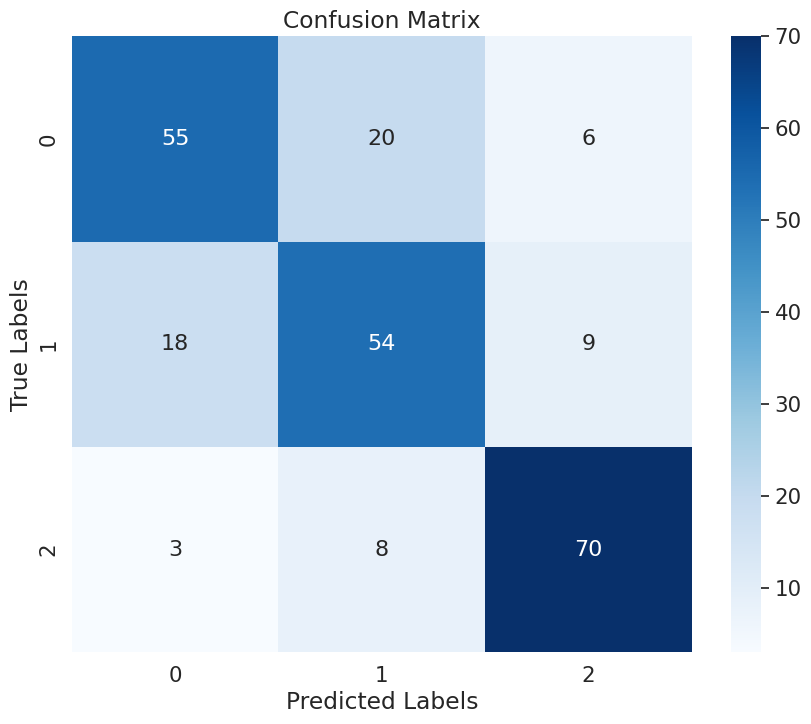

In [140]:
print("confusion matrix for noisy data with oversampling")
cm = confusion_matrix(y_test_noisy_max, y_pred_noisy_max)

# Plotting the confusion matrix
plt.figure(figsize=(10, 8))
sns.set(font_scale=1.4)  # Adjust the font scale if needed
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", annot_kws={"size": 16})

plt.title("Confusion Matrix")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()

confusion matrix for noisy data with undersampling


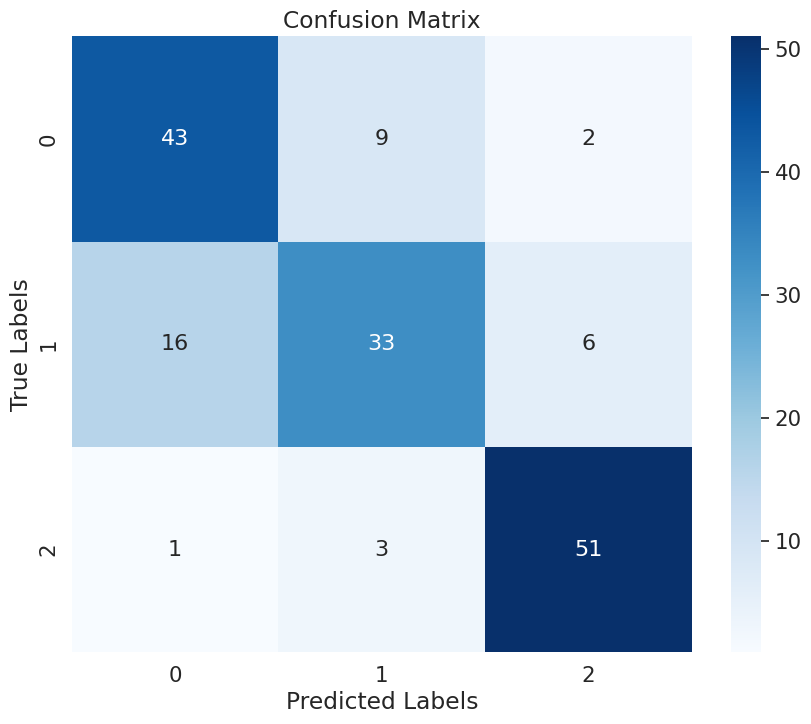

In [141]:
print("confusion matrix for noisy data with undersampling")
cm = confusion_matrix(y_test_noisy_min, y_pred_noisy_min)

# Plotting the confusion matrix
plt.figure(figsize=(10, 8))
sns.set(font_scale=1.4)  # Adjust the font scale if needed
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", annot_kws={"size": 16})

plt.title("Confusion Matrix")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()

**K-Nearest Neighbors (KNN)**

In [142]:
# Create the scaler object
scaler = MinMaxScaler()

# Normalize the training and testing data
X_train_normalized_noisy_max = scaler.fit_transform(X_train_selected_noisy_max)
X_test_normalized_noisy_max = scaler.transform(X_test_selected_noisy_max)
X_train_normalized_noisy_min = scaler.fit_transform(X_train_selected_noisy_min)
X_test_normalized_noisy_min = scaler.transform(X_test_selected_noisy_min)
# Initialize the KNN Classifier
knn_classifier = KNeighborsClassifier(n_neighbors=5)  # You can adjust the number of neighbors (k)

print("noisy data with oversampling ")
# Fit the classifier to your training data (normalized)
knn_classifier.fit(X_train_normalized_noisy_max, y_train_noisy_max)
# Make predictions on the test data
y_pred_knn = knn_classifier.predict(X_test_normalized_noisy_max)

# Calculate and print the accuracy for the training data
train_accuracy_knn = accuracy_score(y_train_noisy_max, knn_classifier.predict(X_train_normalized_noisy_max ))
print(f"Training Accuracy: {train_accuracy_knn:.2f}")

# Calculate and print the accuracy for the test data
test_accuracy_knn_noisy_max = accuracy_score(y_test_noisy_max, y_pred_knn)
print(f"Testing Accuracy: {test_accuracy_knn_noisy_max:.2f}")

# Generate and print a classification report
report = classification_report(y_test_noisy_max, y_pred_knn)
print("Classification Report:")
lines = report.split('\n')
for line in lines:
    print(line)

print("noisy data with undersampling ")



print("noisy data with oversampling ")
# Fit the classifier to your training data (normalized)
knn_classifier.fit(X_train_normalized_noisy_min, y_train_noisy_min)
# Make predictions on the test data
y_pred_knn = knn_classifier.predict(X_test_normalized_noisy_min)

# Calculate and print the accuracy for the training data
train_accuracy_knn = accuracy_score(y_train_noisy_min, knn_classifier.predict(X_train_normalized_noisy_min ))
print(f"Training Accuracy: {train_accuracy_knn:.2f}")

# Calculate and print the accuracy for the test data
test_accuracy_knn_noisy_min = accuracy_score(y_test_noisy_min, y_pred_knn)
print(f"Testing Accuracy: {test_accuracy_knn_noisy_min:.2f}")

# Generate and print a classification report
report = classification_report(y_test_noisy_min, y_pred_knn)
print("Classification Report:")
lines = report.split('\n')
for line in lines:
    print(line)

noisy data with oversampling 
Training Accuracy: 0.84
Testing Accuracy: 0.70
Classification Report:
              precision    recall  f1-score   support

         1.0       0.72      0.74      0.73        81
         2.0       0.60      0.58      0.59        81
         3.0       0.78      0.79      0.79        81

    accuracy                           0.70       243
   macro avg       0.70      0.70      0.70       243
weighted avg       0.70      0.70      0.70       243

noisy data with undersampling 
noisy data with oversampling 
Training Accuracy: 0.81
Testing Accuracy: 0.74
Classification Report:
              precision    recall  f1-score   support

         1.0       0.70      0.72      0.71        54
         2.0       0.68      0.62      0.65        55
         3.0       0.84      0.89      0.87        55

    accuracy                           0.74       164
   macro avg       0.74      0.74      0.74       164
weighted avg       0.74      0.74      0.74       164



**Hyperparameter Tuning with GridSearchCV for the KNN:**

In [143]:
from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import StandardScaler

# Normalize the data
scaler = StandardScaler()
X_train_normalized_noisy_max = scaler.fit_transform(X_train_noisy_max)
X_test_normalized_noisy_max = scaler.transform(X_test_noisy_max)
X_train_normalized_noisy_min = scaler.fit_transform(X_train_noisy_min)
X_test_normalized_noisy_min = scaler.transform(X_test_noisy_min)

# Define the hyperparameters grid for tuning
param_grid = {
    'n_neighbors': [3, 5, 7, 9, 11]
}

# Initialize KNN classifier
knn_classifier = KNeighborsClassifier()

# Initialize Grid Search Cross-Validation for noisy data with oversampling
grid_search_knn = GridSearchCV(estimator=knn_classifier, param_grid=param_grid, cv=5, scoring='accuracy')

# Perform Grid Search CV using the normalized training data with oversampling
grid_search_knn.fit(X_train_normalized_noisy_max, y_train_noisy_max)

# Get the best hyperparameters and model for oversampling
best_knn_classifier_noisy_max = grid_search_knn.best_estimator_

# Make predictions on the training data to evaluate training accuracy
y_train_pred_knn_noisy_max = best_knn_classifier_noisy_max.predict(X_train_normalized_noisy_max)
train_accuracy_knn_noisy_max = accuracy_score(y_train_noisy_max, y_train_pred_knn_noisy_max)
print("KNN Training Accuracy for noisy data with oversampling:", train_accuracy_knn_noisy_max)

# Make predictions on the test data using the best model
y_test_pred_knn_noisy_max = best_knn_classifier_noisy_max.predict(X_test_normalized_noisy_max)
test_accuracy_knn_noisy_max = accuracy_score(y_test_noisy_max, y_test_pred_knn_noisy_max)
print("KNN Test Accuracy for noisy data with oversampling:", test_accuracy_knn_noisy_max)
print("Best KNN Hyperparameters for noisy data with oversampling:", grid_search_knn.best_params_)

# Perform Grid Search CV using the normalized training data with undersampling
grid_search_knn.fit(X_train_normalized_noisy_min, y_train_noisy_min)

# Get the best hyperparameters and model for undersampling
best_knn_classifier_noisy_min = grid_search_knn.best_estimator_

# Make predictions on the training data to evaluate training accuracy
y_train_pred_knn_noisy_min = best_knn_classifier_noisy_min.predict(X_train_normalized_noisy_min)
train_accuracy_knn_noisy_min = accuracy_score(y_train_noisy_min, y_train_pred_knn_noisy_min)
print("KNN Training Accuracy for noisy data with undersampling:", train_accuracy_knn_noisy_min)

# Make predictions on the test data using the best model
y_test_pred_knn_noisy_min = best_knn_classifier_noisy_min.predict(X_test_normalized_noisy_min)
test_accuracy_knn_noisy_min = accuracy_score(y_test_noisy_min, y_test_pred_knn_noisy_min)
print("KNN Test Accuracy for noisy data with undersampling:", test_accuracy_knn_noisy_min)
print("Best KNN Hyperparameters for noisy data with undersampling:", grid_search_knn.best_params_)


KNN Training Accuracy for noisy data with oversampling: 0.9164086687306502
KNN Test Accuracy for noisy data with oversampling: 0.757201646090535
Best KNN Hyperparameters for noisy data with oversampling: {'n_neighbors': 3}
KNN Training Accuracy for noisy data with undersampling: 0.8880368098159509
KNN Test Accuracy for noisy data with undersampling: 0.774390243902439
Best KNN Hyperparameters for noisy data with undersampling: {'n_neighbors': 3}


In [144]:
# Create a VotingClassifier object
ensemble_model = VotingClassifier(estimators=[
    ('knn', knn_classifier),
    ('rf', rf_classifier)

], voting='hard')  # You can choose 'hard' or 'soft' voting
# Train the ensemble model on the normalized training data
ensemble_model.fit(X_train_normalized_noisy_max, y_train_noisy_max)

# Make predictions on the normalized testing data
y_pred_ensemble_max = ensemble_model.predict(X_test_normalized_noisy_max)

# Evaluate the model's accuracy
accuracy_ensemble = accuracy_score(y_test_noisy_max, y_pred_ensemble_max)
print("Ensemble Model Accuracy for noisy data with oversampling :", accuracy_ensemble)


# Train the ensemble model on the normalized training data
ensemble_model.fit(X_train_normalized_noisy_min, y_train_noisy_min)

# Make predictions on the normalized testing data
y_pred_ensemble_min = ensemble_model.predict(X_test_normalized_noisy_min)

# Evaluate the model's accuracy
accuracy_ensemble = accuracy_score(y_test_noisy_min, y_pred_ensemble_min)
print("Ensemble Model Accuracy for noisy data with undersampling", accuracy_ensemble)



Ensemble Model Accuracy for noisy data with oversampling : 0.7818930041152263
Ensemble Model Accuracy for noisy data with undersampling 0.8414634146341463


**confusion matrix**

confusion matrix for noisy data with oversampling
KNN Test Accuracy: 0.7818930041152263


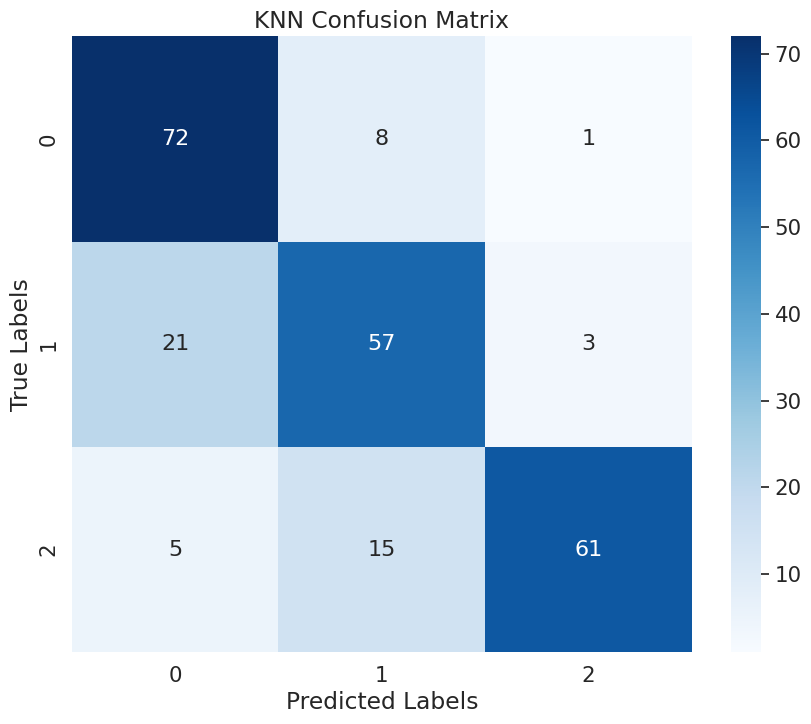

In [145]:
print("confusion matrix for noisy data with oversampling")
# Make predictions on the test data using the KNN model


# Evaluate the KNN model's accuracy
accuracy_knn = accuracy_score(y_test_noisy_max, y_pred_ensemble_max)
print("KNN Test Accuracy:", accuracy_knn)

# Generate and print the confusion matrix for the KNN model
cm_knn = confusion_matrix(y_test_noisy_max, y_pred_ensemble_max)

# Plotting the confusion matrix for KNN
plt.figure(figsize=(10, 8))
sns.set(font_scale=1.4)  # Adjust the font scale if needed
sns.heatmap(cm_knn, annot=True, fmt="d", cmap="Blues", annot_kws={"size": 16})

plt.title("KNN Confusion Matrix")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()


confusion matrix for noisy data with undersampling
KNN Test Accuracy: 0.8414634146341463


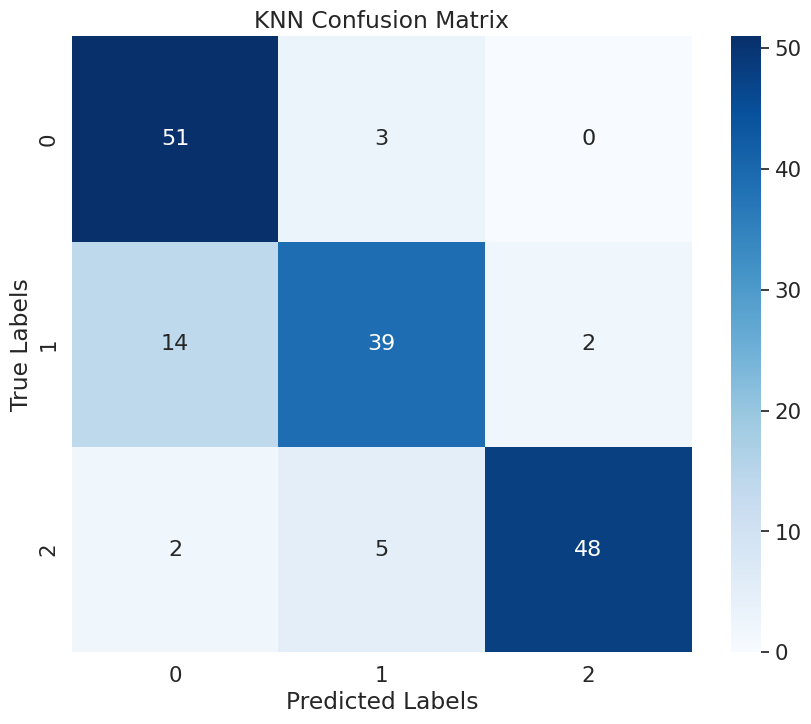

In [146]:
print("confusion matrix for noisy data with undersampling")
# Make predictions on the test data using the KNN model


# Evaluate the KNN model's accuracy
accuracy_knn = accuracy_score(y_test_noisy_min, y_pred_ensemble_min)
print("KNN Test Accuracy:", accuracy_knn)

# Generate and print the confusion matrix for the KNN model
cm_knn = confusion_matrix(y_test_noisy_min, y_pred_ensemble_min)

# Plotting the confusion matrix for KNN
plt.figure(figsize=(10, 8))
sns.set(font_scale=1.4)  # Adjust the font scale if needed
sns.heatmap(cm_knn, annot=True, fmt="d", cmap="Blues", annot_kws={"size": 16})

plt.title("KNN Confusion Matrix")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()


In [147]:
# Initialize k-fold cross-validation
kf = KFold(n_splits=5, shuffle=True, random_state=42)
print("cross validation for noisy data with oversampling")
# Perform cross-validation
cv_scores = cross_val_score(knn_classifier, X_train_normalized_noisy_max, y_train_noisy_max, cv=kf)
# Print the cross-validation scores
print("Cross-Validation Scores:", cv_scores)
print("Mean CV Score:", cv_scores.mean())
print("std CV Score:", cv_scores.std())

print("cross validation for noisy data with undersampling")
# Perform cross-validation
cv_scores = cross_val_score(knn_classifier, X_train_normalized_noisy_min, y_train_noisy_min, cv=kf)
# Print the cross-validation scores
print("Cross-Validation Scores:", cv_scores)
print("Mean CV Score:", cv_scores.mean())
print("std CV Score:", cv_scores.std())


cross validation for noisy data with oversampling
Cross-Validation Scores: [0.75773196 0.7371134  0.74226804 0.7371134  0.69948187]
Mean CV Score: 0.734741733881737
std CV Score: 0.01918178143899873
cross validation for noisy data with undersampling
Cross-Validation Scores: [0.69465649 0.64122137 0.64615385 0.71538462 0.75384615]
Mean CV Score: 0.6902524955960071
std CV Score: 0.04252978657772575


**SVM**

**PCA only 2 principle componenets to plot the data and see the distribution**

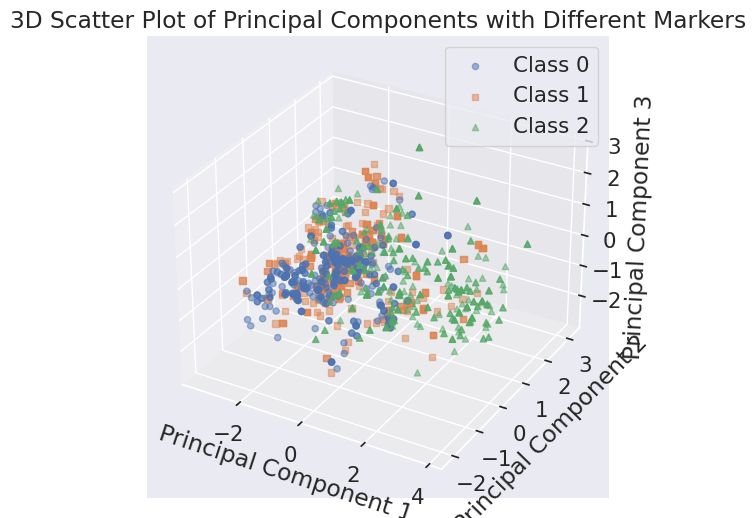

In [148]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Assuming 'X' is your data and 'y' is your target labels

# Step 1: Data Preprocessing
scaler = StandardScaler()
X_scaled_noisy_max = scaler.fit_transform(X_noisy_max)

# Step 2: Perform PCA
pca = PCA(n_components=3)
X_pca = pca.fit_transform(X_scaled_noisy_max)

# Separate data by class
class_0 = X_pca[y_noisy_max == 1]
class_1 = X_pca[y_noisy_max == 2]
class_2 = X_pca[y_noisy_max == 3]

# Plot the 3D scatter plot with different markers for each class
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(class_0[:, 0], class_0[:, 1], class_0[:, 2], marker='o', label='Class 0', alpha=0.5)
ax.scatter(class_1[:, 0], class_1[:, 1], class_1[:, 2], marker='s', label='Class 1', alpha=0.5)
ax.scatter(class_2[:, 0], class_2[:, 1], class_2[:, 2], marker='^', label='Class 2', alpha=0.5)

ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')
ax.set_zlabel('Principal Component 3')
ax.set_title('3D Scatter Plot of Principal Components with Different Markers')
ax.legend()
plt.show()

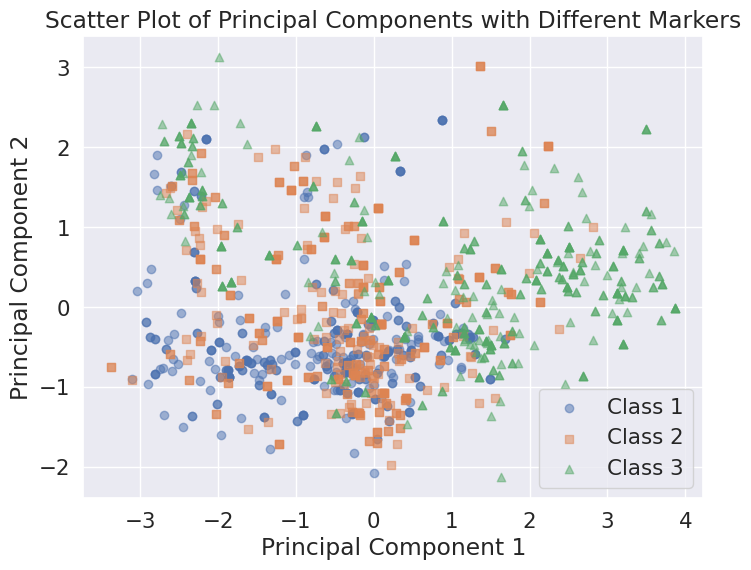

In [149]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Assuming 'X' is your data and 'y' is your target labels

# Step 1: Data Preprocessing
scaler = StandardScaler()
X_scaled_noisy_max = scaler.fit_transform(X_noisy_max)

# Step 2: Perform PCA
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled_noisy_max)

# Separate data by class
class_0 = X_pca[y_noisy_max == 1]
class_1 = X_pca[y_noisy_max == 2]
class_2 = X_pca[y_noisy_max == 3]

# Plot the scatter plot with different markers for each class
plt.figure(figsize=(8, 6))
plt.scatter(class_0[:, 0], class_0[:, 1], marker='o', label='Class 1', alpha=0.5)
plt.scatter(class_1[:, 0], class_1[:, 1], marker='s', label='Class 2', alpha=0.5)
plt.scatter(class_2[:, 0], class_2[:, 1], marker='^', label='Class 3', alpha=0.5)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('Scatter Plot of Principal Components with Different Markers')
plt.legend()
plt.grid(True)
plt.show()

In [150]:
# Create a pipeline with normalization and SVM classifier
svm_pipeline = Pipeline([
    ('scaler', StandardScaler()),  # Normalization
    ('svm', SVC())  # Support Vector Machine classifier
])

print("svm for noisy data and oversampling")
# Fit the pipeline to the training data
svm_pipeline.fit(X_train_noisy_max, y_train_noisy_max)

# Evaluate the model
accuracy = svm_pipeline.score(X_train_noisy_max, y_train_noisy_max)
print("training Accuracy:", accuracy)

accuracy_noisy_max = svm_pipeline.score(X_test_noisy_max, y_test_noisy_max)
print("Accuracy:", accuracy_noisy_max)

# Generate and print a classification report

print("Classification Report:")
lines = report.split('\n')
for line in lines:
    print(line)



print("svm for noisy data and undersampling")

# Fit the pipeline to the training data
svm_pipeline.fit(X_train_noisy_min, y_train_noisy_min)

# Evaluate the model
accuracy = svm_pipeline.score(X_train_noisy_min, y_train_noisy_min)
print("training Accuracy:", accuracy)

accuracy_noisy_min = svm_pipeline.score(X_test_noisy_min, y_test_noisy_min)
print("Accuracy:", accuracy_noisy_min)

# Generate and print a classification report
report = classification_report(y_test_noisy_min, y_pred)
print("Classification Report:")
lines = report.split('\n')
for line in lines:
    print(line)

svm for noisy data and oversampling
training Accuracy: 0.7564499484004128
Accuracy: 0.691358024691358
Classification Report:
              precision    recall  f1-score   support

         1.0       0.70      0.72      0.71        54
         2.0       0.68      0.62      0.65        55
         3.0       0.84      0.89      0.87        55

    accuracy                           0.74       164
   macro avg       0.74      0.74      0.74       164
weighted avg       0.74      0.74      0.74       164

svm for noisy data and undersampling
training Accuracy: 0.7177914110429447
Accuracy: 0.774390243902439
Classification Report:
              precision    recall  f1-score   support

         1.0       0.81      0.87      0.84        54
         2.0       0.87      0.71      0.78        55
         3.0       0.90      1.00      0.95        55

    accuracy                           0.86       164
   macro avg       0.86      0.86      0.86       164
weighted avg       0.86      0.86      0.8

**Cross Validation for SVM**

In [151]:
# Initialize k-fold cross-validation
kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Perform cross-validation
cv_scores = cross_val_score(svm_pipeline, X_noisy_max, y_noisy_max, cv=kf)

# Print the cross-validation scores
print("Cross-Validation Scores:", cv_scores)
print("Mean CV Score:", cv_scores.mean())
print("std CV Score:", cv_scores.std())

Cross-Validation Scores: [0.68312757 0.73251029 0.70661157 0.71900826 0.72727273]
Mean CV Score: 0.7137060844131551
std CV Score: 0.017613304848353866


In [152]:
# Initialize k-fold cross-validation
kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Perform cross-validation
cv_scores = cross_val_score(svm_pipeline, X_noisy_min, y_noisy_min, cv=kf)

# Print the cross-validation scores
print("Cross-Validation Scores:", cv_scores)
print("Mean CV Score:", cv_scores.mean())
print("std CV Score:", cv_scores.std())

Cross-Validation Scores: [0.65853659 0.6809816  0.63190184 0.69325153 0.73006135]
Mean CV Score: 0.6789465808768517
std CV Score: 0.03301898867392441


**hyper parameter tuning for SVM using grid search**

In [153]:
from sklearn.svm import SVC
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score

# Create a pipeline with StandardScaler and SVM
svm_pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('svm', SVC())
])

# Define the parameter grid for GridSearchCV
param_grid = {
    'svm__C': [0.1, 1, 10, 100],
    'svm__gamma': [1, 0.1, 0.01, 0.001],
    'svm__kernel': ['rbf', 'linear', 'poly', 'sigmoid']
}

# Grid search for oversampled data
grid_search_oversampled = GridSearchCV(svm_pipeline, param_grid, cv=5, n_jobs=-1, verbose=1)
grid_search_oversampled.fit(X_train_noisy_max, y_train_noisy_max)

# Best parameters and score for oversampled data
print("Best parameters for noisy data with oversampling:", grid_search_oversampled.best_params_)
print("Best score for noisy data with oversampling:", grid_search_oversampled.best_score_)

# Best SVM model for oversampled data
best_svm_oversampled = grid_search_oversampled.best_estimator_

# Predictions and accuracy for oversampled data
y_train_pred_oversampled = best_svm_oversampled.predict(X_train_noisy_max)
y_test_pred_oversampled = best_svm_oversampled.predict(X_test_noisy_max)
train_accuracy_oversampled = accuracy_score(y_train_noisy_max, y_train_pred_oversampled)
test_accuracy_oversampled = accuracy_score(y_test_noisy_max, y_test_pred_oversampled)
print("Training Accuracy for noisy data with oversampling:", train_accuracy_oversampled)
print("Test Accuracy for noisy data with oversampling:", test_accuracy_oversampled)

# Grid search for undersampled data
grid_search_undersampled = GridSearchCV(svm_pipeline, param_grid, cv=5, n_jobs=-1, verbose=1)
grid_search_undersampled.fit(X_train_noisy_min, y_train_noisy_min)

# Best parameters and score for undersampled data
print("Best parameters for noisy data with undersampling:", grid_search_undersampled.best_params_)
print("Best score for noisy data with undersampling:", grid_search_undersampled.best_score_)

# Best SVM model for undersampled data
best_svm_undersampled = grid_search_undersampled.best_estimator_

# Predictions and accuracy for undersampled data
y_train_pred_undersampled = best_svm_undersampled.predict(X_train_noisy_min)
y_test_pred_undersampled = best_svm_undersampled.predict(X_test_noisy_min)
train_accuracy_undersampled = accuracy_score(y_train_noisy_min, y_train_pred_undersampled)
test_accuracy_undersampled = accuracy_score(y_test_noisy_min, y_test_pred_undersampled)
print("Training Accuracy for noisy data with undersampling:", train_accuracy_undersampled)
print("Test Accuracy for noisy data with undersampling:", test_accuracy_undersampled)


Fitting 5 folds for each of 64 candidates, totalling 320 fits
Best parameters for noisy data with oversampling: {'svm__C': 100, 'svm__gamma': 1, 'svm__kernel': 'rbf'}
Best score for noisy data with oversampling: 0.8441910154372095
Training Accuracy for noisy data with oversampling: 0.9752321981424149
Test Accuracy for noisy data with oversampling: 0.7901234567901234
Fitting 5 folds for each of 64 candidates, totalling 320 fits
Best parameters for noisy data with undersampling: {'svm__C': 100, 'svm__gamma': 1, 'svm__kernel': 'rbf'}
Best score for noisy data with undersampling: 0.7791661773341163
Training Accuracy for noisy data with undersampling: 0.9846625766871165
Test Accuracy for noisy data with undersampling: 0.7804878048780488


In [154]:
best_model1 = grid_search.best_estimator_
print(best_model1)

GaussianNB(var_smoothing=0.005336699231206307)


In [155]:

# Grid search
grid_search = GridSearchCV(svm_pipeline, param_grid, cv=5)
grid_search.fit(X_train_noisy_min, y_train_noisy_min)

# Best parameters and best score
print("Best parameters for noisy data with undersampling:", grid_search.best_params_)
print("Best score for noisy data with undersampling :", grid_search.best_score_)

Best parameters for noisy data with undersampling: {'svm__C': 100, 'svm__gamma': 1, 'svm__kernel': 'rbf'}
Best score for noisy data with undersampling : 0.7791661773341163


In [156]:
best_model2 = grid_search.best_estimator_
print(best_model2)

Pipeline(steps=[('scaler', StandardScaler()), ('svm', SVC(C=100, gamma=1))])


**Confusion Matrix**

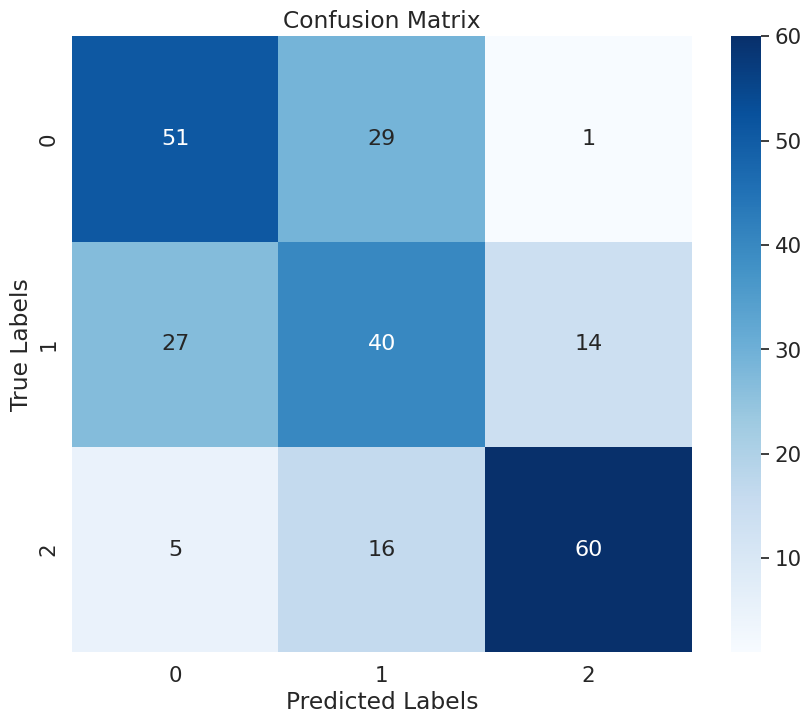

In [157]:
y_pred=best_model1.predict(X_test_noisy_max)
cm = confusion_matrix(y_test_noisy_max, y_pred)

# Plotting the confusion matrix
plt.figure(figsize=(10, 8))
sns.set(font_scale=1.4)  # Adjust the font scale if needed
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", annot_kws={"size": 16})

plt.title("Confusion Matrix")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()

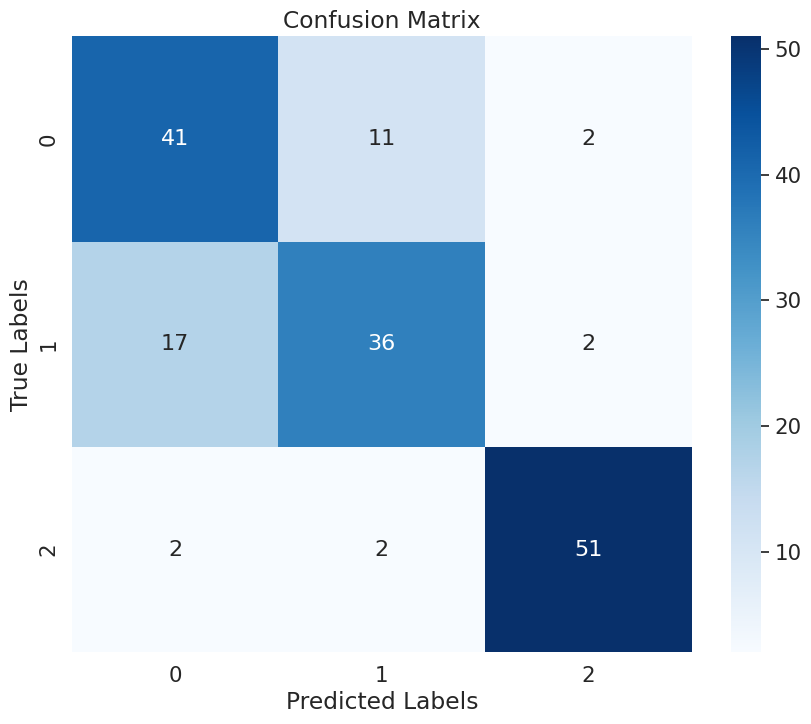

In [158]:
y_pred=best_model2.predict(X_test_noisy_min)
cm = confusion_matrix(y_test_noisy_min, y_pred)

# Plotting the confusion matrix
plt.figure(figsize=(10, 8))
sns.set(font_scale=1.4)  # Adjust the font scale if needed
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", annot_kws={"size": 16})

plt.title("Confusion Matrix")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()

**ensemble models using svm models**

In [163]:
from sklearn.feature_selection import SelectKBest, mutual_info_classif
import numpy as np

class ensemble:

    def __init__(self, n_estimators=10):
        self.n_estimators = n_estimators

    def fit(self, X, y):

        n_samples = X.shape[0]
        sample_weights = np.ones(n_samples) / n_samples

        self.learners = []
        self.learner_weights = []
        self.meta_learner = SVC()
        self.selected_indices = None

        for i in range(self.n_estimators):
            learner = SVC(C=100, gamma=1, kernel='rbf')

            learner.fit(X, y, sample_weight=sample_weights)

            y_pred = learner.predict(X)
            misclassified_indices = np.where(y_pred != y)[0]

            error_rate = np.sum(sample_weights * (y_pred != y)) / np.sum(sample_weights)
            learner_weight = 0.5 * np.log((1 - error_rate) / (error_rate + 1e-10))

            # Replace NaN values in sample_weights with zeros
            sample_weights[np.isnan(sample_weights)] = 0

            # Update weights
            sample_weights = sample_weights * np.exp(
                np.where(y == y_pred, 1 / (2 * (1 - error_rate)), (error_rate / (2 * (1 - error_rate) ** 2)))
            )

            # Normalize weights
            sample_weights /= np.sum(sample_weights)

            self.learners.append(learner)
            self.learner_weights.append(learner_weight)

        predictions = []
        for learner in self.learners:
            pred = learner.predict(X)
            predictions.append(pred.reshape(-1, 1))
        stacked_predictions = np.hstack(predictions)
        self.meta_learner.fit(stacked_predictions, y)

        return self

    def predict(self, X):
        predictions = []

        for learner, learner_weight in zip(self.learners, self.learner_weights):
            pred = learner.predict(X)
            predictions.append(pred.reshape(-1, 1))

        stacked_predictions = np.hstack(predictions)
        y_meta_pred = self.meta_learner.predict(stacked_predictions)
        return y_meta_pred

In [164]:
ensemblemax =ensemble(n_estimators=10)
ensemblemax.fit(X_train_noisy_max,y_train_noisy_max)

In [165]:
#Compute the accuracy of the model
from sklearn.metrics import accuracy_score


y_test_hat = ensemblemax.predict(X_test_noisy_max)
accuracy=accuracy_score(y_test_noisy_max,y_test_hat)


y_train_hat = ensemblemax.predict(X_train_noisy_max)
accuracy_train = accuracy_score(y_train_hat, y_train_noisy_max)


print(y_test_hat)

print('Accuracy Train:', accuracy_train)
print('Accuracy Test:', accuracy)

[1. 2. 1. 3. 2. 3. 2. 2. 1. 1. 2. 2. 2. 2. 1. 3. 1. 2. 2. 2. 2. 2. 2. 1.
 2. 2. 2. 2. 2. 2. 1. 2. 2. 3. 2. 2. 1. 3. 1. 2. 2. 1. 2. 2. 2. 2. 1. 2.
 2. 3. 2. 2. 3. 2. 2. 1. 2. 1. 2. 3. 3. 3. 2. 1. 3. 3. 2. 3. 3. 2. 2. 2.
 2. 1. 2. 3. 2. 2. 2. 2. 3. 1. 2. 3. 2. 3. 1. 3. 2. 1. 1. 1. 2. 2. 3. 2.
 2. 1. 3. 2. 3. 2. 1. 2. 2. 2. 1. 2. 3. 3. 2. 3. 2. 2. 3. 3. 2. 1. 1. 2.
 2. 2. 2. 2. 2. 1. 3. 3. 1. 2. 3. 3. 3. 2. 1. 2. 3. 2. 3. 2. 2. 2. 1. 2.
 3. 1. 3. 3. 1. 3. 2. 1. 2. 3. 3. 1. 2. 3. 3. 2. 1. 2. 2. 2. 2. 2. 3. 2.
 2. 3. 2. 1. 3. 2. 3. 3. 2. 2. 3. 2. 1. 1. 1. 2. 2. 2. 1. 2. 2. 1. 2. 3.
 2. 3. 3. 3. 2. 3. 2. 2. 2. 3. 1. 3. 2. 3. 2. 2. 2. 2. 3. 1. 2. 2. 3. 1.
 1. 2. 2. 2. 2. 3. 2. 1. 3. 2. 2. 2. 3. 1. 1. 1. 2. 2. 3. 3. 2. 2. 2. 3.
 2. 2. 1.]
Accuracy Train: 0.9917440660474717
Accuracy Test: 0.7654320987654321


In [166]:
ensemblemin = ensemble(n_estimators=10)
ensemblemin.fit(X_train_noisy_min,y_train_noisy_min)

In [167]:

y_test_hat = ensemblemin.predict(X_test_noisy_min)
accuracy=accuracy_score(y_test_noisy_min,y_test_hat)


y_train_hat = ensemblemin.predict(X_train_noisy_min)
accuracy_train = accuracy_score(y_train_hat, y_train_noisy_min)


print(y_test_hat)


print('Accuracy Test:', accuracy)
print('Accuracy Train:', accuracy_train)

[1. 1. 1. 1. 1. 1. 1. 3. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 2. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 3. 2. 1. 1. 1. 3. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 3. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 3. 1. 3. 1. 1. 1. 1. 1. 1. 1. 1. 3. 2. 1. 1. 1. 1. 1. 1. 1.]
Accuracy Test: 0.3902439024390244
Accuracy Train: 0.49233128834355827


**Artificial Neural Network**

In [168]:
# Normalize features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train_selected_noisy_max)
X_test_scaled = scaler.transform(X_test_selected_noisy_max)

# Create and train the ANN model
ann = MLPClassifier(hidden_layer_sizes=(100, ), max_iter=1000, random_state=42)
ann.fit(X_train_scaled, y_train_noisy_max)

# Predict on the testing set
y_pred = ann.predict(X_test_scaled)

# Calculate accuracy
accuracy =  ann.score(X_train_scaled, y_train_noisy_max)
print("Training Accuracy:", accuracy)

accuracy_ANN_noisy_max = accuracy_score(y_test_noisy_max, y_pred)
print("Testing Accuracy:", accuracy_ANN_noisy_max)

# Generate and print a classification report
report = classification_report(y_test_noisy_max, y_pred)
print("Classification Report:")
lines = report.split('\n')
for line in lines:
    print(line)

Training Accuracy: 0.7585139318885449
Testing Accuracy: 0.6502057613168725
Classification Report:
              precision    recall  f1-score   support

         1.0       0.65      0.65      0.65        81
         2.0       0.53      0.48      0.51        81
         3.0       0.75      0.81      0.78        81

    accuracy                           0.65       243
   macro avg       0.64      0.65      0.65       243
weighted avg       0.64      0.65      0.65       243



In [169]:
# Normalize features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train_selected_noisy_min)
X_test_scaled = scaler.transform(X_test_selected_noisy_min)

# Create and train the ANN model
ann = MLPClassifier(hidden_layer_sizes=(100, ), max_iter=1000, random_state=42)
ann.fit(X_train_scaled, y_train_noisy_min)

# Predict on the testing set
y_pred = ann.predict(X_test_scaled)

# Calculate accuracy
accuracy =  ann.score(X_train_scaled, y_train_noisy_min)
print("Training Accuracy:", accuracy)

accuracy_ANN_noisy_min = accuracy_score(y_test_noisy_min, y_pred)
print("Testing Accuracy:", accuracy_ANN_noisy_min)

# Generate and print a classification report
report = classification_report(y_test_noisy_min, y_pred)
print("Classification Report:")
lines = report.split('\n')
for line in lines:
    print(line)

Training Accuracy: 0.7361963190184049
Testing Accuracy: 0.75
Classification Report:
              precision    recall  f1-score   support

         1.0       0.70      0.80      0.75        54
         2.0       0.72      0.56      0.63        55
         3.0       0.82      0.89      0.85        55

    accuracy                           0.75       164
   macro avg       0.75      0.75      0.74       164
weighted avg       0.75      0.75      0.74       164



# Expirment 03 :Removing duplicates and applying  sampling methods


Remove all duplicates

In [170]:
#remove duplicates
df_no_duplicates = data.drop_duplicates()

split the data vertically

In [171]:
#split data vertically
X = df_no_duplicates.drop('RiskLevel', axis=1)
Y = df_no_duplicates['RiskLevel']

  splitting data horizontally train and test and performing Normalization and standardization


In [172]:
#normalization and standardization and slit horizontaly
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, MinMaxScaler

# Split the dataset into training and testing sets with stratification
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.3, stratify=Y, random_state=42)

# Perform both normalization and standardization

# Normalization
# This scales each feature to a range between 0 and 1
min_max_scaler = MinMaxScaler()
X_train_normalized = min_max_scaler.fit_transform(X_train)
X_test_normalized = min_max_scaler.transform(X_test)

# Standardization
# This scales each feature to have a mean of 0 and a standard deviation of 1
standard_scaler = StandardScaler()
X_train_combined = standard_scaler.fit_transform(X_train_normalized)
X_test_combined = standard_scaler.transform(X_test_normalized)

# Display the results
print("X_train_combined:\n", X_train_combined)
print("X_test_combined:\n", X_test_combined)


X_train_combined:
 [[-0.31259611  1.43998336  1.58935648 -0.23393825  0.68006745]
 [-0.77939776  0.40857575  0.17592612  0.09495707 -0.95705567]
 [ 0.30113606  1.42445932  1.66951015 -0.89567648  1.58824491]
 ...
 [-0.62374593 -1.29474788 -0.73860983 -0.25022658 -1.51730592]
 [ 0.29682785  0.42733096 -0.0370199  -0.43538079 -0.6862028 ]
 [ 0.34937044  0.35992556 -1.15533168 -0.81166047  0.70685646]]
X_test_combined:
 [[ 1.41727274  0.40370187  0.2440736  -0.71536042 -0.68421575]
 [-0.45729292 -1.22831835 -1.14511459  0.35942869 -0.22814469]
 [-0.51826318  0.32189671  0.99904151 -0.35630797  0.42126116]
 ...
 [ 0.45530456  0.4099331   1.03086944 -0.08452854  1.03020022]
 [ 0.1891535   0.31269772  1.06621305 -0.60313376  0.06958248]
 [-0.71617952 -1.33703901 -0.41302485 -0.57552281 -0.51012924]]


prepare undersamplled data  using cluster centroids method

In [173]:
from imblearn.under_sampling import ClusterCentroids
from collections import Counter

# Apply Cluster Centroids
cc = ClusterCentroids(random_state=42)
X_res, y_res = cc.fit_resample(X_train_combined, y_train)
X_res_test,y_res_test=cc.fit_resample(X_test_combined, y_test)

print(f'Resampled dataset shape: {Counter(y_res)}')
print(f'Resampled dataset shape: {Counter(y_res_test)}')


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Resampled dataset shape: Counter({1.0: 190, 2.0: 190, 3.0: 190})
Resampled dataset shape: Counter({1.0: 82, 2.0: 82, 3.0: 82})


prepare oversampled data using SMOTE method

In [174]:
from imblearn.over_sampling import SMOTE

# Define the SMOTE oversampler
smote = SMOTE(random_state=42)

# Fit and apply the SMOTE oversampler
X_train_over, y_train_over = smote.fit_resample(X_train_combined, y_train)
X_over_test, y_over_test = smote.fit_resample(X_test_combined, y_test)
# Check the distribution of the target variable after SMOTE
print(f'Resampled dataset shape: {Counter(y_res)}')


Resampled dataset shape: Counter({1.0: 190, 2.0: 190, 3.0: 190})


train and evaluate models train and test accuracy and classification report

In [175]:
import numpy as np
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, classification_report

classifiers = {
    'Decision Tree': (DecisionTreeClassifier(), {'max_depth': [1, 2, 3, 4, 5, None]}),
    'Random Forest': (RandomForestClassifier(), {'n_estimators': [10, 50, 100], 'max_depth': [1, 2, 3, 4, 5, None]}),
    'SVM': (SVC(), {'C': [0.1, 1, 10], 'kernel': ['linear', 'rbf']}),
    'KNN': (KNeighborsClassifier(), {'n_neighbors': [3, 5, 7, 9]}),
    'ANN': (MLPClassifier(max_iter=1000), {'hidden_layer_sizes': [(50,), (100,), (50, 50)], 'activation': ['tanh', 'relu']}),
    'Naive Bayes': (GaussianNB(), {})  # Adding Naive Bayes classifier
}

results = {}

for name, (clf, param_grid) in classifiers.items():
    # Train classifier without hyperparameter tuning
    clf.fit(X_train_combined, y_train)
    train_pred = clf.predict(X_train_combined)
    test_pred = clf.predict(X_test_combined)

    train_acc = accuracy_score(y_train, train_pred)
    test_acc = accuracy_score(y_test, test_pred)

    print(f"{name}:")
    print(f"Training Accuracy (before tuning): {train_acc:.4f}")
    print(f"Test Accuracy (before tuning): {test_acc:.4f}")

    # Perform hyperparameter tuning using GridSearchCV
    grid_search = GridSearchCV(clf, param_grid, cv=5, scoring='accuracy')
    grid_search.fit(X_train_combined, y_train)

    # Train classifier with best hyperparameters
    best_clf = grid_search.best_estimator_
    best_clf.fit(X_train_combined, y_train)

    train_pred_best = best_clf.predict(X_train_combined)
    test_pred_best = best_clf.predict(X_test_combined)

    train_acc_best = accuracy_score(y_train, train_pred_best)
    test_acc_best = accuracy_score(y_test, test_pred_best)

    print(f"Training Accuracy (after tuning): {train_acc_best:.4f}")
    print(f"Test Accuracy (after tuning): {test_acc_best:.4f}")

    # Generate classification report
    classification_report_best = classification_report(y_test, test_pred_best)
    print(f"Classification Report (after tuning):\n{classification_report_best}")

    # Store results
    results[name] = {
        'best_params': grid_search.best_params_,
        'train_accuracy_before': train_acc,
        'test_accuracy_before': test_acc,
        'train_accuracy_after': train_acc_best,
        'test_accuracy_after': test_acc_best,
        'classification_report': classification_report_best
    }


Decision Tree:
Training Accuracy (before tuning): 1.0000
Test Accuracy (before tuning): 0.5789
Training Accuracy (after tuning): 0.7175
Test Accuracy (after tuning): 0.6316
Classification Report (after tuning):
              precision    recall  f1-score   support

         1.0       0.61      0.86      0.71       121
         2.0       0.52      0.24      0.33       101
         3.0       0.74      0.78      0.76        82

    accuracy                           0.63       304
   macro avg       0.62      0.63      0.60       304
weighted avg       0.61      0.63      0.60       304

Random Forest:
Training Accuracy (before tuning): 1.0000
Test Accuracy (before tuning): 0.6480
Training Accuracy (after tuning): 1.0000
Test Accuracy (after tuning): 0.6349
Classification Report (after tuning):
              precision    recall  f1-score   support

         1.0       0.60      0.74      0.66       121
         2.0       0.51      0.40      0.45       101
         3.0       0.83      0.78 

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


ANN:
Training Accuracy (before tuning): 0.7910
Test Accuracy (before tuning): 0.6250


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perce

Training Accuracy (after tuning): 0.7669
Test Accuracy (after tuning): 0.6678
Classification Report (after tuning):
              precision    recall  f1-score   support

         1.0       0.64      0.77      0.70       121
         2.0       0.59      0.42      0.49       101
         3.0       0.78      0.83      0.80        82

    accuracy                           0.67       304
   macro avg       0.67      0.67      0.66       304
weighted avg       0.66      0.67      0.66       304

Naive Bayes:
Training Accuracy (before tuning): 0.6243
Test Accuracy (before tuning): 0.5691
Training Accuracy (after tuning): 0.6243
Test Accuracy (after tuning): 0.5691
Classification Report (after tuning):
              precision    recall  f1-score   support

         1.0       0.55      0.76      0.64       121
         2.0       0.35      0.23      0.28       101
         3.0       0.79      0.71      0.75        82

    accuracy                           0.57       304
   macro avg       0.5

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


undersample the test set with cluster santroids to test on a balanced data set

In [176]:
import numpy as np
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, classification_report

classifiers = {
    'Decision Tree': (DecisionTreeClassifier(), {'max_depth': [1, 2, 3, 4, 5, None]}),
    'Random Forest': (RandomForestClassifier(), {'n_estimators': [10, 50, 100], 'max_depth': [1, 2, 3, 4, 5, None]}),
    'SVM': (SVC(), {'C': [0.1, 1, 10], 'kernel': ['linear', 'rbf']}),
    'KNN': (KNeighborsClassifier(), {'n_neighbors': [3, 5, 7, 9]}),
    'ANN': (MLPClassifier(max_iter=1000), {'hidden_layer_sizes': [(50,), (100,), (50, 50)], 'activation': ['tanh', 'relu']}),
    'Naive Bayes': (GaussianNB(), {})  # Adding Naive Bayes classifier
}

results = {}

for name, (clf, param_grid) in classifiers.items():
    # Train classifier without hyperparameter tuning
    clf.fit(X_train_combined, y_train)
    train_pred = clf.predict(X_train_combined)
    test_pred = clf.predict(X_res_test)

    train_acc = accuracy_score(y_train, train_pred)
    test_acc = accuracy_score(y_res_test, test_pred)

    print(f"{name}:")
    print(f"Training Accuracy (before tuning): {train_acc:.4f}")
    print(f"Test Accuracy (before tuning): {test_acc:.4f}")

    # Perform hyperparameter tuning using GridSearchCV
    grid_search = GridSearchCV(clf, param_grid, cv=5, scoring='accuracy')
    grid_search.fit(X_train_combined, y_train)

    # Train classifier with best hyperparameters
    best_clf = grid_search.best_estimator_
    best_clf.fit(X_train_combined, y_train)

    train_pred_best = best_clf.predict(X_train_combined)
    test_pred_best = best_clf.predict(X_res_test)

    train_acc_best = accuracy_score(y_train, train_pred_best)
    test_acc_best = accuracy_score(y_res_test, test_pred_best)

    print(f"Training Accuracy (after tuning): {train_acc_best:.4f}")
    print(f"Test Accuracy (after tuning): {test_acc_best:.4f}")

    # Generate classification report
    classification_report_best = classification_report(y_res_test, test_pred_best)
    print(f"Classification Report (after tuning):\n{classification_report_best}")

    # Store results
    results[name] = {
        'best_params': grid_search.best_params_,
        'train_accuracy_before': train_acc,
        'test_accuracy_before': test_acc,
        'train_accuracy_after': train_acc_best,
        'test_accuracy_after': test_acc_best,
        'classification_report': classification_report_best
    }


Decision Tree:
Training Accuracy (before tuning): 1.0000
Test Accuracy (before tuning): 0.5772
Training Accuracy (after tuning): 0.7175
Test Accuracy (after tuning): 0.6138
Classification Report (after tuning):
              precision    recall  f1-score   support

         1.0       0.55      0.82      0.66        82
         2.0       0.49      0.24      0.33        82
         3.0       0.76      0.78      0.77        82

    accuracy                           0.61       246
   macro avg       0.60      0.61      0.59       246
weighted avg       0.60      0.61      0.59       246

Random Forest:
Training Accuracy (before tuning): 1.0000
Test Accuracy (before tuning): 0.6220
Training Accuracy (after tuning): 1.0000
Test Accuracy (after tuning): 0.6260
Classification Report (after tuning):
              precision    recall  f1-score   support

         1.0       0.54      0.70      0.61        82
         2.0       0.52      0.40      0.45        82
         3.0       0.83      0.78 

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


ANN:
Training Accuracy (before tuning): 0.8037
Test Accuracy (before tuning): 0.6260


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perce

Training Accuracy (after tuning): 0.7528
Test Accuracy (after tuning): 0.6545
Classification Report (after tuning):
              precision    recall  f1-score   support

         1.0       0.58      0.73      0.65        82
         2.0       0.57      0.39      0.46        82
         3.0       0.80      0.84      0.82        82

    accuracy                           0.65       246
   macro avg       0.65      0.65      0.64       246
weighted avg       0.65      0.65      0.64       246

Naive Bayes:
Training Accuracy (before tuning): 0.6243
Test Accuracy (before tuning): 0.5569
Training Accuracy (after tuning): 0.6243
Test Accuracy (after tuning): 0.5569
Classification Report (after tuning):
              precision    recall  f1-score   support

         1.0       0.50      0.73      0.60        82
         2.0       0.35      0.23      0.28        82
         3.0       0.79      0.71      0.75        82

    accuracy                           0.56       246
   macro avg       0.5

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


**train and evaluate models on undersampled data**

In [177]:
import numpy as np
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, classification_report

classifiers = {
    'Decision Tree': (DecisionTreeClassifier(), {'max_depth': [1, 2, 3, 4, 5, None]}),
    'Random Forest': (RandomForestClassifier(), {'n_estimators': [10, 50, 100], 'max_depth': [1, 2, 3, 4, 5, None]}),
    'SVM': (SVC(), {'C': [0.1, 1, 10], 'kernel': ['linear', 'rbf']}),
    'KNN': (KNeighborsClassifier(), {'n_neighbors': [3, 5, 7, 9]}),
    'ANN': (MLPClassifier(max_iter=1000), {'hidden_layer_sizes': [(50,), (100,), (50, 50)], 'activation': ['tanh', 'relu']}),
    'Naive Bayes': (GaussianNB(), {})  # Adding Naive Bayes classifier
}

results = {}

for name, (clf, param_grid) in classifiers.items():
    # Train classifier without hyperparameter tuning
    clf.fit(X_res, y_res)
    train_pred = clf.predict(X_res)
    test_pred = clf.predict(X_test_combined)

    train_acc = accuracy_score(y_res, train_pred)
    test_acc = accuracy_score(y_test, test_pred)

    print(f"{name}:")
    print(f"Training Accuracy (before tuning): {train_acc:.4f}")
    print(f"Test Accuracy (before tuning): {test_acc:.4f}")

    # Perform hyperparameter tuning using GridSearchCV
    grid_search = GridSearchCV(clf, param_grid, cv=5, scoring='accuracy')
    grid_search.fit(X_res, y_res)

    # Train classifier with best hyperparameters
    best_clf = grid_search.best_estimator_
    best_clf.fit(X_res, y_res)

    train_pred_best = best_clf.predict(X_res)
    test_pred_best = best_clf.predict(X_test_combined)

    train_acc_best = accuracy_score(y_res, train_pred_best)
    test_acc_best = accuracy_score(y_test, test_pred_best)

    print(f"Training Accuracy (after tuning): {train_acc_best:.4f}")
    print(f"Test Accuracy (after tuning): {test_acc_best:.4f}")

    # Generate classification report
    classification_report_best = classification_report(y_test, test_pred_best)
    print(f"Classification Report (after tuning):\n{classification_report_best}")

    # Store results
    results[name] = {
        'best_params': grid_search.best_params_,
        'train_accuracy_before': train_acc,
        'test_accuracy_before': test_acc,
        'train_accuracy_after': train_acc_best,
        'test_accuracy_after': test_acc_best,
        'classification_report': classification_report_best
    }


Decision Tree:
Training Accuracy (before tuning): 1.0000
Test Accuracy (before tuning): 0.5757
Training Accuracy (after tuning): 0.6930
Test Accuracy (after tuning): 0.6184
Classification Report (after tuning):
              precision    recall  f1-score   support

         1.0       0.59      0.81      0.68       121
         2.0       0.50      0.19      0.27       101
         3.0       0.71      0.87      0.78        82

    accuracy                           0.62       304
   macro avg       0.60      0.62      0.58       304
weighted avg       0.59      0.62      0.57       304

Random Forest:
Training Accuracy (before tuning): 1.0000
Test Accuracy (before tuning): 0.5987
Training Accuracy (after tuning): 0.7035
Test Accuracy (after tuning): 0.6612
Classification Report (after tuning):
              precision    recall  f1-score   support

         1.0       0.62      0.83      0.71       121
         2.0       0.58      0.33      0.42       101
         3.0       0.80      0.82 

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


ANN:
Training Accuracy (before tuning): 0.7684
Test Accuracy (before tuning): 0.6382


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perce

Training Accuracy (after tuning): 0.7509
Test Accuracy (after tuning): 0.6513
Classification Report (after tuning):
              precision    recall  f1-score   support

         1.0       0.64      0.70      0.67       121
         2.0       0.56      0.44      0.49       101
         3.0       0.75      0.84      0.79        82

    accuracy                           0.65       304
   macro avg       0.65      0.66      0.65       304
weighted avg       0.64      0.65      0.64       304

Naive Bayes:
Training Accuracy (before tuning): 0.6175
Test Accuracy (before tuning): 0.5724
Training Accuracy (after tuning): 0.6175
Test Accuracy (after tuning): 0.5724
Classification Report (after tuning):
              precision    recall  f1-score   support

         1.0       0.56      0.74      0.64       121
         2.0       0.39      0.26      0.31       101
         3.0       0.76      0.71      0.73        82

    accuracy                           0.57       304
   macro avg       0.5

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


test on balanced test set

In [178]:
import numpy as np
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, classification_report

classifiers = {
    'Decision Tree': (DecisionTreeClassifier(), {'max_depth': [1, 2, 3, 4, 5, None]}),
    'Random Forest': (RandomForestClassifier(), {'n_estimators': [10, 50, 100], 'max_depth': [1, 2, 3, 4, 5, None]}),
    'SVM': (SVC(), {'C': [0.1, 1, 10], 'kernel': ['linear', 'rbf']}),
    'KNN': (KNeighborsClassifier(), {'n_neighbors': [3, 5, 7, 9]}),
    'ANN': (MLPClassifier(max_iter=1000), {'hidden_layer_sizes': [(50,), (100,), (50, 50)], 'activation': ['tanh', 'relu']}),
    'Naive Bayes': (GaussianNB(), {})
}

results = {}

for name, (clf, param_grid) in classifiers.items():
    # Train classifier without hyperparameter tuning
    clf.fit(X_res, y_res)
    train_pred = clf.predict(X_res)
    test_pred = clf.predict(X_res_test)

    train_acc = accuracy_score(y_res, train_pred)
    test_acc = accuracy_score(y_res_test, test_pred)

    print(f"{name}:")
    print(f"Training Accuracy (before tuning): {train_acc:.4f}")
    print(f"Test Accuracy (before tuning): {test_acc:.4f}")

    # Perform hyperparameter tuning using GridSearchCV
    grid_search = GridSearchCV(clf, param_grid, cv=5, scoring='accuracy')
    grid_search.fit(X_res, y_res)

    # Train classifier with best hyperparameters
    best_clf = grid_search.best_estimator_
    best_clf.fit(X_res, y_res)

    train_pred_best = best_clf.predict(X_res)
    test_pred_best = best_clf.predict(X_res_test)

    train_acc_best = accuracy_score(y_res, train_pred_best)
    test_acc_best = accuracy_score(y_res_test, test_pred_best)

    print(f"Training Accuracy (after tuning): {train_acc_best:.4f}")
    print(f"Test Accuracy (after tuning): {test_acc_best:.4f}")

    # Generate classification report
    classification_report_best = classification_report(y_res_test, test_pred_best)
    print(f"Classification Report (after tuning):\n{classification_report_best}")

    # Store results
    results[name] = {
        'best_params': grid_search.best_params_,
        'train_accuracy_before': train_acc,
        'test_accuracy_before': test_acc,
        'train_accuracy_after': train_acc_best,
        'test_accuracy_after': test_acc_best,
        'classification_report': classification_report_best
    }


Decision Tree:
Training Accuracy (before tuning): 1.0000
Test Accuracy (before tuning): 0.5772
Training Accuracy (after tuning): 0.6930
Test Accuracy (after tuning): 0.6138
Classification Report (after tuning):
              precision    recall  f1-score   support

         1.0       0.54      0.79      0.64        82
         2.0       0.52      0.18      0.27        82
         3.0       0.73      0.87      0.79        82

    accuracy                           0.61       246
   macro avg       0.60      0.61      0.57       246
weighted avg       0.60      0.61      0.57       246

Random Forest:
Training Accuracy (before tuning): 1.0000
Test Accuracy (before tuning): 0.6138
Training Accuracy (after tuning): 0.6825
Test Accuracy (after tuning): 0.6260
Classification Report (after tuning):
              precision    recall  f1-score   support

         1.0       0.55      0.79      0.65        82
         2.0       0.48      0.29      0.36        82
         3.0       0.83      0.79 

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


ANN:
Training Accuracy (before tuning): 0.7860
Test Accuracy (before tuning): 0.6341


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perce

Training Accuracy (after tuning): 0.7298
Test Accuracy (after tuning): 0.6545
Classification Report (after tuning):
              precision    recall  f1-score   support

         1.0       0.59      0.74      0.66        82
         2.0       0.56      0.39      0.46        82
         3.0       0.79      0.83      0.81        82

    accuracy                           0.65       246
   macro avg       0.65      0.65      0.64       246
weighted avg       0.65      0.65      0.64       246

Naive Bayes:
Training Accuracy (before tuning): 0.6175
Test Accuracy (before tuning): 0.5488
Training Accuracy (after tuning): 0.6175
Test Accuracy (after tuning): 0.5488
Classification Report (after tuning):
              precision    recall  f1-score   support

         1.0       0.50      0.71      0.58        82
         2.0       0.36      0.23      0.28        82
         3.0       0.76      0.71      0.73        82

    accuracy                           0.55       246
   macro avg       0.5

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


train and evaluate on upsampled data

In [179]:
import numpy as np
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, classification_report

classifiers = {
    'Decision Tree': (DecisionTreeClassifier(), {'max_depth': [1, 2, 3, 4, 5, None]}),
    'Random Forest': (RandomForestClassifier(), {'n_estimators': [10, 50, 100], 'max_depth': [1, 2, 3, 4, 5, None]}),
    'SVM': (SVC(), {'C': [0.1, 1, 10], 'kernel': ['linear', 'rbf']}),
    'KNN': (KNeighborsClassifier(), {'n_neighbors': [3, 5, 7, 9]}),
    'ANN': (MLPClassifier(max_iter=1000), {'hidden_layer_sizes': [(50,), (100,), (50, 50)], 'activation': ['tanh', 'relu']}),
    'Naive Bayes': (GaussianNB(), {})  # Adding Naive Bayes classifier
}

results = {}

for name, (clf, param_grid) in classifiers.items():
    # Train classifier without hyperparameter tuning
    clf.fit(X_train_over, y_train_over)
    train_pred = clf.predict(X_train_over)
    test_pred = clf.predict(X_test_combined)

    train_acc = accuracy_score(y_train_over, train_pred)
    test_acc = accuracy_score(y_test, test_pred)

    print(f"{name}:")
    print(f"Training Accuracy (before tuning): {train_acc:.4f}")
    print(f"Test Accuracy (before tuning): {test_acc:.4f}")

    # Perform hyperparameter tuning using GridSearchCV
    grid_search = GridSearchCV(clf, param_grid, cv=5, scoring='accuracy')
    grid_search.fit(X_train_over, y_train_over)

    # Train classifier with best hyperparameters
    best_clf = grid_search.best_estimator_
    best_clf.fit(X_train_over, y_train_over)

    train_pred_best = best_clf.predict(X_train_over)
    test_pred_best = best_clf.predict(X_test_combined)

    train_acc_best = accuracy_score(y_train_over, train_pred_best)
    test_acc_best = accuracy_score(y_test, test_pred_best)

    print(f"Training Accuracy (after tuning): {train_acc_best:.4f}")
    print(f"Test Accuracy (after tuning): {test_acc_best:.4f}")

    # Generate classification report
    classification_report_best = classification_report(y_test, test_pred_best)
    print(f"Classification Report (after tuning):\n{classification_report_best}")

    # Store results
    results[name] = {
        'best_params': grid_search.best_params_,
        'train_accuracy_before': train_acc,
        'test_accuracy_before': test_acc,
        'train_accuracy_after': train_acc_best,
        'test_accuracy_after': test_acc_best,
        'classification_report': classification_report_best
    }


Decision Tree:
Training Accuracy (before tuning): 1.0000
Test Accuracy (before tuning): 0.6086
Training Accuracy (after tuning): 1.0000
Test Accuracy (after tuning): 0.5954
Classification Report (after tuning):
              precision    recall  f1-score   support

         1.0       0.59      0.64      0.62       121
         2.0       0.50      0.43      0.46       101
         3.0       0.70      0.73      0.71        82

    accuracy                           0.60       304
   macro avg       0.60      0.60      0.60       304
weighted avg       0.59      0.60      0.59       304

Random Forest:
Training Accuracy (before tuning): 1.0000
Test Accuracy (before tuning): 0.6217
Training Accuracy (after tuning): 1.0000
Test Accuracy (after tuning): 0.6316
Classification Report (after tuning):
              precision    recall  f1-score   support

         1.0       0.59      0.69      0.64       121
         2.0       0.54      0.41      0.46       101
         3.0       0.77      0.83 

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


ANN:
Training Accuracy (before tuning): 0.8045
Test Accuracy (before tuning): 0.6414


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perce

Training Accuracy (after tuning): 0.9282
Test Accuracy (after tuning): 0.5987
Classification Report (after tuning):
              precision    recall  f1-score   support

         1.0       0.60      0.61      0.61       121
         2.0       0.48      0.51      0.50       101
         3.0       0.78      0.68      0.73        82

    accuracy                           0.60       304
   macro avg       0.62      0.60      0.61       304
weighted avg       0.61      0.60      0.60       304

Naive Bayes:
Training Accuracy (before tuning): 0.6243
Test Accuracy (before tuning): 0.5789
Training Accuracy (after tuning): 0.6243
Test Accuracy (after tuning): 0.5789
Classification Report (after tuning):
              precision    recall  f1-score   support

         1.0       0.57      0.75      0.65       121
         2.0       0.38      0.27      0.31       101
         3.0       0.79      0.71      0.75        82

    accuracy                           0.58       304
   macro avg       0.5

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


test on balanced test set

In [180]:
import numpy as np
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, classification_report

classifiers = {
    'Decision Tree': (DecisionTreeClassifier(), {'max_depth': [1, 2, 3, 4, 5, None]}),
    'Random Forest': (RandomForestClassifier(), {'n_estimators': [10, 50, 100], 'max_depth': [1, 2, 3, 4, 5, None]}),
    'SVM': (SVC(), {'C': [0.1, 1, 10], 'kernel': ['linear', 'rbf']}),
    'KNN': (KNeighborsClassifier(), {'n_neighbors': [3, 5, 7, 9]}),
    'ANN': (MLPClassifier(max_iter=1000), {'hidden_layer_sizes': [(50,), (100,), (50, 50)], 'activation': ['tanh', 'relu']}),
    'Naive Bayes': (GaussianNB(), {})  # Adding Naive Bayes classifier
}

results = {}

for name, (clf, param_grid) in classifiers.items():
    # Train classifier without hyperparameter tuning
    clf.fit(X_train_over, y_train_over)
    train_pred = clf.predict(X_train_over)
    test_pred = clf.predict(X_over_test)

    train_acc = accuracy_score(y_train_over, train_pred)
    test_acc = accuracy_score(y_over_test, test_pred)

    print(f"{name}:")
    print(f"Training Accuracy (before tuning): {train_acc:.4f}")
    print(f"Test Accuracy (before tuning): {test_acc:.4f}")

    # Perform hyperparameter tuning using GridSearchCV
    grid_search = GridSearchCV(clf, param_grid, cv=5, scoring='accuracy')
    grid_search.fit(X_train_over, y_train_over)

    # Train classifier with best hyperparameters
    best_clf = grid_search.best_estimator_
    best_clf.fit(X_train_over, y_train_over)

    train_pred_best = best_clf.predict(X_train_over)
    test_pred_best = best_clf.predict(X_over_test)

    train_acc_best = accuracy_score(y_train_over, train_pred_best)
    test_acc_best = accuracy_score(y_over_test, test_pred_best)

    print(f"Training Accuracy (after tuning): {train_acc_best:.4f}")
    print(f"Test Accuracy (after tuning): {test_acc_best:.4f}")

    # Generate classification report
    classification_report_best = classification_report(y_over_test, test_pred_best)
    print(f"Classification Report (after tuning):\n{classification_report_best}")

    # Store results
    results[name] = {
        'best_params': grid_search.best_params_,
        'train_accuracy_before': train_acc,
        'test_accuracy_before': test_acc,
        'train_accuracy_after': train_acc_best,
        'test_accuracy_after': test_acc_best,
        'classification_report': classification_report_best
    }


Decision Tree:
Training Accuracy (before tuning): 1.0000
Test Accuracy (before tuning): 0.6198
Training Accuracy (after tuning): 1.0000
Test Accuracy (after tuning): 0.6171
Classification Report (after tuning):
              precision    recall  f1-score   support

         1.0       0.55      0.64      0.59       121
         2.0       0.52      0.45      0.48       121
         3.0       0.78      0.77      0.77       121

    accuracy                           0.62       363
   macro avg       0.62      0.62      0.61       363
weighted avg       0.62      0.62      0.61       363

Random Forest:
Training Accuracy (before tuning): 1.0000
Test Accuracy (before tuning): 0.6474
Training Accuracy (after tuning): 1.0000
Test Accuracy (after tuning): 0.6639
Classification Report (after tuning):
              precision    recall  f1-score   support

         1.0       0.57      0.69      0.62       121
         2.0       0.60      0.45      0.52       121
         3.0       0.82      0.84 

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perce

Training Accuracy (after tuning): 0.9117
Test Accuracy (after tuning): 0.6419
Classification Report (after tuning):
              precision    recall  f1-score   support

         1.0       0.57      0.63      0.60       121
         2.0       0.54      0.52      0.53       121
         3.0       0.83      0.78      0.80       121

    accuracy                           0.64       363
   macro avg       0.65      0.64      0.64       363
weighted avg       0.65      0.64      0.64       363

Naive Bayes:
Training Accuracy (before tuning): 0.6243
Test Accuracy (before tuning): 0.5785
Training Accuracy (after tuning): 0.6243
Test Accuracy (after tuning): 0.5785
Classification Report (after tuning):
              precision    recall  f1-score   support

         1.0       0.51      0.75      0.61       121
         2.0       0.38      0.26      0.31       121
         3.0       0.85      0.73      0.78       121

    accuracy                           0.58       363
   macro avg       0.5

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


**Adabbost on all models**

In [182]:
import numpy as np
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, classification_report

classifiers = {
    'AdaBoost with Decision Tree': (
        AdaBoostClassifier(estimator=DecisionTreeClassifier()),
        {
            'estimator__max_depth': [1, 2, 3, 4, 5, None],
            'n_estimators': [50, 100, 200]
        }
    ),
    'AdaBoost with Random Forest': (
        AdaBoostClassifier(estimator=RandomForestClassifier()),
        {
            'estimator__n_estimators': [10, 50, 100],
            'estimator__max_depth': [1, 2, 3, 4, 5, None],
            'n_estimators': [50, 100, 200]
        }
    ),
    'AdaBoost with SVM': (
        AdaBoostClassifier(estimator=SVC(probability=True)),
        {
            'estimator__C': [0.1, 1, 10],
            'estimator__kernel': ['linear', 'rbf'],
            'n_estimators': [50, 100, 200]
        }
    ),


    'AdaBoost with ANN': (
        AdaBoostClassifier(estimator=MLPClassifier(max_iter=1000)),
        {
            'estimator__hidden_layer_sizes': [(50,), (100,), (50, 50)],
            'estimator__activation': ['tanh', 'relu'],
            'n_estimators': [50, 100, 200]
        }
    ),
    'AdaBoost with Naive Bayes': (
        AdaBoostClassifier(estimator=GaussianNB()),
        {
            'n_estimators': [50, 100, 200]
        }
    )
}

results = {}

for name, (clf, param_grid) in classifiers.items():
    # Train classifier without hyperparameter tuning
    clf.fit(X_train_combined, y_train)
    train_pred = clf.predict(X_train_combined)
    test_pred = clf.predict(X_test_combined)

    train_acc = accuracy_score(y_train, train_pred)
    test_acc = accuracy_score(y_test, test_pred)

    print(f"{name}:")
    print(f"Training Accuracy (before tuning): {train_acc:.4f}")
    print(f"Test Accuracy (before tuning): {test_acc:.4f}")

    # Perform hyperparameter tuning using GridSearchCV
    grid_search = GridSearchCV(clf, param_grid, cv=5, scoring='accuracy')
    grid_search.fit(X_train_combined, y_train)

    # Train classifier with best hyperparameters
    best_clf = grid_search.best_estimator_
    best_clf.fit(X_train_combined, y_train)

    train_pred_best = best_clf.predict(X_train_combined)
    test_pred_best = best_clf.predict(X_test_combined)

    train_acc_best = accuracy_score(y_train, train_pred_best)
    test_acc_best = accuracy_score(y_test, test_pred_best)

    print(f"Training Accuracy (after tuning): {train_acc_best:.4f}")
    print(f"Test Accuracy (after tuning): {test_acc_best:.4f}")

    # Generate classification report
    classification_report_best = classification_report(y_test, test_pred_best)
    print(f"Classification Report (after tuning):\n{classification_report_best}")

    # Store results
    results[name] = {
        'best_params': grid_search.best_params_,
        'train_accuracy_before': train_acc,
        'test_accuracy_before': test_acc,
        'train_accuracy_after': train_acc_best,
        'test_accuracy_after': test_acc_best,
        'classification_report': classification_report_best
    }


AdaBoost with Decision Tree:
Training Accuracy (before tuning): 1.0000
Test Accuracy (before tuning): 0.5987
Training Accuracy (after tuning): 0.9958
Test Accuracy (after tuning): 0.6513
Classification Report (after tuning):
              precision    recall  f1-score   support

         1.0       0.61      0.74      0.67       121
         2.0       0.55      0.41      0.47       101
         3.0       0.82      0.82      0.82        82

    accuracy                           0.65       304
   macro avg       0.66      0.66      0.65       304
weighted avg       0.65      0.65      0.64       304

AdaBoost with Random Forest:
Training Accuracy (before tuning): 1.0000
Test Accuracy (before tuning): 0.6711


KeyboardInterrupt: 

# Models Comparison

1. noisy data with oversampling

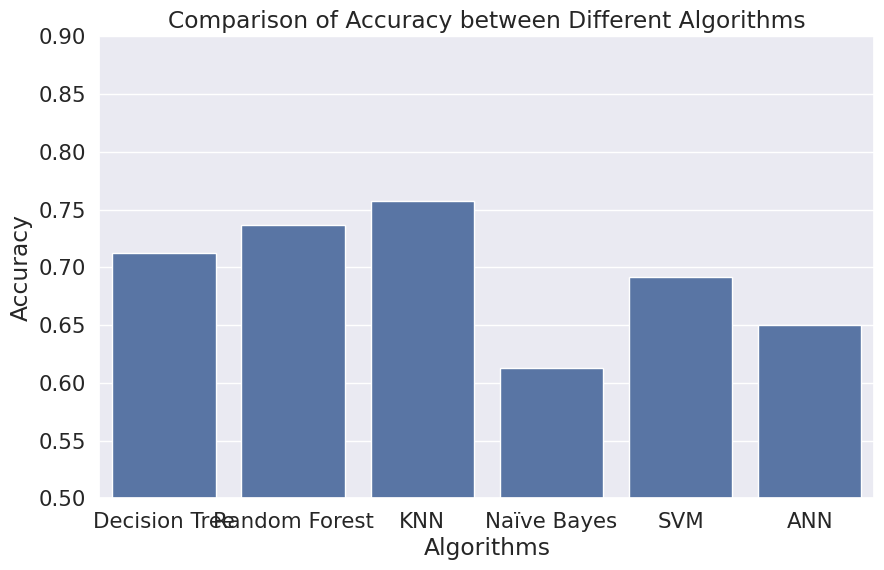

In [183]:

# Sample accuracy scores for each algorithm
accuracy_scores = {'Decision Tree': test_accuracy_Dt_noisy_max, 'Random Forest': test_accuracy_RF_noisy_max, 'KNN': test_accuracy_knn_noisy_max, 'Naïve Bayes': test_accuracy_nb_noisy_max, 'SVM': accuracy_noisy_max, 'ANN': accuracy_ANN_noisy_max}

# Create a bar plot
plt.figure(figsize=(10, 6))
sns.barplot(x=list(accuracy_scores.keys()), y=list(accuracy_scores.values()))
plt.xlabel('Algorithms')
plt.ylabel('Accuracy')
plt.title('Comparison of Accuracy between Different Algorithms')
plt.ylim(0.5, 0.9)  # Set the y-axis limits if needed
plt.show()

**ROC curve**

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


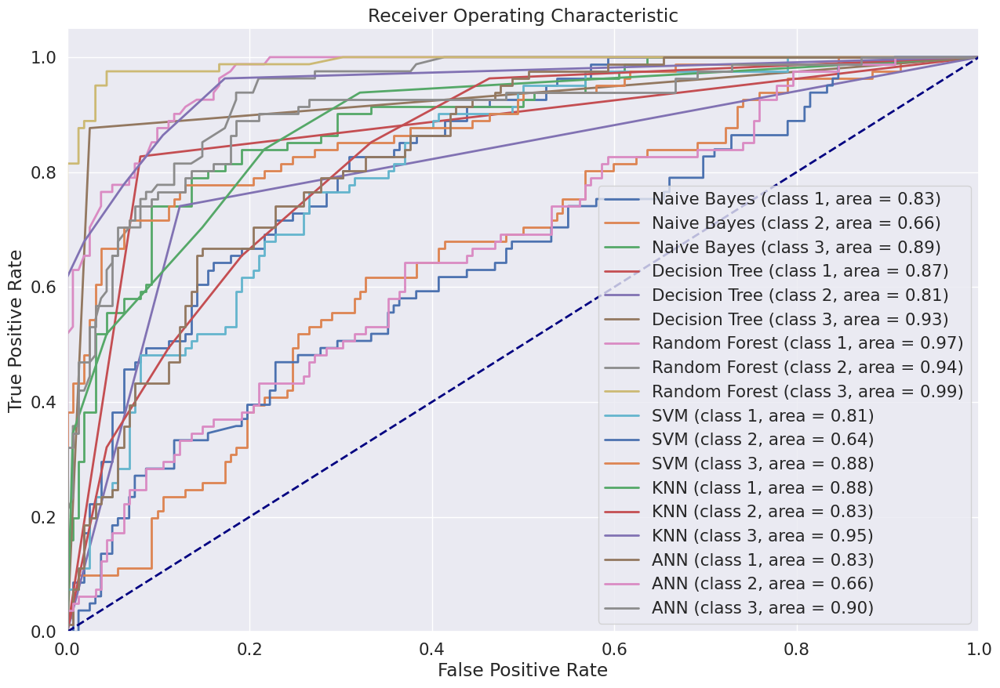

In [185]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
import matplotlib.pyplot as plt


# Binarize the output
classes = [1, 2, 3]  # Adjusted to reflect the actual mapped classes
y_train_max_bin = label_binarize(y_train_noisy_max, classes=classes)
y_test_max_bin = label_binarize(y_test_noisy_max, classes=classes)

# Initialize models
models = {
    'Naive Bayes': OneVsRestClassifier(GaussianNB()),
    'Decision Tree': OneVsRestClassifier(DecisionTreeClassifier()),
    'Random Forest': OneVsRestClassifier(RandomForestClassifier()),
    'SVM': OneVsRestClassifier(SVC(probability=True)),
    'KNN': OneVsRestClassifier(KNeighborsClassifier()),
    'ANN': OneVsRestClassifier(MLPClassifier())
}

plt.figure(figsize=(15, 10))

# Iterate through the models
for model_name, model in models.items():
    model.fit(X_train_noisy_max, y_train_max_bin)
    y_probs = model.predict_proba(X_test_noisy_max)

    # Compute ROC curve and ROC area for each class
    for i in range(len(classes)):
        if len(np.unique(y_test_max_bin[:, i])) > 1:  # Check if there is more than one class
            fpr, tpr, _ = roc_curve(y_test_max_bin[:, i], y_probs[:, i])
            roc_auc = roc_auc_score(y_test_max_bin[:, i], y_probs[:, i])
            plt.plot(fpr, tpr, lw=2, label=f'{model_name} (class {classes[i]}, area = {roc_auc:0.2f})')

plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc='lower right')
plt.show()


2_noisy data with undersampling

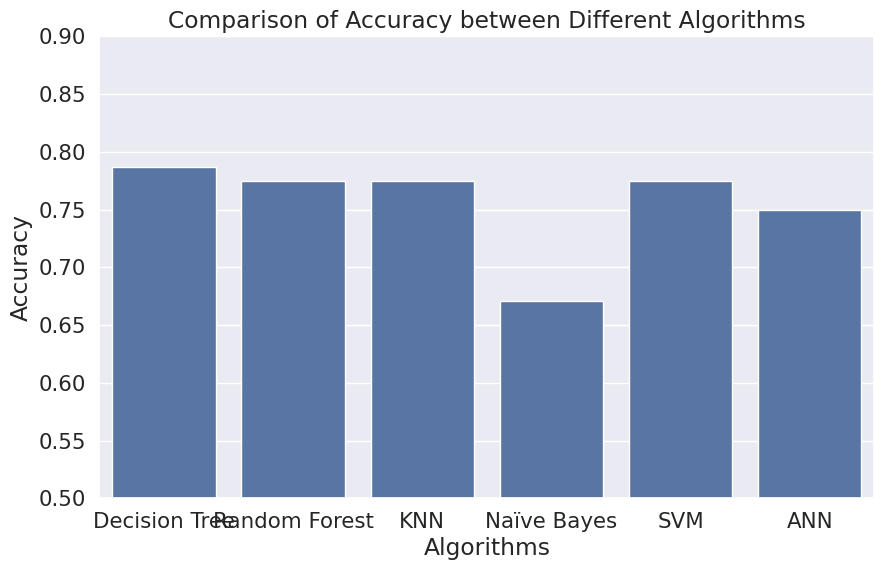

In [186]:
# Sample accuracy scores for each algorithm
accuracy_scores = {'Decision Tree': test_accuracy_Dt_noisy_min, 'Random Forest': test_accuracy_RF_noisy_min, 'KNN': test_accuracy_knn_noisy_min, 'Naïve Bayes': test_accuracy_nb_noisy_min, 'SVM': accuracy_noisy_min, 'ANN': accuracy_ANN_noisy_min}

# Create a bar plot
plt.figure(figsize=(10, 6))
sns.barplot(x=list(accuracy_scores.keys()), y=list(accuracy_scores.values()))
plt.xlabel('Algorithms')
plt.ylabel('Accuracy')
plt.title('Comparison of Accuracy between Different Algorithms')
plt.ylim(0.5, 0.9)  # Set the y-axis limits if needed
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


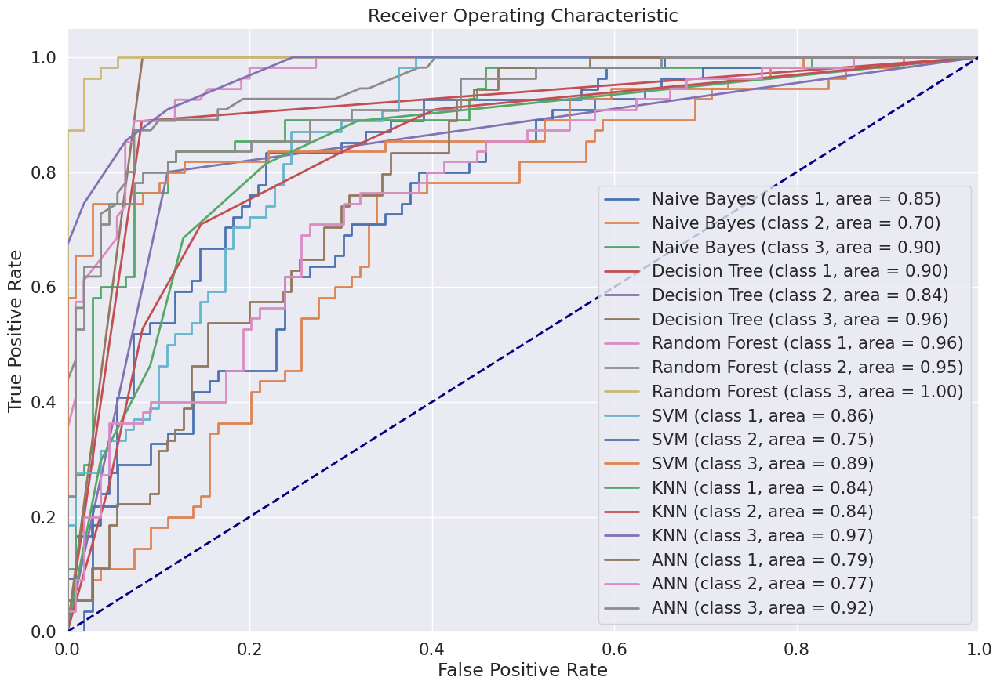

In [187]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
import matplotlib.pyplot as plt


# Binarize the output
classes = [1, 2, 3]  # Adjusted to reflect the actual mapped classes
y_train_max_bin = label_binarize(y_train_noisy_min, classes=classes)
y_test_max_bin = label_binarize(y_test_noisy_min, classes=classes)

# Initialize models
models = {
    'Naive Bayes': OneVsRestClassifier(GaussianNB()),
    'Decision Tree': OneVsRestClassifier(DecisionTreeClassifier()),
    'Random Forest': OneVsRestClassifier(RandomForestClassifier()),
    'SVM': OneVsRestClassifier(SVC(probability=True)),
    'KNN': OneVsRestClassifier(KNeighborsClassifier()),
    'ANN': OneVsRestClassifier(MLPClassifier())
}

plt.figure(figsize=(15, 10))

# Iterate through the models
for model_name, model in models.items():
    model.fit(X_train_noisy_min, y_train_max_bin)
    y_probs = model.predict_proba(X_test_noisy_min)

    # Compute ROC curve and ROC area for each class
    for i in range(len(classes)):
        if len(np.unique(y_test_max_bin[:, i])) > 1:  # Check if there is more than one class
            fpr, tpr, _ = roc_curve(y_test_max_bin[:, i], y_probs[:, i])
            roc_auc = roc_auc_score(y_test_max_bin[:, i], y_probs[:, i])
            plt.plot(fpr, tpr, lw=2, label=f'{model_name} (class {classes[i]}, area = {roc_auc:0.2f})')

plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc='lower right')
plt.show()


3. data whitout noise and with oversampling

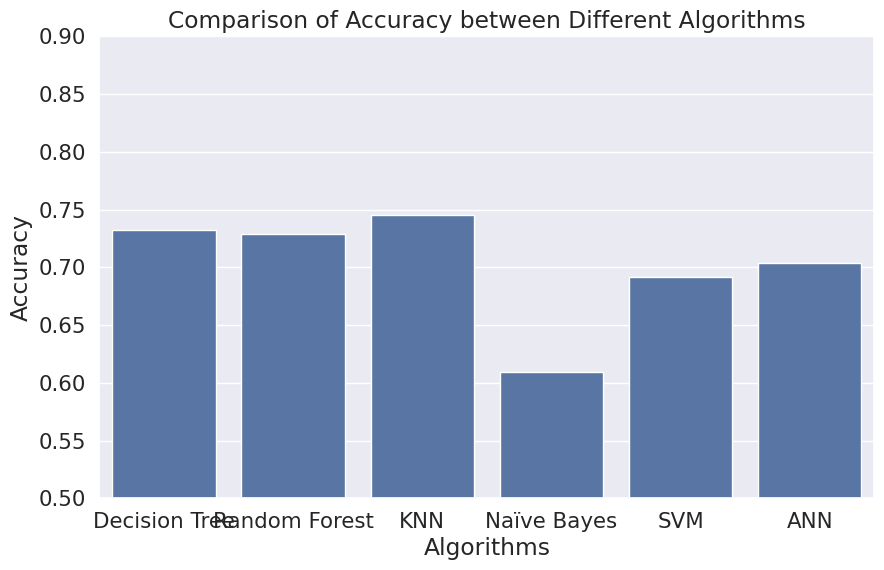

In [188]:

# Sample accuracy scores for each algorithm
accuracy_scores = {'Decision Tree': test_accuracy_Dt_max, 'Random Forest': test_accuracy_RF_max, 'KNN': test_accuracy_knn_max, 'Naïve Bayes': test_accuracy_nb_max, 'SVM': accuracy_max, 'ANN': accuracy_ANN_max}

# Create a bar plot
plt.figure(figsize=(10, 6))
sns.barplot(x=list(accuracy_scores.keys()), y=list(accuracy_scores.values()))
plt.xlabel('Algorithms')
plt.ylabel('Accuracy')
plt.title('Comparison of Accuracy between Different Algorithms')
plt.ylim(0.5, 0.9)  # Set the y-axis limits if needed
plt.show()

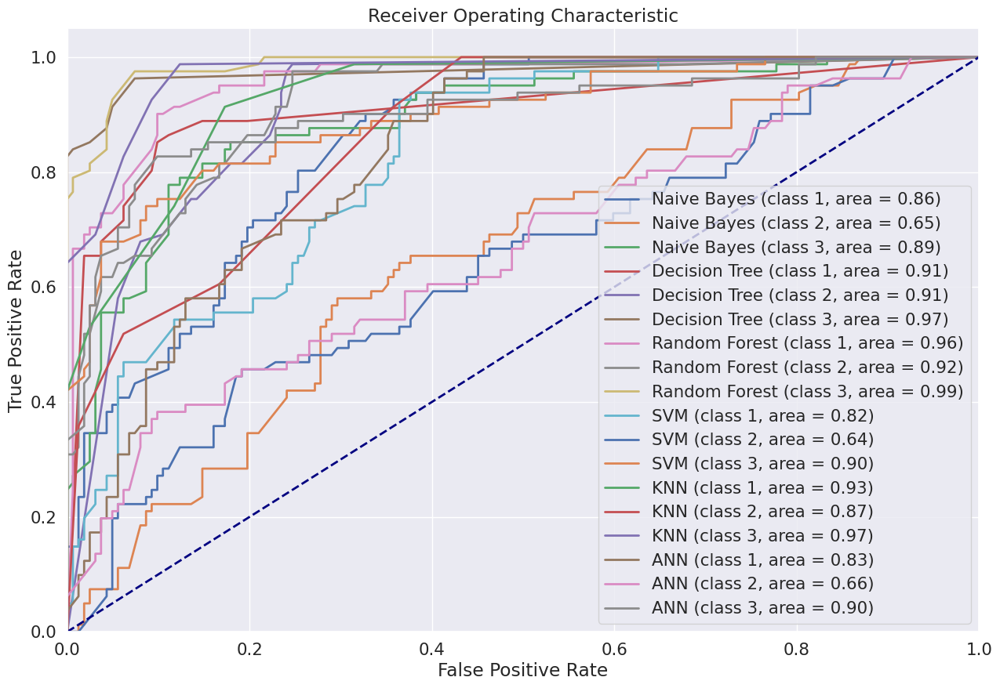

In [189]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
import matplotlib.pyplot as plt


# Binarize the output
classes = [1, 2, 3]  # Adjusted to reflect the actual mapped classes
y_train_max_bin = label_binarize(y_train_max, classes=classes)
y_test_max_bin = label_binarize(y_test_max, classes=classes)

# Initialize models
models = {
    'Naive Bayes': OneVsRestClassifier(GaussianNB()),
    'Decision Tree': OneVsRestClassifier(DecisionTreeClassifier()),
    'Random Forest': OneVsRestClassifier(RandomForestClassifier()),
    'SVM': OneVsRestClassifier(SVC(probability=True)),
    'KNN': OneVsRestClassifier(KNeighborsClassifier()),
    'ANN': OneVsRestClassifier(MLPClassifier())
}

plt.figure(figsize=(15, 10))

# Iterate through the models
for model_name, model in models.items():
    model.fit(X_train_max, y_train_max_bin)
    y_probs = model.predict_proba(X_test_max)

    # Compute ROC curve and ROC area for each class
    for i in range(len(classes)):
        if len(np.unique(y_test_max_bin[:, i])) > 1:  # Check if there is more than one class
            fpr, tpr, _ = roc_curve(y_test_max_bin[:, i], y_probs[:, i])
            roc_auc = roc_auc_score(y_test_max_bin[:, i], y_probs[:, i])
            plt.plot(fpr, tpr, lw=2, label=f'{model_name} (class {classes[i]}, area = {roc_auc:0.2f})')

plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc='lower right')
plt.show()


4.  data whitout noise and with oversampling

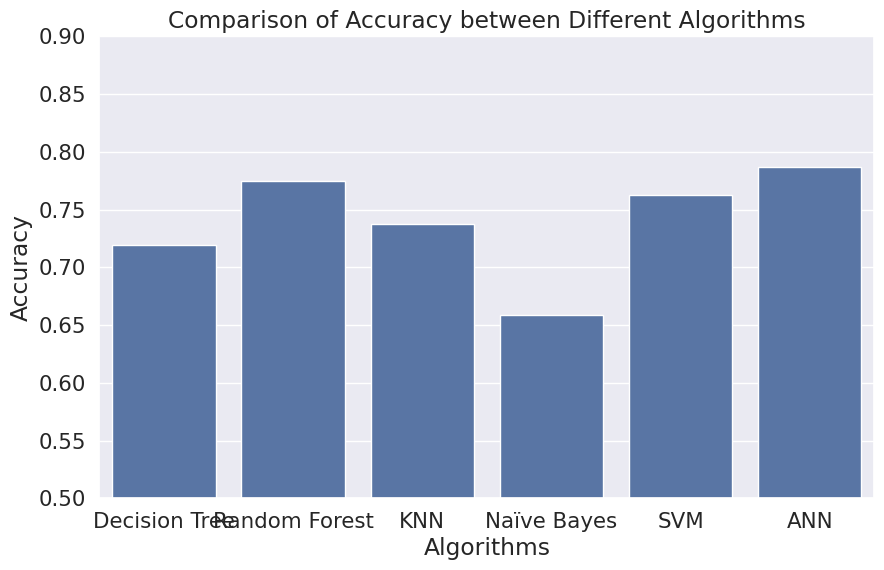

In [190]:

# Sample accuracy scores for each algorithm
accuracy_scores = {'Decision Tree': test_accuracy_Dt_min, 'Random Forest': test_accuracy_RF_min, 'KNN': test_accuracy_knn_min, 'Naïve Bayes': test_accuracy_nb_min, 'SVM': accuracy_min, 'ANN': accuracy_ANN_min}

# Create a bar plot
plt.figure(figsize=(10, 6))
sns.barplot(x=list(accuracy_scores.keys()), y=list(accuracy_scores.values()))
plt.xlabel('Algorithms')
plt.ylabel('Accuracy')
plt.title('Comparison of Accuracy between Different Algorithms')
plt.ylim(0.5, 0.9)  # Set the y-axis limits if needed
plt.show()

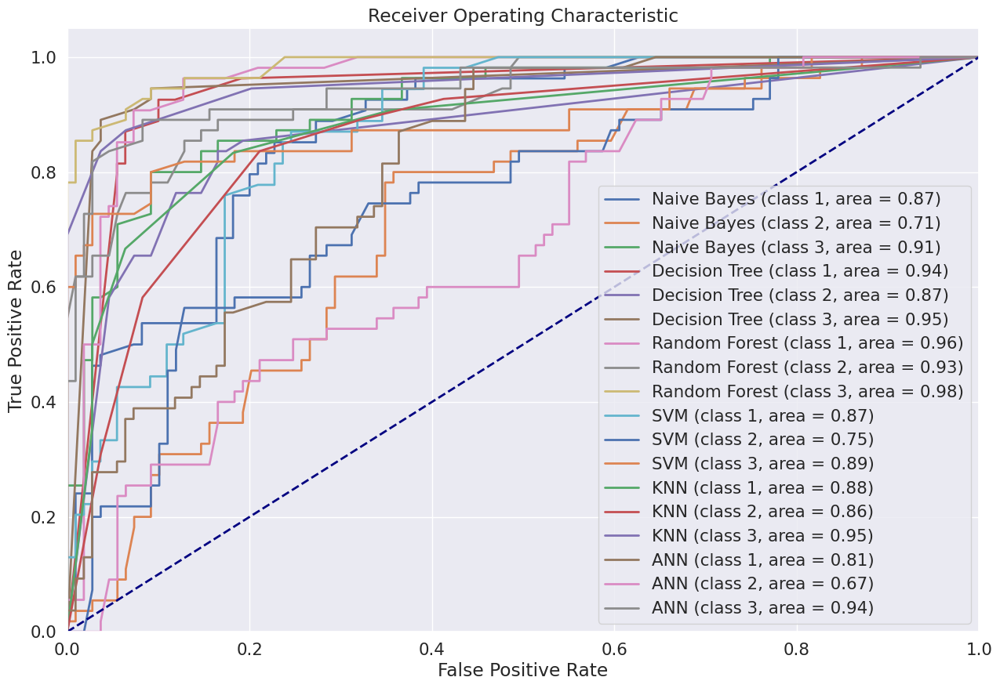

In [191]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
import matplotlib.pyplot as plt


# Binarize the output
classes = [1, 2, 3]  # Adjusted to reflect the actual mapped classes
y_train_max_bin = label_binarize(y_train_min, classes=classes)
y_test_max_bin = label_binarize(y_test_min, classes=classes)

# Initialize models
models = {
    'Naive Bayes': OneVsRestClassifier(GaussianNB()),
    'Decision Tree': OneVsRestClassifier(DecisionTreeClassifier()),
    'Random Forest': OneVsRestClassifier(RandomForestClassifier()),
    'SVM': OneVsRestClassifier(SVC(probability=True)),
    'KNN': OneVsRestClassifier(KNeighborsClassifier()),
    'ANN': OneVsRestClassifier(MLPClassifier())
}

plt.figure(figsize=(15, 10))

# Iterate through the models
for model_name, model in models.items():
    model.fit(X_train_min, y_train_max_bin)
    y_probs = model.predict_proba(X_test_min)

    # Compute ROC curve and ROC area for each class
    for i in range(len(classes)):
        if len(np.unique(y_test_max_bin[:, i])) > 1:  # Check if there is more than one class
            fpr, tpr, _ = roc_curve(y_test_max_bin[:, i], y_probs[:, i])
            roc_auc = roc_auc_score(y_test_max_bin[:, i], y_probs[:, i])
            plt.plot(fpr, tpr, lw=2, label=f'{model_name} (class {classes[i]}, area = {roc_auc:0.2f})')

plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc='lower right')
plt.show()


data without duplicates

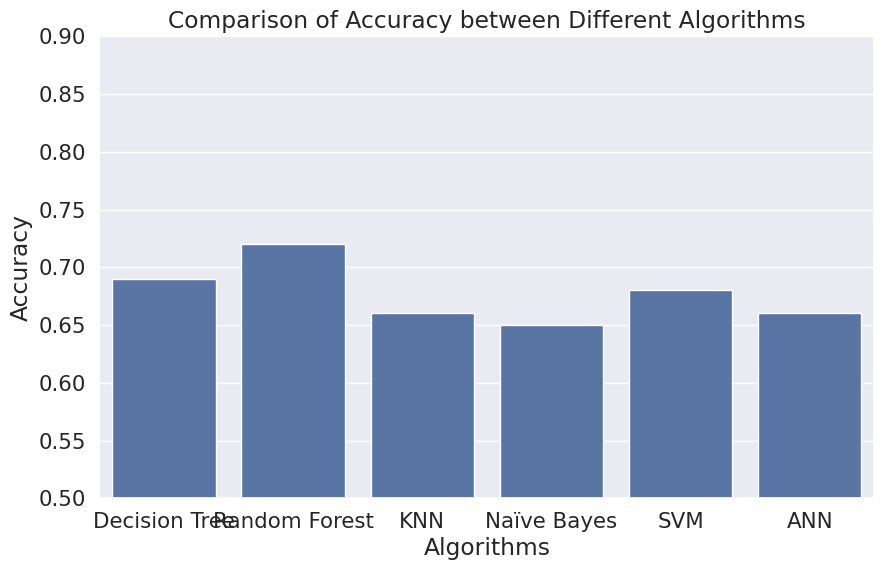

In [192]:

# Sample accuracy scores for each algorithm
accuracy_scores = {'Decision Tree':0.69 , 'Random Forest': 0.72, 'KNN': 0.66, 'Naïve Bayes': 0.65, 'SVM': 0.68, 'ANN': 0.66}

# Create a bar plot
plt.figure(figsize=(10, 6))
sns.barplot(x=list(accuracy_scores.keys()), y=list(accuracy_scores.values()))
plt.xlabel('Algorithms')
plt.ylabel('Accuracy')
plt.title('Comparison of Accuracy between Different Algorithms')
plt.ylim(0.5, 0.9)  # Set the y-axis limits if needed
plt.show()

data without duplicates undersampling

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


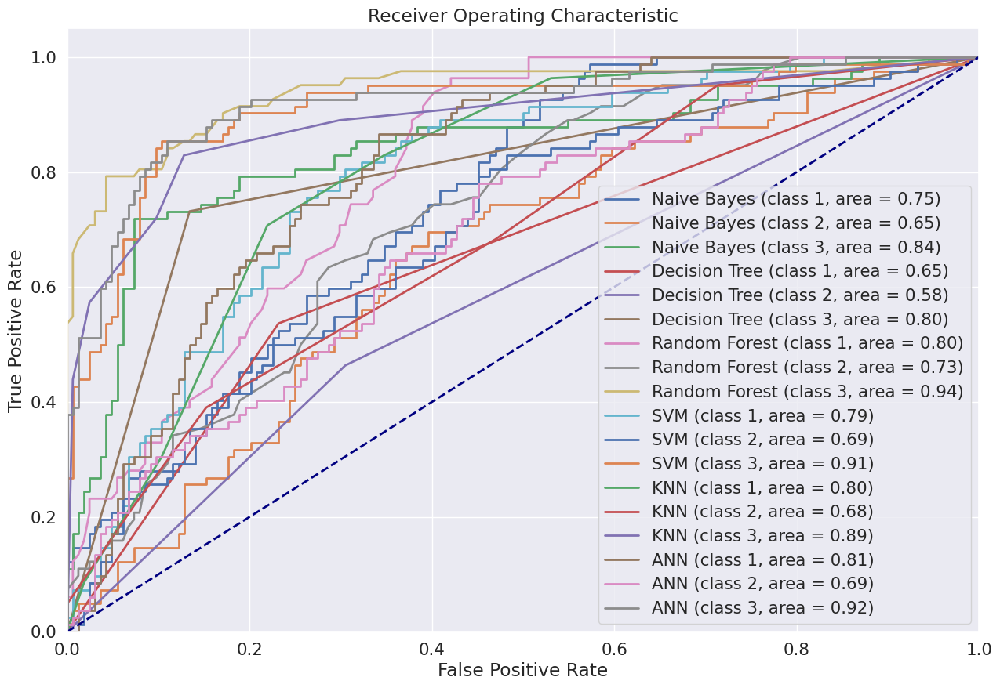

In [193]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
import matplotlib.pyplot as plt


# Binarize the output
classes = [1, 2, 3]  # Adjusted to reflect the actual mapped classes
y_train_max_bin = label_binarize(y_res, classes=classes)
y_test_max_bin = label_binarize(y_res_test, classes=classes)

# Initialize models
models = {
    'Naive Bayes': OneVsRestClassifier(GaussianNB()),
    'Decision Tree': OneVsRestClassifier(DecisionTreeClassifier()),
    'Random Forest': OneVsRestClassifier(RandomForestClassifier()),
    'SVM': OneVsRestClassifier(SVC(probability=True)),
    'KNN': OneVsRestClassifier(KNeighborsClassifier()),
    'ANN': OneVsRestClassifier(MLPClassifier())
}

plt.figure(figsize=(15, 10))

# Iterate through the models
for model_name, model in models.items():
    model.fit(X_res, y_train_max_bin)
    y_probs = model.predict_proba(X_res_test)

    # Compute ROC curve and ROC area for each class
    for i in range(len(classes)):
        if len(np.unique(y_test_max_bin[:, i])) > 1:  # Check if there is more than one class
            fpr, tpr, _ = roc_curve(y_test_max_bin[:, i], y_probs[:, i])
            roc_auc = roc_auc_score(y_test_max_bin[:, i], y_probs[:, i])
            plt.plot(fpr, tpr, lw=2, label=f'{model_name} (class {classes[i]}, area = {roc_auc:0.2f})')

plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc='lower right')
plt.show()


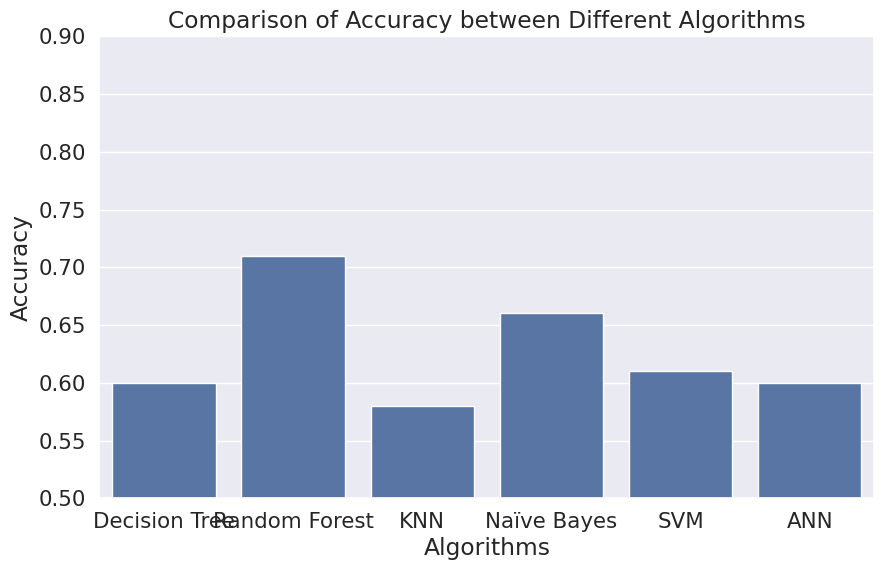

In [194]:

# Sample accuracy scores for each algorithm
accuracy_scores = {'Decision Tree': 0.60, 'Random Forest': 0.71, 'KNN': 0.58, 'Naïve Bayes': 0.66, 'SVM': 0.61, 'ANN': 0.60}

# Create a bar plot
plt.figure(figsize=(10, 6))
sns.barplot(x=list(accuracy_scores.keys()), y=list(accuracy_scores.values()))
plt.xlabel('Algorithms')
plt.ylabel('Accuracy')
plt.title('Comparison of Accuracy between Different Algorithms')
plt.ylim(0.5, 0.9)  # Set the y-axis limits if needed
plt.show()

data without duplicates upsampling

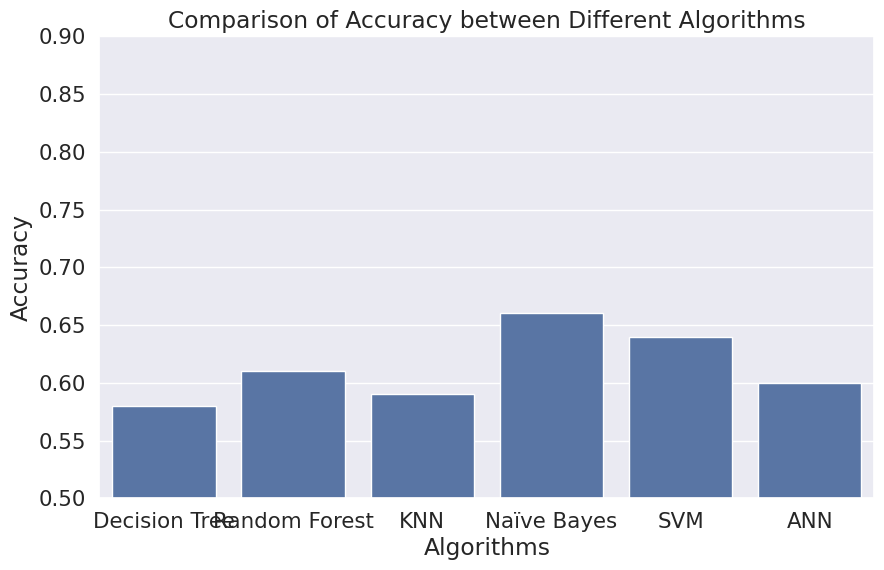

In [195]:

# Sample accuracy scores for each algorithm
accuracy_scores = {'Decision Tree': 0.58, 'Random Forest': 0.61, 'KNN': 0.59, 'Naïve Bayes': 0.66, 'SVM': 0.64, 'ANN': 0.60}

# Create a bar plot
plt.figure(figsize=(10, 6))
sns.barplot(x=list(accuracy_scores.keys()), y=list(accuracy_scores.values()))
plt.xlabel('Algorithms')
plt.ylabel('Accuracy')
plt.title('Comparison of Accuracy between Different Algorithms')
plt.ylim(0.5, 0.9)  # Set the y-axis limits if needed
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


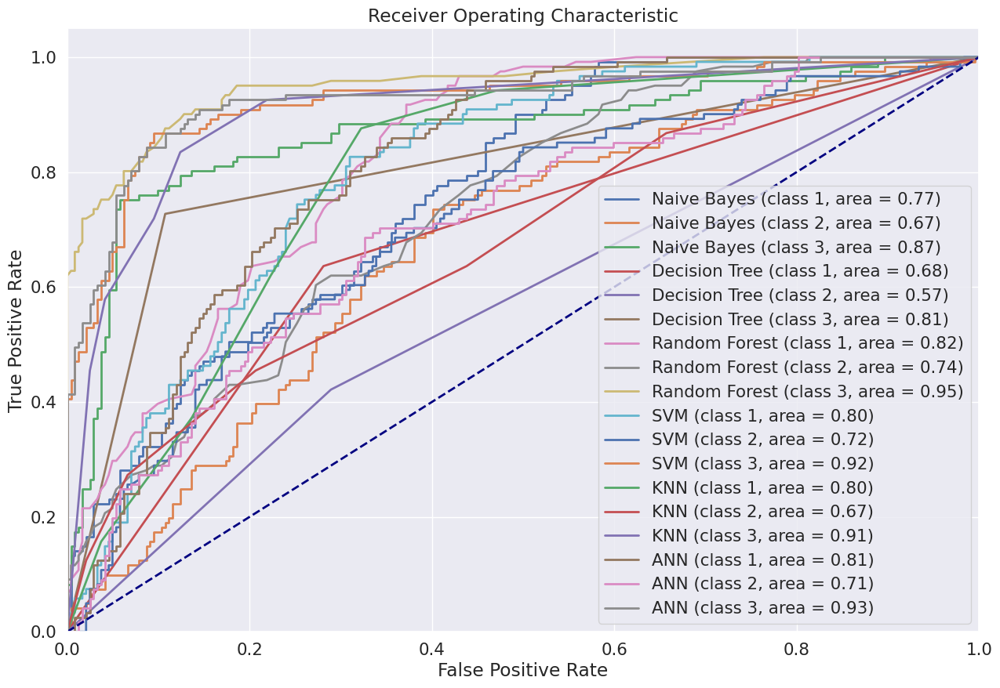

In [196]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
import matplotlib.pyplot as plt


# Binarize the output
classes = [1, 2, 3]  # Adjusted to reflect the actual mapped classes
y_train_max_bin = label_binarize(y_train_over, classes=classes)
y_test_max_bin = label_binarize(y_over_test, classes=classes)

# Initialize models
models = {
    'Naive Bayes': OneVsRestClassifier(GaussianNB()),
    'Decision Tree': OneVsRestClassifier(DecisionTreeClassifier()),
    'Random Forest': OneVsRestClassifier(RandomForestClassifier()),
    'SVM': OneVsRestClassifier(SVC(probability=True)),
    'KNN': OneVsRestClassifier(KNeighborsClassifier()),
    'ANN': OneVsRestClassifier(MLPClassifier())
}

plt.figure(figsize=(15, 10))

# Iterate through the models
for model_name, model in models.items():
    model.fit(X_train_over, y_train_max_bin)
    y_probs = model.predict_proba(X_over_test)

    # Compute ROC curve and ROC area for each class
    for i in range(len(classes)):
        if len(np.unique(y_test_max_bin[:, i])) > 1:  # Check if there is more than one class
            fpr, tpr, _ = roc_curve(y_test_max_bin[:, i], y_probs[:, i])
            roc_auc = roc_auc_score(y_test_max_bin[:, i], y_probs[:, i])
            plt.plot(fpr, tpr, lw=2, label=f'{model_name} (class {classes[i]}, area = {roc_auc:0.2f})')

plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc='lower right')
plt.show()
